# MultiOmics RNA + ATAC for Chao dataset emphasis on OL population (MORNAATACCOL) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACCOL 3 notebook**

<hr>

In [ ]:
#Memory needed for a full run : 256Gb

In [ ]:
#Early1               = P21208_1003_EAE_ARC
#PeakCtrl2            = P21208_1004_EAE_ARC
#Peak2                = P21208_1005_EAE_ARC
#LateCtrl1            = MORNAATACC_1002 (P21520_1002)
#Late1                = MORNAATACC_1003 (P21520_1003)
#Early2               = P23605_1001
#EarlyCtrl2           = P23605_1002
#Peak3                = P23605_1003
#PeakCtrl3            = P23605_1004
#EarlyCtrl3           = P24115_1001
#EarlyFemale3         = P24115_1002
#EarlyMale3           = P24115_1003
#Late2                = P25316_1001
#LateCtrl2            = P25316_1002
#Late3                = P25316_1003
#LateCtrl3            = P25316_1004
#PeakMale4            = P27208_1001
#PeakFemale4          = P27208_1002
#LateMale4            = P27208_1003
#LateFemale4          = P27208_1004
#Naive1               = P26203_1003
#Naive2               = P26203_1004
#Peak5                = P29557_1001
#Late5                = P29557_1002
#Naive3               = P29557_1004
#EarlyCtrl4           = P29557_1005
#EarlyCtrlMale5       = P29557_1006
#EarlyCtrlFemale5     = P29557_1007
#Early4               = P29557_1008
#EarlyMale5           = P29557_1009
#EarlyFemale5         = P29557_1010

## 0. Environment status

In [5]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [3]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [4]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              20
On-line CPU(s) list: 0-19
Thread(s) per core:  1
Core(s) per socket:  10
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               79
Model name:          Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz
Stepping:            1
CPU MHz:             2735.498
CPU max MHz:         3100.0000
CPU min MHz:         1200.0000
BogoMIPS:            4390.12
Virtualization:      VT-x
L1d cache:           640 KiB
L1i cache:           640 KiB
L2 cache:            5 MiB
L3 cache:            50 MiB
NUMA node0 CPU(s):   0-9
NUMA node1 CPU(s):   10-19
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_t

In [5]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

128374


In [ ]:
apt list --installed

In [ ]:
pip list

In [9]:
jupyter --version

Selected Jupyter core packages...
IPython          : 7.30.1
ipykernel        : 6.6.0
ipywidgets       : 7.6.5
jupyter_client   : 7.1.0
jupyter_core     : 4.9.1
jupyter_server   : 1.13.1
jupyterlab       : 3.1.17
nbclient         : 0.5.9
nbconvert        : 6.2.0
nbformat         : 5.1.3
notebook         : 6.4.6
qtconsole        : 5.2.2
traitlets        : 5.1.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(ggplot2)
library(caret)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(scales)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

library(textclean)
library(mclust)

library(muscat)
library(SingleCellExperiment)
library(magrittr)
library(plyr)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect


Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading require

In [2]:
sessionInfo()

R version 4.3.2 (2023-10-31)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 22.04 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.10.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.10.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Etc/UTC
tzcode source: system (glibc)

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] EnhancedVolcano_1.20.0             DESeq2_1.42.1                     
 [3] Matrix.utils_0.9.8                 Matrix_1.6-5                      
 [5] limma_3.58.1                       UpSetR_1.4.0                      
 [7] scater_1.30.1                      scuttle_1.12.0        

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, layer = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = layer == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = LayerData(object = object, assay = assay, layer = layer))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", layer,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", layer, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = LayerData(object = object, assay = assay, layer = layer)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#BCC8BC
#A5B6A5
#8FA38F
#789178
#657B65
#536553
#404F40
#2E382E

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [6]:
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4", "Late5")

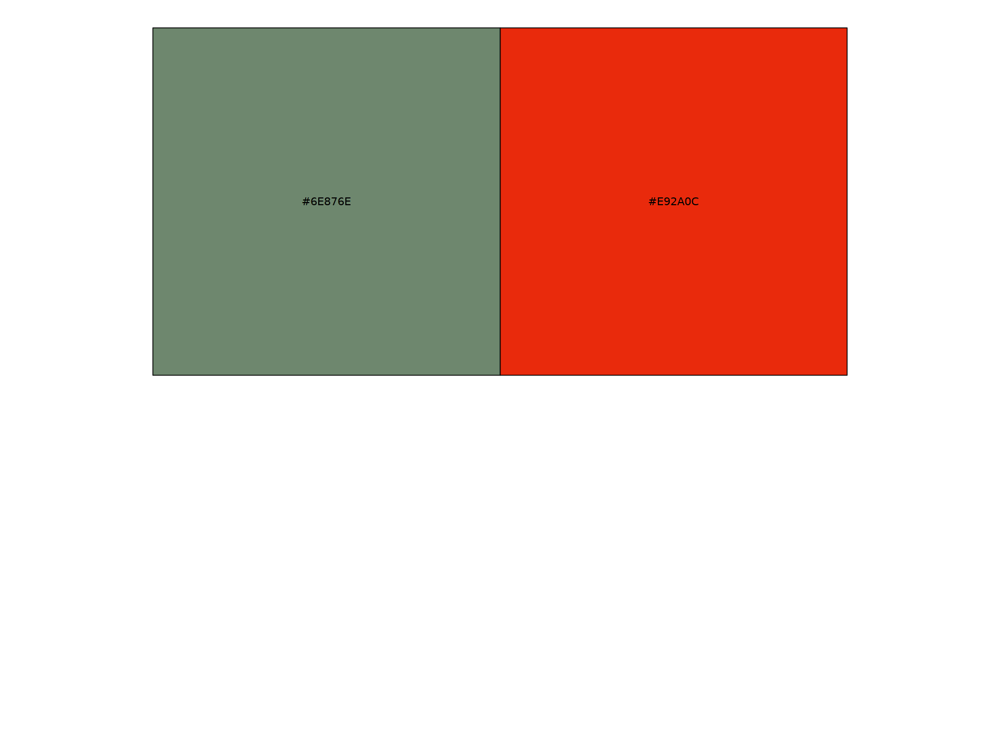

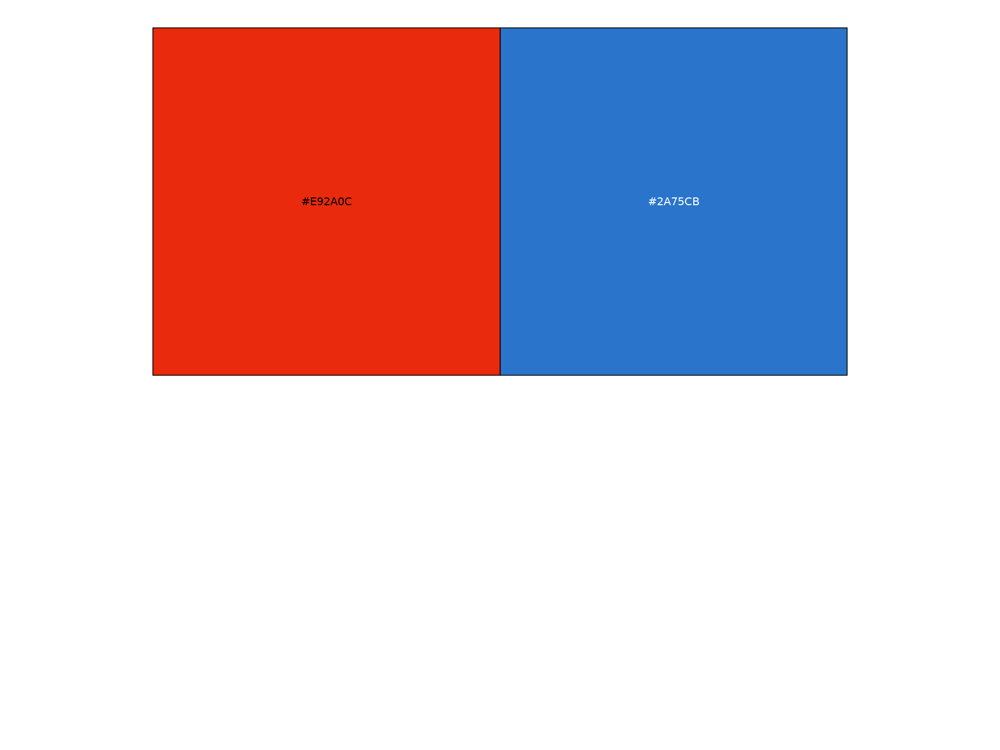

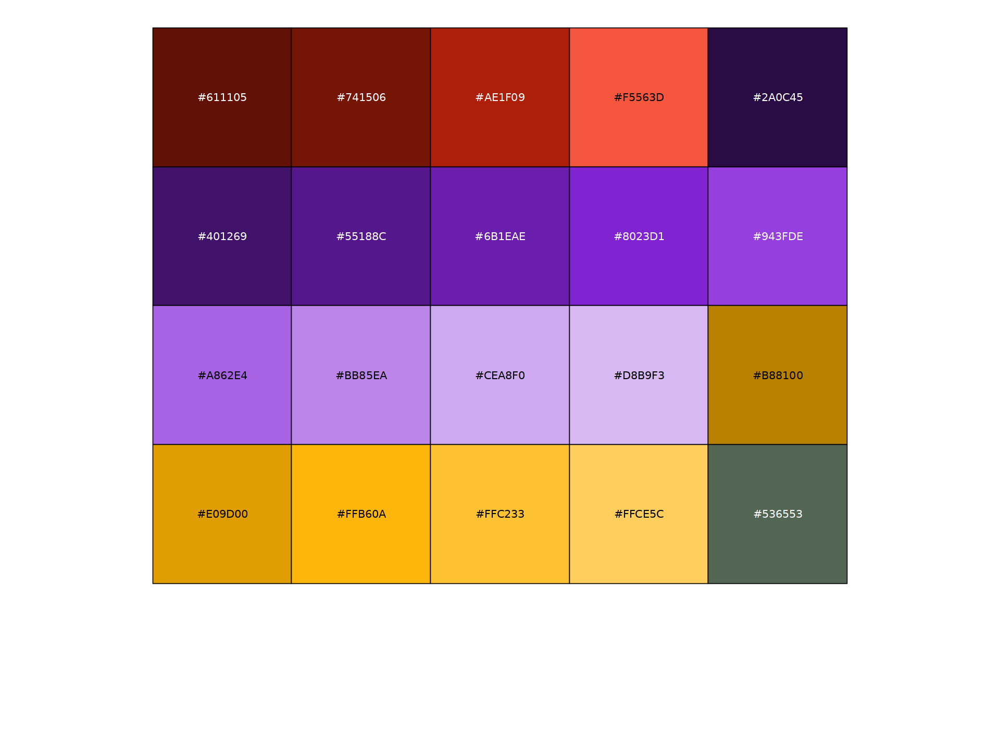

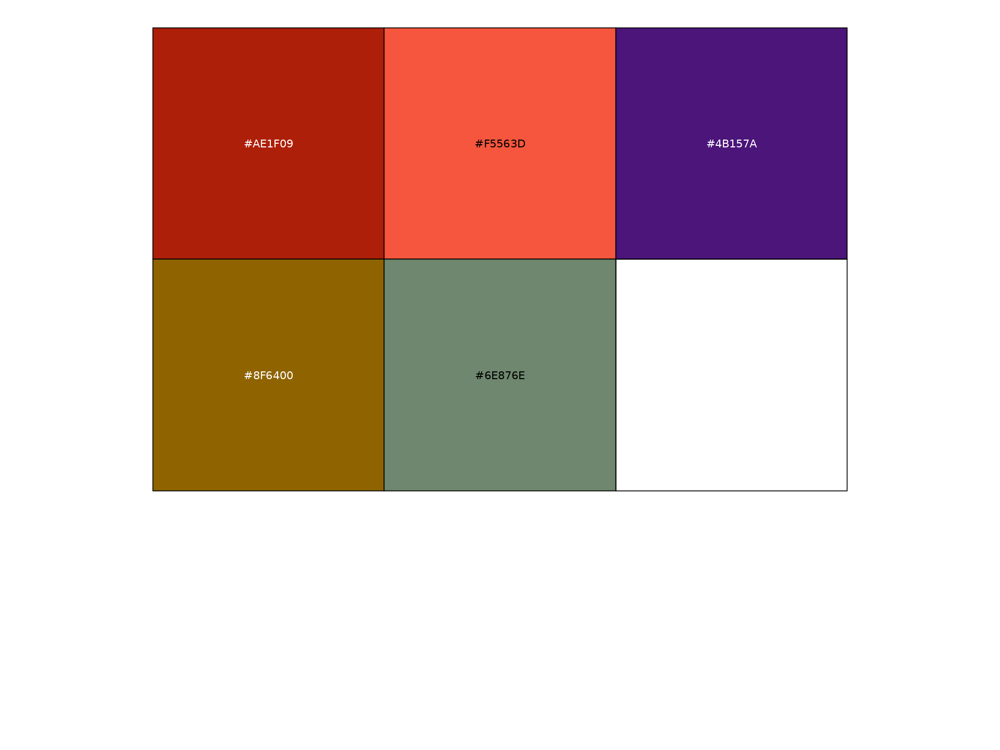

In [7]:
orig.ident_colors <- c("#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#D2DAD2", "#E9EDE9", 
                       "#7A5600", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6",
                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8",
                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
names(orig.ident_colors) <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")

orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#5B1865", "#E54F6D",
                                "#97615E", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
names(orig.ident_colors_contrast) <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")

orig.ident_merge_colors <- c("#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Ctrl", "Early", "Peak", "Late")

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00", "#E54F6D")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6", "B8")

model_colors <- c("#6E876E", "#E92A0C")
names(model_colors) <- c("Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#E92A0C", "#2A75CB")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("F", "M")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

immuneAll_colors <- c("lightgrey", "blue", "orange", "red")
names(immuneAll_colors) <- c("None", "RNA", "GenePromAcc", "Both")
#show_col(immuneAll_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

debris_colors <- duo_colors
names(debris_colors) <- c("Percoll", "Debris")

date_tissue_coll_colors <- scales::viridis_pal()(17)
names(date_tissue_coll_colors) <- c('2021_04_30','2021_05_03','2021_05_31','2021_09_30','2021_10_06','2021_11_26','2022_03_09','2022_03_10','2022_08_03','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2022_05_12','2022_05_16')
#show_col(date_tissue_coll_colors)

date_exp_colors <- scales::viridis_pal()(7)
names(date_exp_colors) <- c('2021_04_20','2021_09_22','2021_11_17','2022_01_31','2022_07_18','2023_01_09','2023_06_05')
#show_col(date_exp_colors)

EAE_score_mean_colors <- scales::viridis_pal()(7)
names(EAE_score_mean_colors) <- c(0,0.5,2,2.25,2.33,2.5,3)
#show_col(EAE_score_mean_colors)

cellType_OL_colors <- c("#611105", "#741506", "#AE1F09", "#F5563D", "#2A0C45","#401269","#55188C","#6B1EAE","#8023D1","#943FDE","#A862E4","#BB85EA","#CEA8F0","#D8B9F3","#B88100","#E09D00","#FFB60A","#FFC233","#FFCE5C","#536553")
names(cellType_OL_colors) <- c("OPC-α", "OPC-β", "OPC-γ", "COP", "MOL56-α","MOL56-β","MOL56-γ","MOL56-δ","MOL56-ε","MOL56-ζ","MOL56-η","MOL56-θ","MOL56-ι","MOL56-κ","MOL2-α","MOL2-β","MOL2-γ","MOL2-δ","MOL2-ε","MOL1")
show_col(cellType_OL_colors)

cellType_OL_merge_colors <- c("#AE1F09","#F5563D","#4B157A","#8F6400", "#6E876E")
names(cellType_OL_merge_colors) <- c("OPC", "COP", "MOL56", "MOL2", "MOL1")
show_col(cellType_OL_merge_colors)

In [8]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [18]:
MORNAATACCOL <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL.rds"))

## 3. RNA expression analysis

https://hbctraining.github.io/DGE_workshop/lessons/04_DGE_DESeq2_analysis.html#:~:text=The%20DESeq2%20dispersion%20estimates%20are,only%20based%20on%20their%20variance

https://support.bioconductor.org/p/9143599/

### 3.1 Differential Genes Expression at cellType level (DGE)

In [19]:
MORNAATACCOL_sce <- as.SingleCellExperiment(MORNAATACCOL, assay="RNA")

In [20]:
MORNAATACCOL_sce

class: SingleCellExperiment 
dim: 32285 120183 
metadata(0):
assays(3): counts logcounts scaledata
rownames(32285): 0610005C13Rik 0610006L08Rik ... mt-Nd5 mt-Nd6
rowData names(0):
colnames(120183): AAACAGCCAAATATCC-14 AAACAGCCAAATTGCT-16 ...
  TTTGTTGGTTTGAGCA-28 TTTGTTGGTTTGGTTC-28
colData names(216): orig.ident nCount_RAW ... cellType_OL_merge ident
reducedDimNames(10): PCA UMAP_RNA ... UMAP_PEAKS_OL UMAP_BIMOD_OL
mainExpName: RNA
altExpNames(0):

In [21]:
MORNAATACCOL_sce <- prepSCE(MORNAATACCOL_sce, kid = "cellType_OL_merge", gid = "orig.ident_merge", sid = "orig.ident", drop = FALSE)

In [22]:
kids <- purrr::set_names(levels(MORNAATACCOL_sce$cluster_id))

# Total number of clusters
nk <- length(kids)

# Named vector of sample names
sids <- purrr::set_names(levels(MORNAATACCOL_sce$sample_id))

# Total number of samples 
ns <- length(sids)

In [23]:
kids
sids

OPC     COP   MOL56    MOL2    MOL1 
  "OPC"   "COP" "MOL56"  "MOL2"  "MOL1"

EarlyCtrl2         EarlyCtrl3         EarlyCtrl4     EarlyCtrlMale5 
      "EarlyCtrl2"       "EarlyCtrl3"       "EarlyCtrl4"   "EarlyCtrlMale5" 
  EarlyCtrlFemale5          PeakCtrl2          PeakCtrl3          LateCtrl2 
"EarlyCtrlFemale5"        "PeakCtrl2"        "PeakCtrl3"        "LateCtrl2" 
         LateCtrl3             Early1       EarlyFemale3         EarlyMale3 
       "LateCtrl3"           "Early1"     "EarlyFemale3"       "EarlyMale3" 
            Early4         EarlyMale5       EarlyFemale5              Peak2 
          "Early4"       "EarlyMale5"     "EarlyFemale5"            "Peak2" 
             Peak3          PeakMale4        PeakFemale4              Peak5 
           "Peak3"        "PeakMale4"      "PeakFemale4"            "Peak5" 
             Late1              Late2              Late3          LateMale4 
           "Late1"            "Late2"            "Late3"        "LateMale4" 
       LateFemale4              Late5 
     "LateFemale4"            "Late5"

In [24]:
## Determine the number of cells per sample
table(MORNAATACCOL_sce$sample_id)

## Turn named vector into a numeric vector of number of cells per sample
n_cells <- as.numeric(table(MORNAATACCOL_sce$sample_id))

## Determine how to reoder the samples (rows) of the metadata to match the order of sample names in sids vector
m <- match(sids, MORNAATACCOL_sce$sample_id)

## Create the sample level metadata by combining the reordered metadata with the number of cells corresponding to each sample.
ei <- data.frame(colData(MORNAATACCOL_sce)[m, ], n_cells, row.names = NULL) %>% select(-"cluster_id")
ei


      EarlyCtrl2       EarlyCtrl3       EarlyCtrl4   EarlyCtrlMale5 
             338             3109             6655             7965 
EarlyCtrlFemale5        PeakCtrl2        PeakCtrl3        LateCtrl2 
            7904             2703             1812             7390 
       LateCtrl3           Early1     EarlyFemale3       EarlyMale3 
            5417             3609             3168             3398 
          Early4       EarlyMale5     EarlyFemale5            Peak2 
            1243            10205             9314             1473 
           Peak3        PeakMale4      PeakFemale4            Peak5 
            3083             3261             3730             3701 
           Late1            Late2            Late3        LateMale4 
            4445             1467             3928             4855 
     LateFemale4            Late5 
            9849             6161 

sample_id,group_id,nCount_RAW,nFeature_RAW,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,batch,model,debrisRemoval,date_tissue_collection,date_experiment,nbMouse,EAE_score_mean,frequency_count,mononucleosomal,nucleosome_free,reads_count,percent.mt,log10GenesUMI,mitoRatio,S.Score,G2M.Score,Phase,CC.Difference,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,nCount_peaks,nFeature_peaks,FRiP,nCount_GenePromAcc,nFeature_GenePromAcc,pANN,DF.classifications,pct_chrY,pct_chrX,Xist_score,Sex_predictions,Sex_predictions_F,Sex_predictions_M,Sex,snn_RNA_res.1,seurat_clusters_RNA,snn_peaks_res.0.4,seurat_clusters_peaks,RNA.weight,peaks.weight,⋯,zscore_NaiveGenePromAcc.reg_cyto_prod,pvalue_NaiveGenePromAcc.reg_cyto_prod,ImmuneGenePromAcc.reg_cyto_prod,ImmuneScoreGenePromAcc.Tcell_cd4,ImmuneScoreScaledGenePromAcc.Tcell_cd4,zscore_NaiveGenePromAcc.Tcell_cd4,pvalue_NaiveGenePromAcc.Tcell_cd4,ImmuneGenePromAcc.Tcell_cd4,ImmuneScoreGenePromAcc.Tcell_cd8,ImmuneScoreScaledGenePromAcc.Tcell_cd8,zscore_NaiveGenePromAcc.Tcell_cd8,pvalue_NaiveGenePromAcc.Tcell_cd8,ImmuneGenePromAcc.Tcell_cd8,ImmuneAll,snn_RNA_OL_res.2.2,seurat_clusters_RNA_OL,snn_peaks_OL_res.0.8,seurat_clusters_peaks_OL,RNA_OL.weight,peaks_OL.weight,wsnn_OL_res.3.6,seurat_clusters_BiMod_OL,cellTypeOLFalcao2018,cellTypeOLFalcao2018_prediction.score.COP,cellTypeOLFalcao2018_prediction.score.OPC1,cellTypeOLFalcao2018_prediction.score.MOL5_6_Cntrl_A,cellTypeOLFalcao2018_prediction.score.MOL5_6_Cntrl_B,cellTypeOLFalcao2018_prediction.score.OPC2,cellTypeOLFalcao2018_prediction.score.OPC_Cycling,cellTypeOLFalcao2018_prediction.score.MOL5_6_EAE_B,cellTypeOLFalcao2018_prediction.score.NFOL,cellTypeOLFalcao2018_prediction.score.MOL2_Cntrl_A,cellTypeOLFalcao2018_prediction.score.MOL3_EAE,cellTypeOLFalcao2018_prediction.score.MOL5_6_EAE_A,cellTypeOLFalcao2018_prediction.score.OPC3,cellTypeOLFalcao2018_prediction.score.MOL5_6_EAE_C,cellTypeOLFalcao2018_prediction.score.MOL1_2_EAE,cellTypeOL_mergeFalcao2018,cellTypeOL_mergeFalcao2018_prediction.score.COP,cellTypeOL_mergeFalcao2018_prediction.score.OPC,cellTypeOL_mergeFalcao2018_prediction.score.MOL5_6,cellTypeOL_mergeFalcao2018_prediction.score.OPC_Cycling,cellTypeOL_mergeFalcao2018_prediction.score.NFOL,cellTypeOL_mergeFalcao2018_prediction.score.MOL2,cellTypeOL_mergeFalcao2018_prediction.score.MOL3,cellTypeOL_mergeFalcao2018_prediction.score.MOL1_2,seurat_clusters_BiMod_OL_aggr,cellType_OL,ident,n_cells
<fct>,<fct>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<int>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<fct>,<fct>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<dbl>
EarlyCtrl2,Ctrl,2824,1526,2823,1526,7136,3360,B3,Ctrl,Percoll,2021_09_30,2021_09_22,2,0,5050,1599,2793,19296,2.798441,0.9225793,0.02798441,-0.041399417,-0.0768564026,G1,0.035456986,0.6206483,0.38,7.873026,0.75,3851,3291,0.7625743,4386,3083,0.00000000,Singlet,0.0003542331,0.05348920,-1.075,M,0.0004,0.9996,M,2,2,7,7,2.183693e-01,0.7816307,⋯,-1.2925110,0.90190987,NonImmune,-0.012424600,0.3062385,-0.21218539,0.58401880,NonImmune,0.112898601,0.5195749,1.8409386,0.03281528,Immune,None,4,4,10,10,3.224484e-03,0.9967755,14,14,MOL5_6_Cntrl_A,0.0000000000,0.0000000,0.909744325,0.055530913,0.0000000,0.00000000,0.000000000,0.0000000,0.00000000,0.03472476,0.000000000,0.00000000,0.000000000,0.00000000,MOL5_6,0.0000000000,0.00000000,0.9652752,0.00000000,0.0000000,0.00000000,0.03472476,0.00000000,7,MOL56-ζ,14,338
EarlyCtrl3,Ctrl,2460,1337,2456,1337,2535,1295,B4,Ctrl,Percoll,2021_11_26,2021_11_17,2,0,1831,590,1002,9182,3.949511,0.9221005,0.03949511

In [25]:
## Remove lowly accessible features which have less than 10 cells with any counts
MORNAATACCOL_sce <- MORNAATACCOL_sce[rowSums(counts(MORNAATACCOL_sce) > 1) >= 10, ]

In [26]:
# Aggregate the counts per sample_id and cluster_id

# Subset metadata to only include the cluster and sample IDs to aggregate across
groups <- colData(MORNAATACCOL_sce)[, c("cluster_id", "sample_id")]

# Aggregate across cluster-sample groups
pb <- aggregate.Matrix(t(counts(MORNAATACCOL_sce)), groupings = groups, fun = "sum") 

In [27]:
splitf <- sapply(stringr::str_split(rownames(pb), pattern = "_", n = 2), `[`, 1)

In [28]:
pb <- split.data.frame(pb, factor(splitf)) %>% lapply(function(u) set_colnames(t(u), stringr::str_extract(rownames(u), "(?<=_)[:alnum:]+")))

class(pb)

# Explore the different components of list
str(pb)

[1] "list"

List of 5
 $ COP  :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:187238] 2 3 4 5 6 7 8 14 16 21 ...
  .. ..@ p       : int [1:22] 0 10541 11321 23957 35186 45550 59553 71172 73449 83363 ...
  .. ..@ Dim     : int [1:2] 15900 21
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:15900] "0610005C13Rik" "0610006L08Rik" "0610009B22Rik" "0610009E02Rik" ...
  .. .. ..$ : chr [1:21] "Early4" "EarlyCtrl3" "EarlyCtrl4" "EarlyCtrlFemale5" ...
  .. ..@ x       : num [1:187238] 3 1 1 17 2 2 4 3 12 1 ...
  .. ..@ factors : list()
 $ MOL1 :Formal class 'dgCMatrix' [package "Matrix"] with 6 slots
  .. ..@ i       : int [1:118393] 3 29 45 79 157 160 174 182 197 199 ...
  .. ..@ p       : int [1:20] 0 2883 14163 15677 19068 28402 31024 33522 35135 38587 ...
  .. ..@ Dim     : int [1:2] 15900 19
  .. ..@ Dimnames:List of 2
  .. .. ..$ : chr [1:15900] "0610005C13Rik" "0610006L08Rik" "0610009B22Rik" "0610009E02Rik" ...
  .. .. ..$ : chr [1:19] "Early4" "EarlyCtrl3" "Earl

In [29]:
options(width = 100)
table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)

       
         Ctrl Early  Peak  Late
  OPC     642   771   694  1388
  COP      92   158   111   641
  MOL56 33222 26638  5644 13317
  MOL2   9234  3362  8792 14935
  MOL1    103     8     7   424

In [30]:
options(width = 100)
table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)

       
        EarlyCtrl2 EarlyCtrl3 EarlyCtrl4 EarlyCtrlMale5 EarlyCtrlFemale5 PeakCtrl2 PeakCtrl3
  OPC            1          2        325            135              119        10         4
  COP            0          1         49             13               22         2         0
  MOL56        277       2792       4360           5665             5207      2329      1614
  MOL2          60        239       1919           2130             2553       362       194
  MOL1           0         75          2             22                3         0         0
       
        LateCtrl2 LateCtrl3 Early1 EarlyFemale3 EarlyMale3 Early4 EarlyMale5 EarlyFemale5 Peak2
  OPC          19        27     19            1          6     89        229          427    21
  COP           2         3      0            0          0     14         29          115     1
  MOL56      6330      4648   3250         2891       3228    977       9135         7157   800
  MOL2       1038       739    340        

In [31]:
# Get sample names for each of the cell type clusters

# prep. data.frame for plotting
get_sample_ids <- function(x){pb[[x]] %>% colnames()}

de_samples <- purrr::map(1:length(kids), get_sample_ids) %>% unlist()

In [32]:
samples_list <- purrr::map(1:length(kids), get_sample_ids)

get_cluster_ids <- function(x){rep(names(pb)[x],each = length(samples_list[[x]]))}

de_cluster_ids <- purrr::map(1:length(kids), get_cluster_ids) %>% unlist()

In [33]:
combinaison_debris_sample <- unique(paste(colData(MORNAATACCOL_sce)$sample_id, colData(MORNAATACCOL_sce)$debrisRemoval, sep="_"))

In [34]:
de_debris_ids <- mapvalues(de_samples, 
from=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[1]})),
to=unlist(lapply(strsplit(combinaison_debris_sample, "_"), function(x){x[2]})))

In [35]:
gg_df <- data.frame(cluster_id = de_cluster_ids, sample_id = de_samples, debris_id=de_debris_ids)

gg_df <- left_join(gg_df, ei[, c("sample_id", "group_id")]) 

metadata <- gg_df %>% dplyr::select(cluster_id, sample_id, group_id, debris_id) 

Joining with `by = join_by(sample_id)`


In [36]:
levels(metadata$cluster_id) <- unique(metadata$cluster_id)

In [37]:
# Generate vector of cluster IDs
clusters <- levels(metadata$cluster_id)
clusters

[1] "COP"   "MOL1"  "MOL2"  "MOL56" "OPC"

In [38]:
HVGs.list <- list()

#### 3.1.1 MOL56

In [39]:
cluster_choice <- "MOL56"

In [40]:
HVGs.list[[cluster_choice]] <- list()

In [41]:
table_sample_low <- table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)[cluster_choice,][table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)]

named integer(0)

In [42]:
table_group_low <-table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)[cluster_choice,][table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)]

named integer(0)

In [43]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [45]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [46]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [47]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [48]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



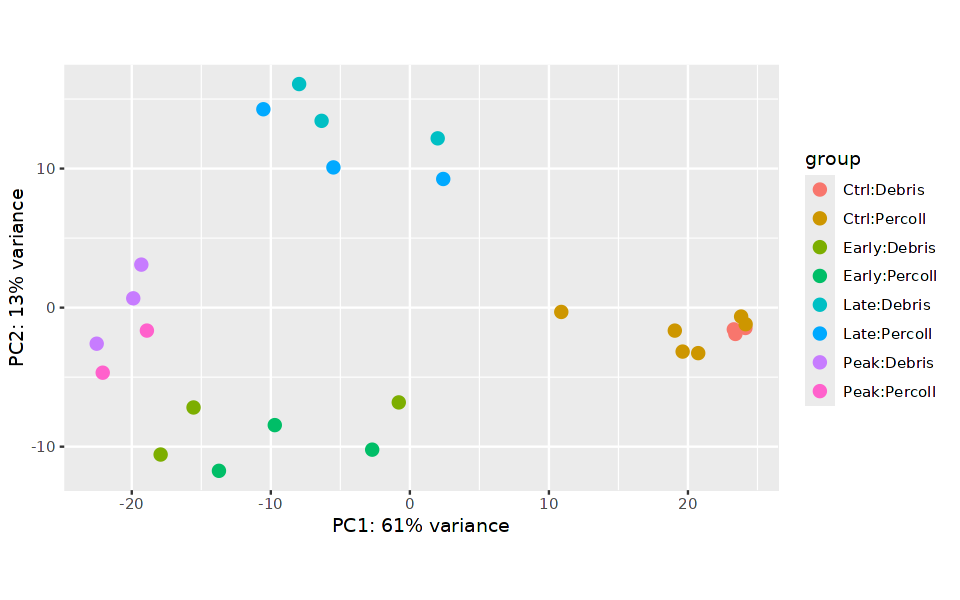

In [49]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [50]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

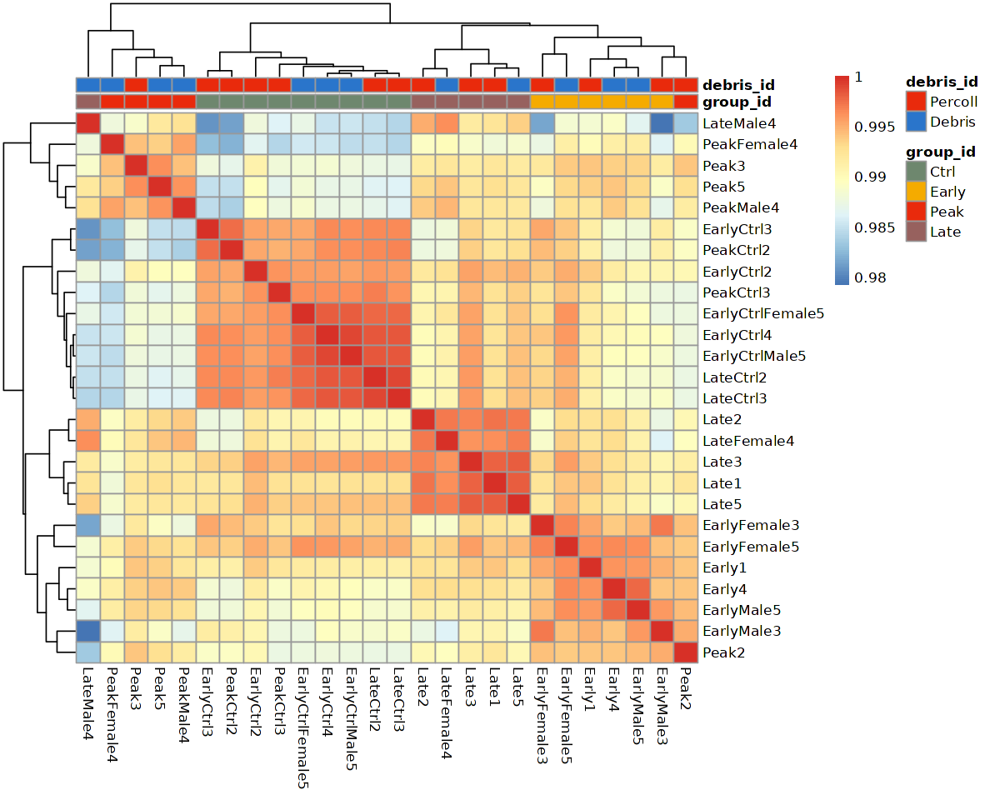

In [51]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=orig.ident_merge_colors, debris_id=debris_colors))

In [52]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [53]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


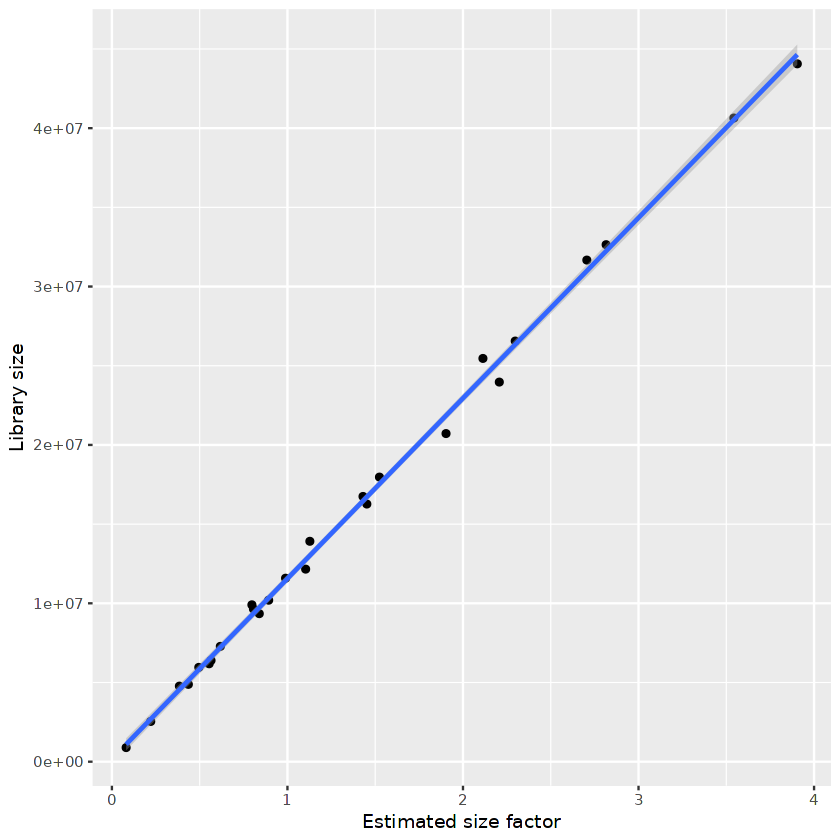

In [54]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [55]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1,MOL56,Early1,Early,Percoll,1.10371888
Early4,MOL56,Early4,Early,Debris,0.56466037
EarlyCtrl2,MOL56,EarlyCtrl2,Ctrl,Percoll,0.08110118
EarlyCtrl3,MOL56,EarlyCtrl3,Ctrl,Percoll,0.80638936
EarlyCtrl4,MOL56,EarlyCtrl4,Ctrl,Debris,2.29768991
EarlyCtrlFemale5,MOL56,EarlyCtrlFemale5,Ctrl,Debris,2.11364683
EarlyCtrlMale5,MOL56,EarlyCtrlMale5,Ctrl,Debris,2.70557900
EarlyFemale3,MOL56,EarlyFemale3,Early,Percoll,1.12768484
EarlyFemale5,MOL56,EarlyFemale5,Early,Debris,3.90458367


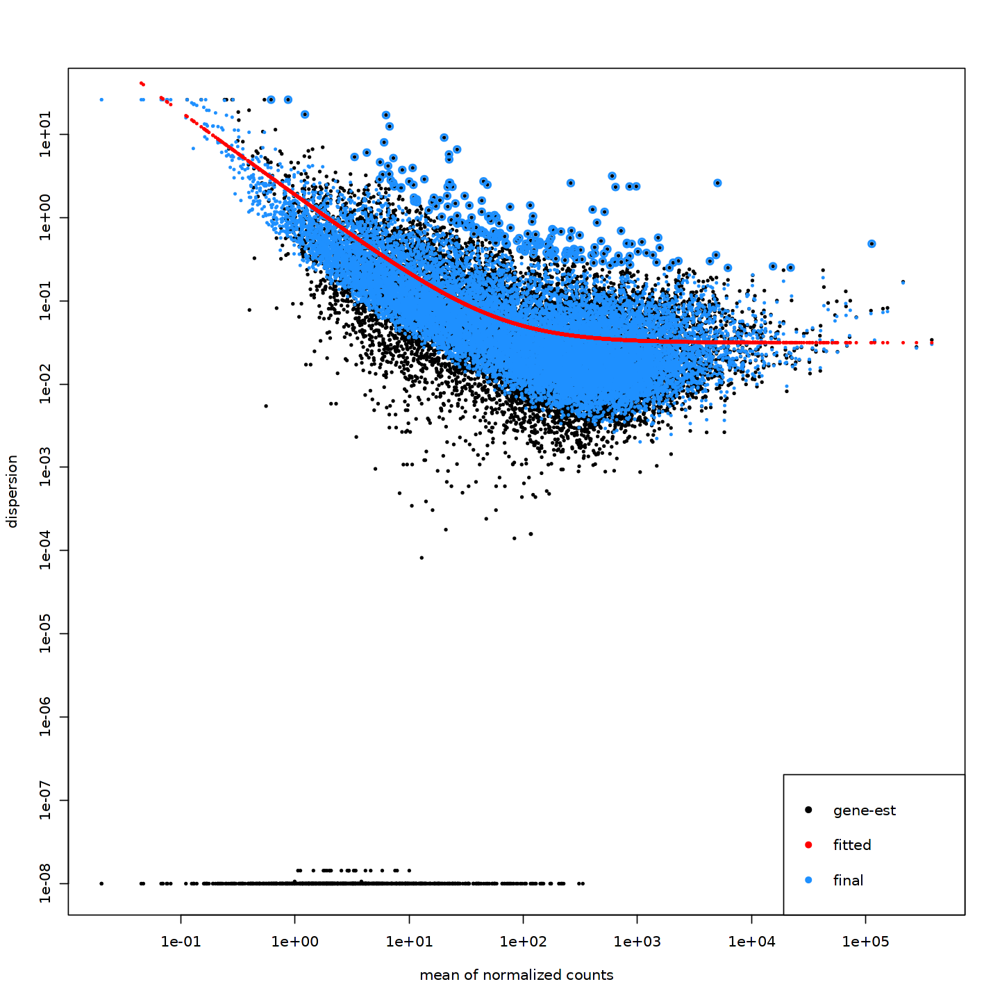

In [56]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

##### 3.1.1.1 Early/Ctrl

In [57]:
condition1 = "Early"
condition2 = "Ctrl"

In [58]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [59]:
summary(res)


out of 15897 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2211, 14%
LFC < 0 (down)     : 1964, 12%
outliers [1]       : 8, 0.05%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



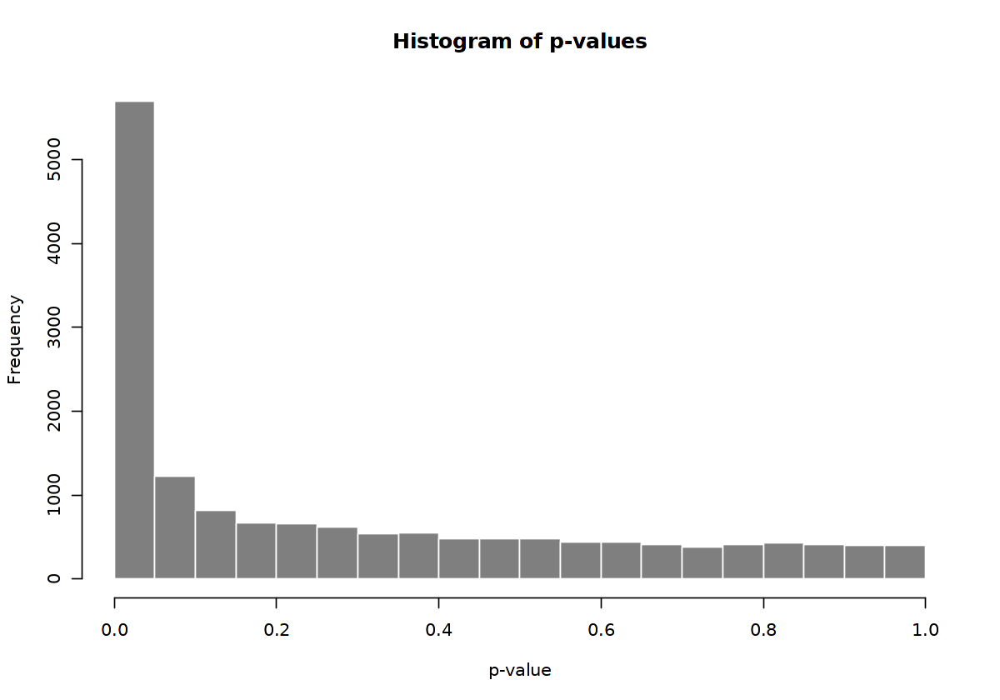

In [60]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

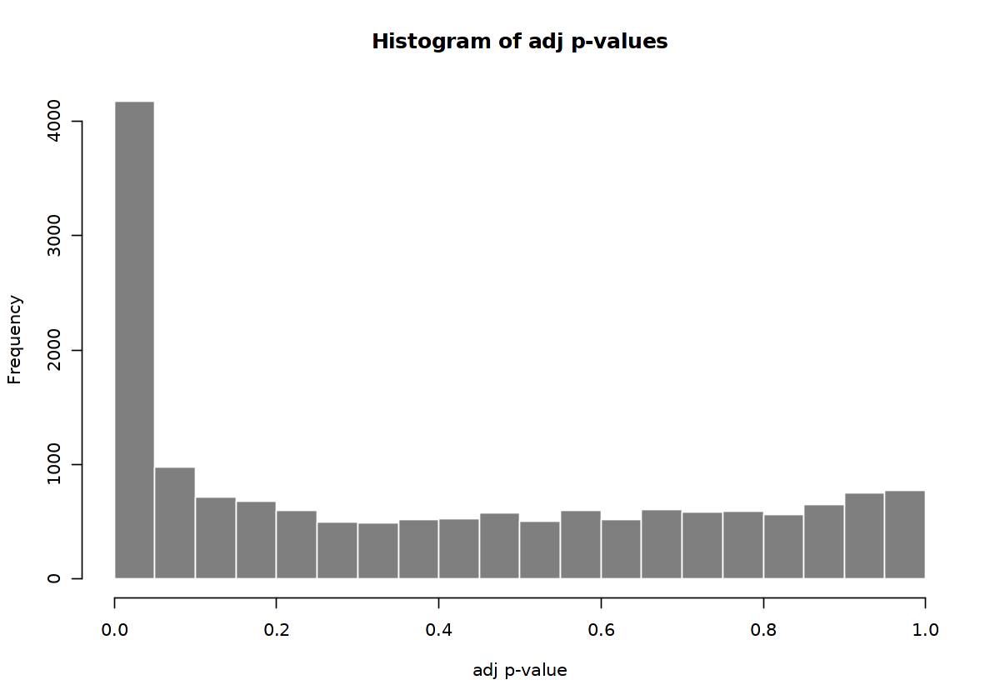

In [61]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

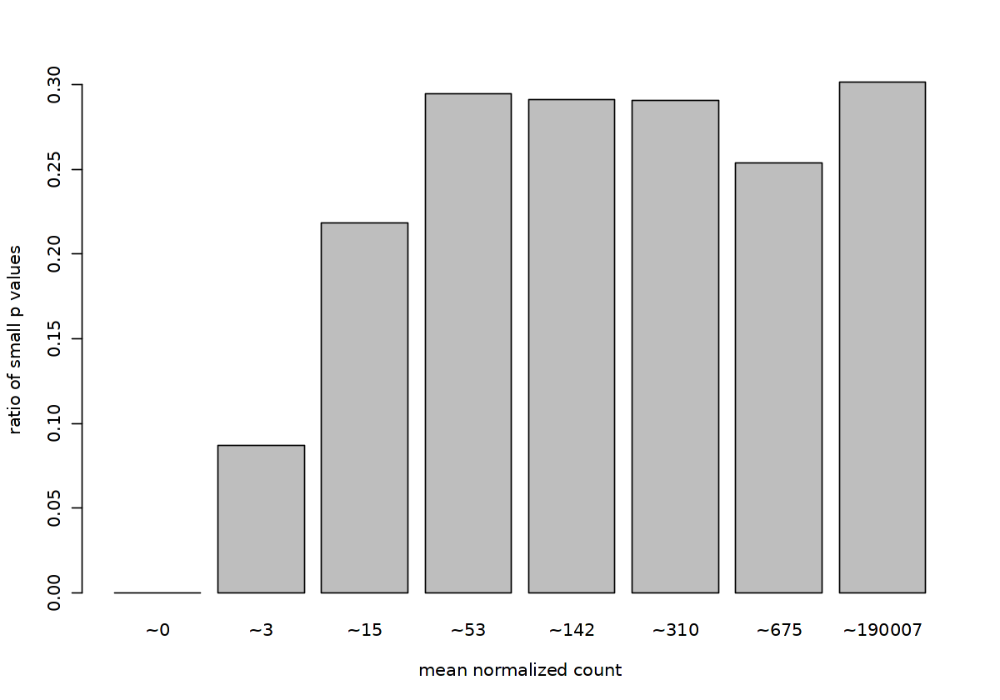

In [62]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

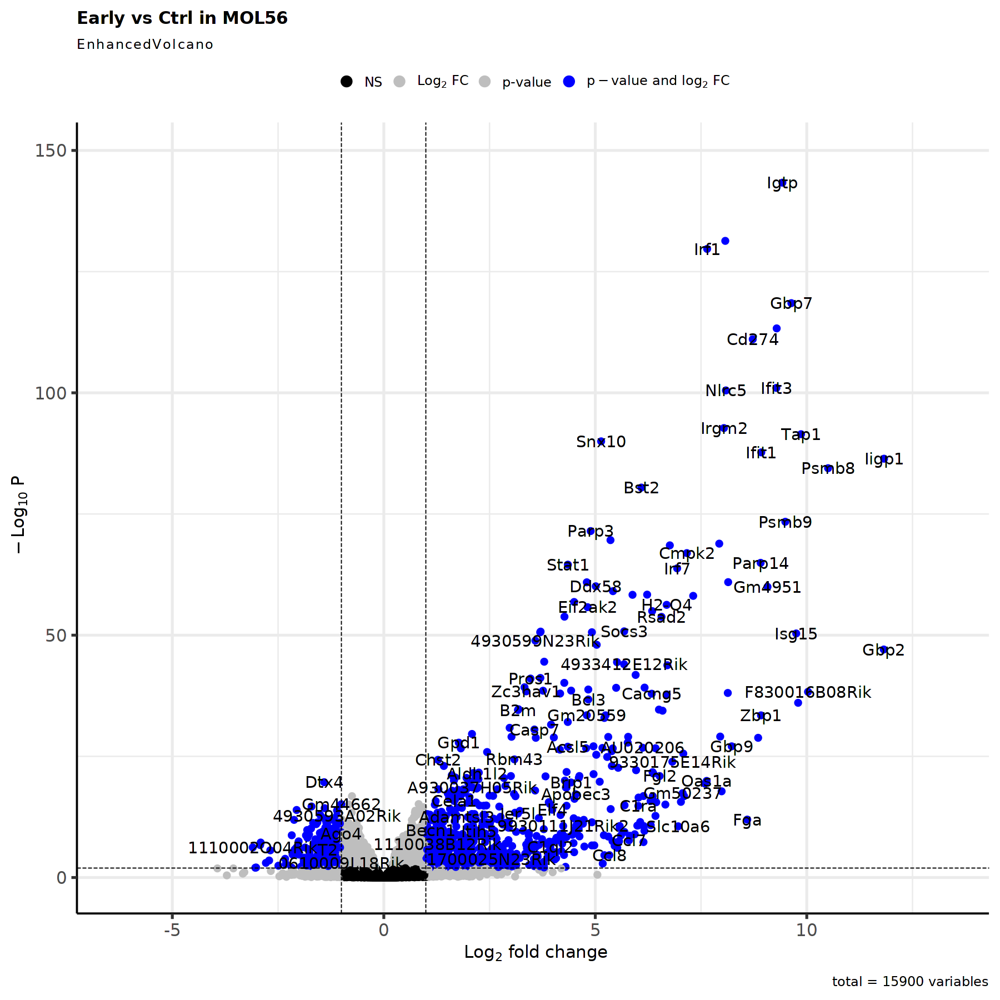

In [63]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [64]:
res <- res[complete.cases(res$padj),]

In [65]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [66]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Early vs Ctrl 
Wald test p-value: group id Early vs Ctrl 
DataFrame with 1000 rows and 6 columns
               baseMean log2FoldChange     lfcSE      stat      pvalue        padj
              <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Iigp1          3174.889       11.82654  0.587193   20.1408 3.23908e-90 3.95890e-87
Gbp2            544.540       11.82075  0.792521   14.9154 2.61751e-50 9.04120e-48
Psmb8          1471.148       10.50439  0.527509   19.9132 3.12753e-88 3.54952e-85
F830016B08Rik   363.369       10.03007  0.743765   13.4855 1.90278e-41 4.87633e-39
Tap1            928.638        9.86404  0.476016   20.7221 2.18996e-95 3.47963e-92
...                 ...            ...       ...       ...         ...         ...
Cfap410         43.3452        1.00376  0.307793   3.26115 1.10961e-03 6.61558e-03
Vegfb          213.6058       -1.00358  0.236436  -4.24463 2.18956e-05 2.43798e-04
Tmprss9         15.5246        1.00246  

In [67]:
nrow(res_filtered)

[1] 1000

In [68]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.1.2 Peak/Early

In [69]:
condition1 = "Peak"
condition2 = "Early"

In [70]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [71]:
summary(res)


out of 15897 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2086, 13%
LFC < 0 (down)     : 1500, 9.4%
outliers [1]       : 8, 0.05%
low counts [2]     : 617, 3.9%
(mean count < 2)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



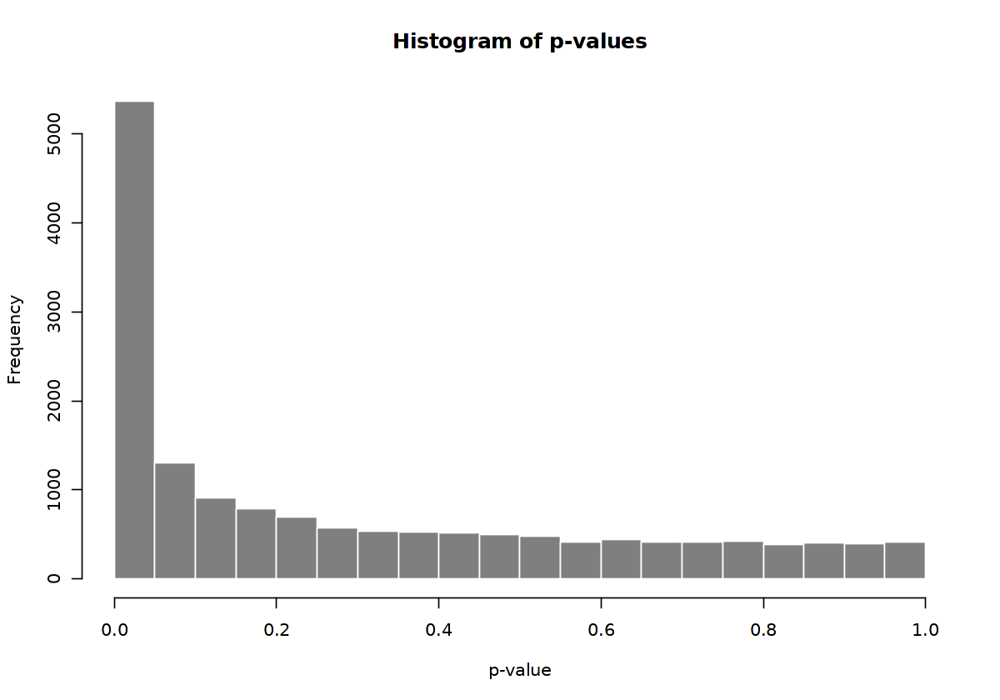

In [72]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

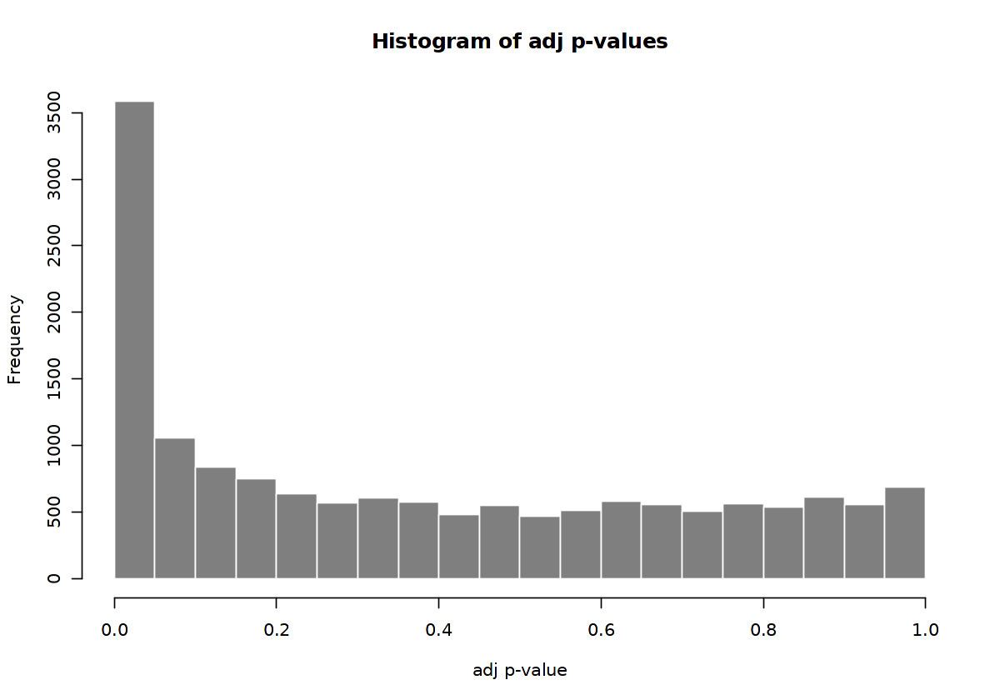

In [73]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

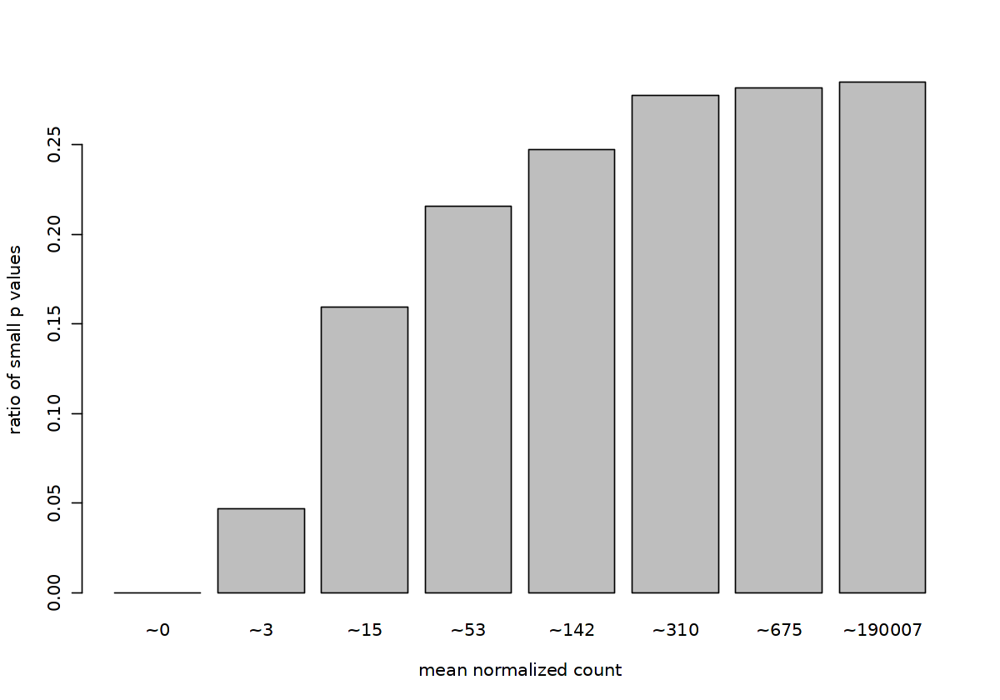

In [74]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

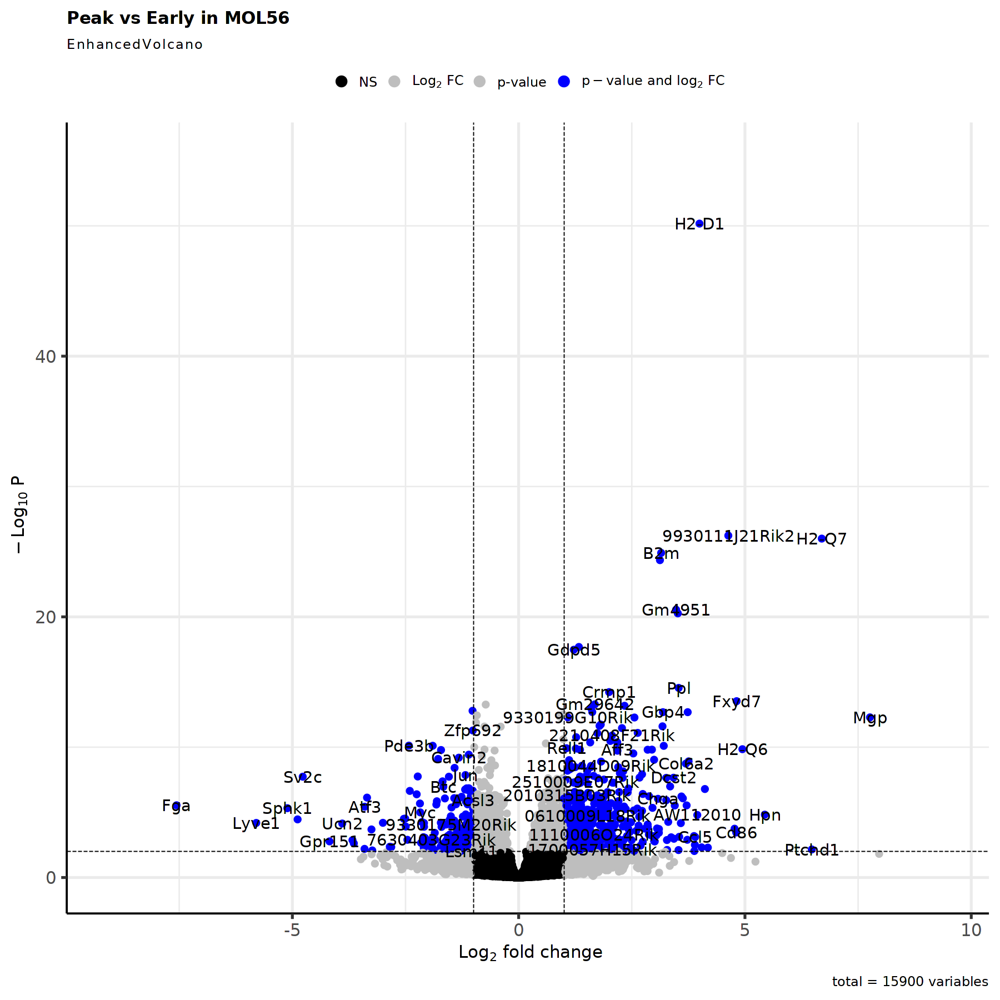

In [75]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [76]:
res <- res[complete.cases(res$padj),]

In [77]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [78]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Peak vs Early 
Wald test p-value: group_id Peak vs Early 
DataFrame with 662 rows and 6 columns
               baseMean log2FoldChange     lfcSE      stat      pvalue        padj
              <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Mgp            77.37364        7.76214  0.964517   8.04770 8.43648e-16 5.15368e-13
Fga            25.42999       -7.55895  1.384639  -5.45915 4.78432e-08 2.86534e-06
H2-Q7         317.52134        6.69711  0.584084  11.46600 1.95485e-30 9.95148e-27
Ptchd1          6.54148        6.47696  1.939860   3.33888 8.41163e-04 7.02364e-03
Lyve1           5.65873       -5.79760  1.225361  -4.73134 2.23040e-06 6.48813e-05
...                 ...            ...       ...       ...         ...         ...
4933406C10Rik   58.9964        1.00462  0.255494   3.93207 8.42190e-05 1.16820e-03
Gk5            166.0599        1.00407  0.169286   5.93121 3.00711e-09 2.98347e-07
Rps18         2561.8009       -1.00277  0

In [79]:
nrow(res_filtered)

[1] 662

In [80]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.1.3 Late/Early

In [81]:
condition1 = "Late"
condition2 = "Early"

In [82]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [83]:
summary(res)


out of 15897 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 3485, 22%
LFC < 0 (down)     : 3462, 22%
outliers [1]       : 8, 0.05%
low counts [2]     : 0, 0%
(mean count < 0)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



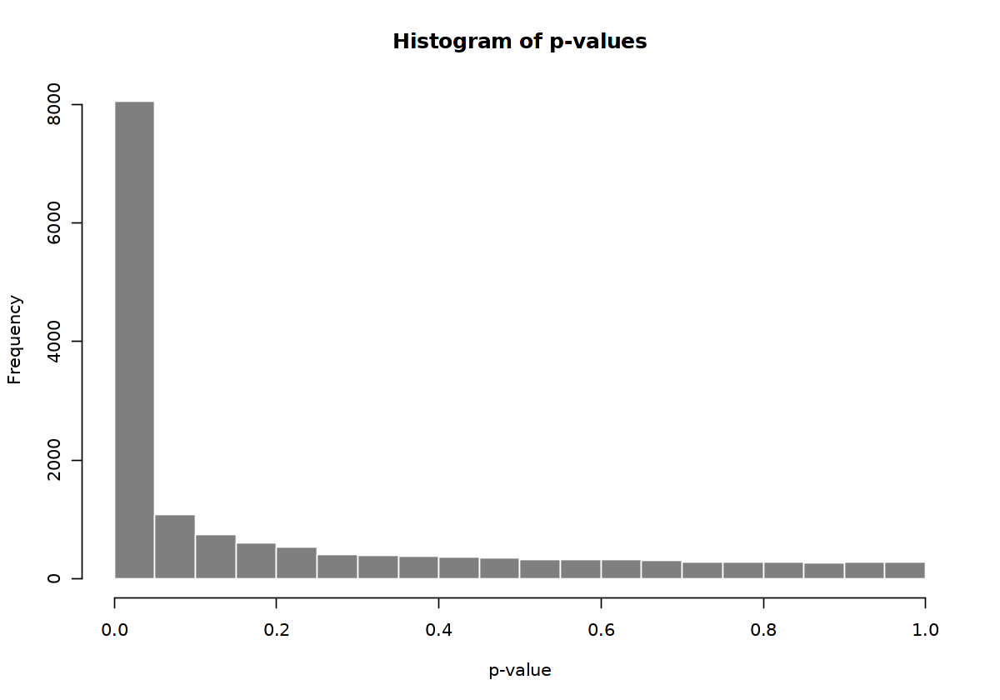

In [84]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

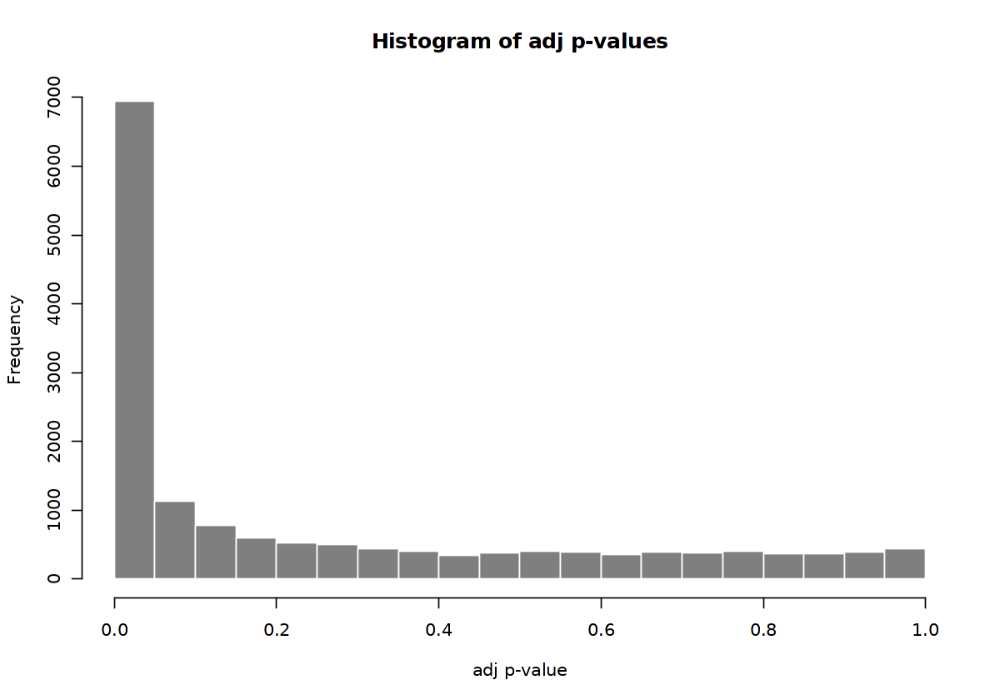

In [85]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

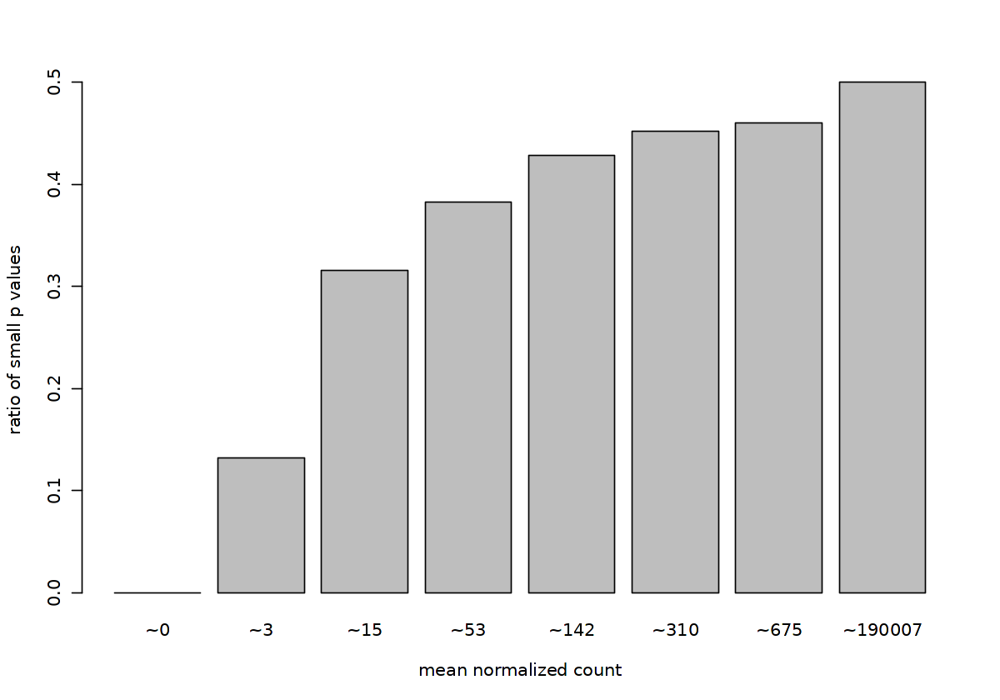

In [86]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

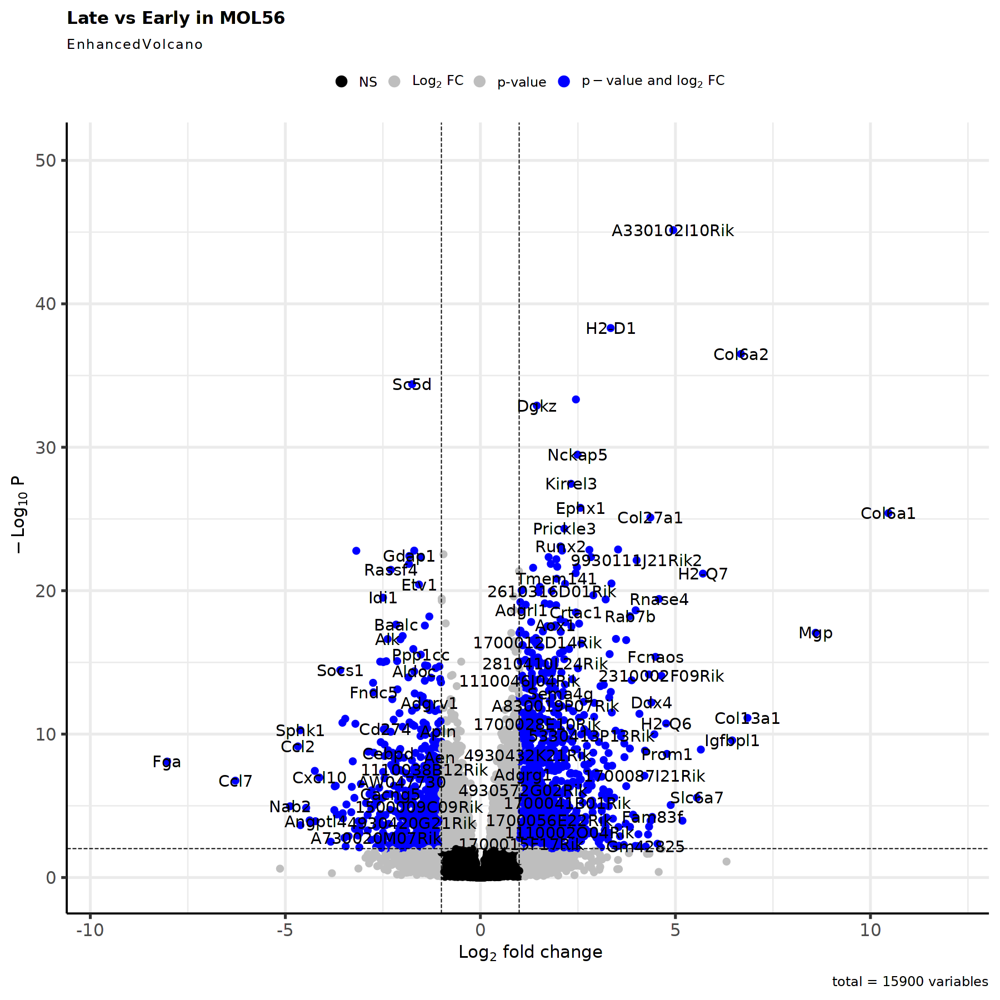

In [87]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [88]:
res <- res[complete.cases(res$padj),]

In [89]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [90]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Late vs Early 
Wald test p-value: group_id Late vs Early 
DataFrame with 1641 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Col6a1    39.1202       10.46242  0.930487  11.24403 2.47804e-29 3.93736e-26
Mgp       77.3736        8.59389  0.935486   9.18656 4.05605e-20 8.59287e-18
Fga       25.4300       -8.02956  1.275684  -6.29432 3.08755e-10 8.20370e-09
Col13a1   49.3227        6.84701  0.924092   7.40944 1.26830e-13 7.49143e-12
Col6a2    59.7373        6.67948  0.498398  13.40189 5.89390e-41 3.12161e-37
...           ...            ...       ...       ...         ...         ...
Eef1e1   233.8952       -1.00195  0.189701  -5.28174 1.27966e-07 1.81865e-06
Srbd1    595.6711        1.00191  0.109137   9.18033 4.29788e-20 8.86870e-18
Gm19412   16.7295        1.00159  0.320886   3.12133 1.80039e-03 6.26920e-03
Paqr8   1197.7675      

In [91]:
nrow(res_filtered)

[1] 1641

In [92]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.1.4 Peak/Late

In [93]:
condition1 = "Peak"
condition2 = "Late"

In [94]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [95]:
summary(res)


out of 15897 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2231, 14%
LFC < 0 (down)     : 1908, 12%
outliers [1]       : 8, 0.05%
low counts [2]     : 617, 3.9%
(mean count < 2)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



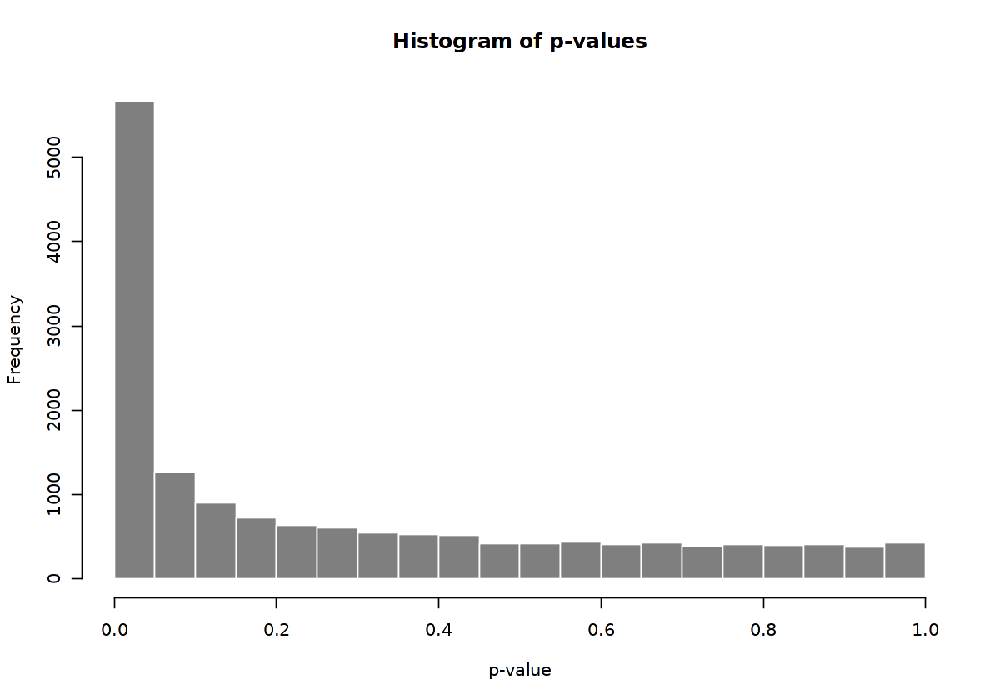

In [96]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

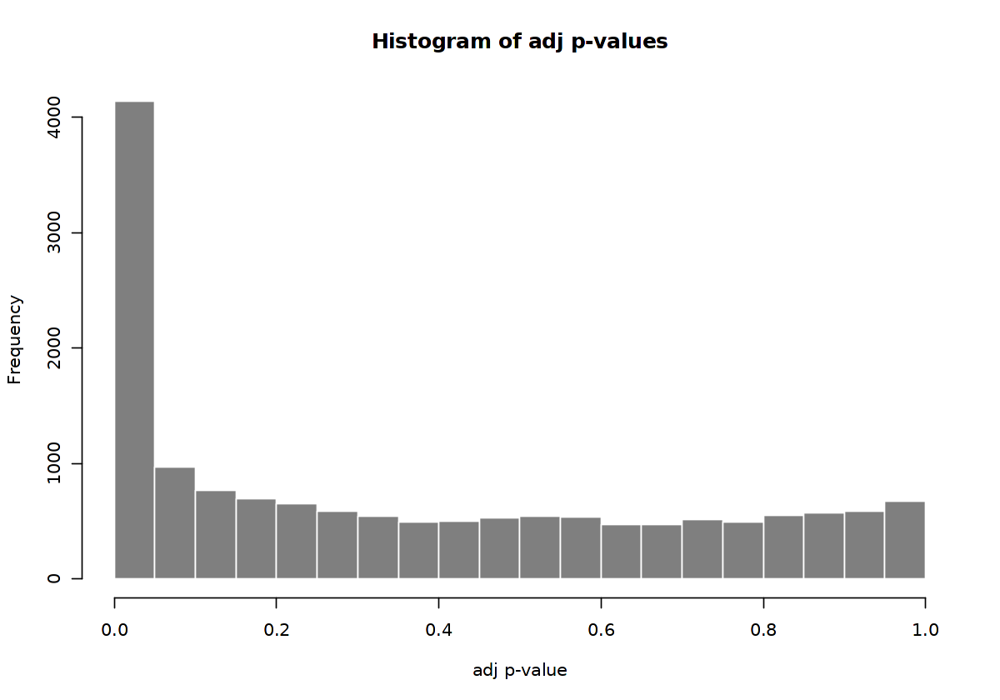

In [97]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

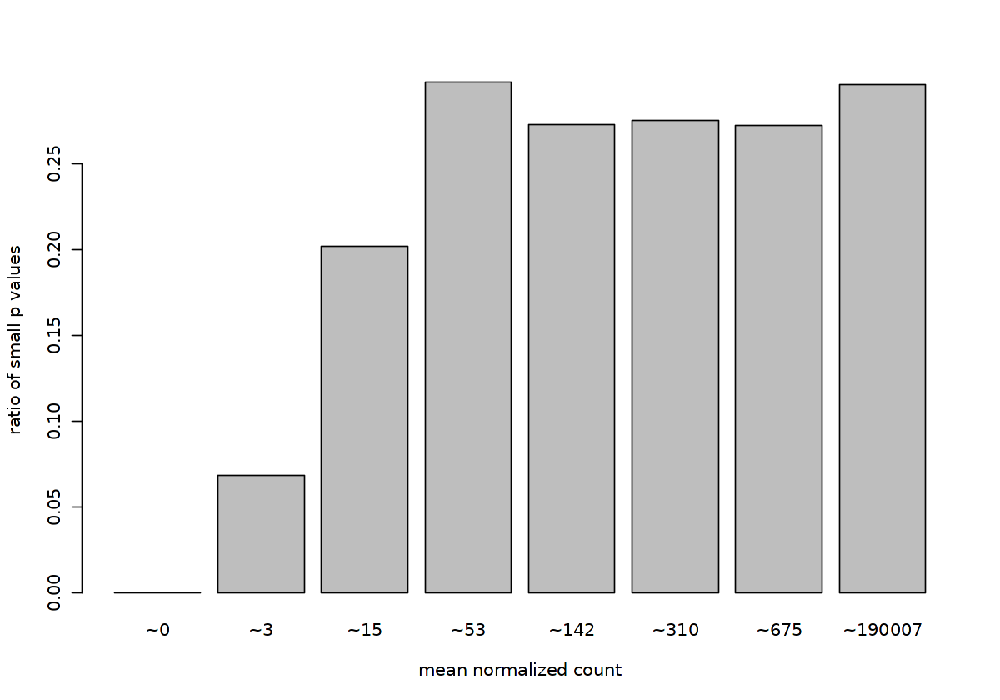

In [98]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

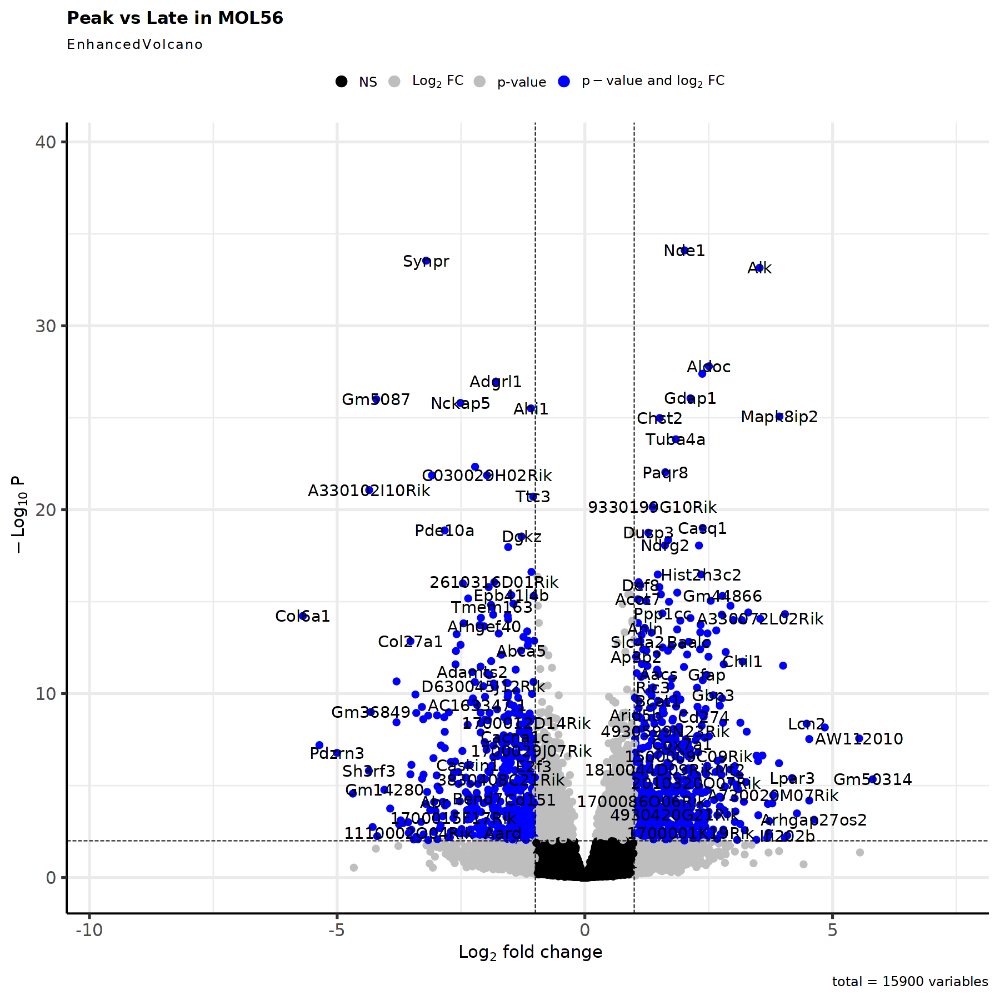

In [99]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [100]:
res <- res[complete.cases(res$padj),]

In [101]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [102]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Peak vs Late 
Wald test p-value: group_id Peak vs Late 
DataFrame with 1126 rows and 6 columns
          baseMean log2FoldChange     lfcSE      stat      pvalue        padj
         <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Gm50314    3.65426        5.81049  1.116966   5.20202 1.97131e-07 4.56149e-06
Col6a1    39.12022       -5.69191  0.672260  -8.46682 2.52181e-17 6.01767e-15
AW112010  12.04243        5.53698  0.893870   6.19439 5.85102e-10 2.74434e-08
Prom1     45.20607       -5.35810  0.886663  -6.04300 1.51279e-09 6.29518e-08
Pdzrn3    27.14237       -5.00353  0.853872  -5.85981 4.63401e-09 1.66519e-07
...            ...            ...       ...       ...         ...         ...
Fzd8       39.2249       -1.00285  0.252866  -3.96595 7.31053e-05 7.45801e-04
Akip1      34.1391       -1.00206  0.268047  -3.73837 1.85216e-04 1.61913e-03
Smarcd3   101.6075       -1.00126  0.167541  -5.97621 2.28385e-09 8.98942e-08
Acads      38.

In [103]:
nrow(res_filtered)

[1] 1126

In [104]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.1.5 Summary

In [105]:
listInput_upset <- HVGs.list[[cluster_choice]]
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

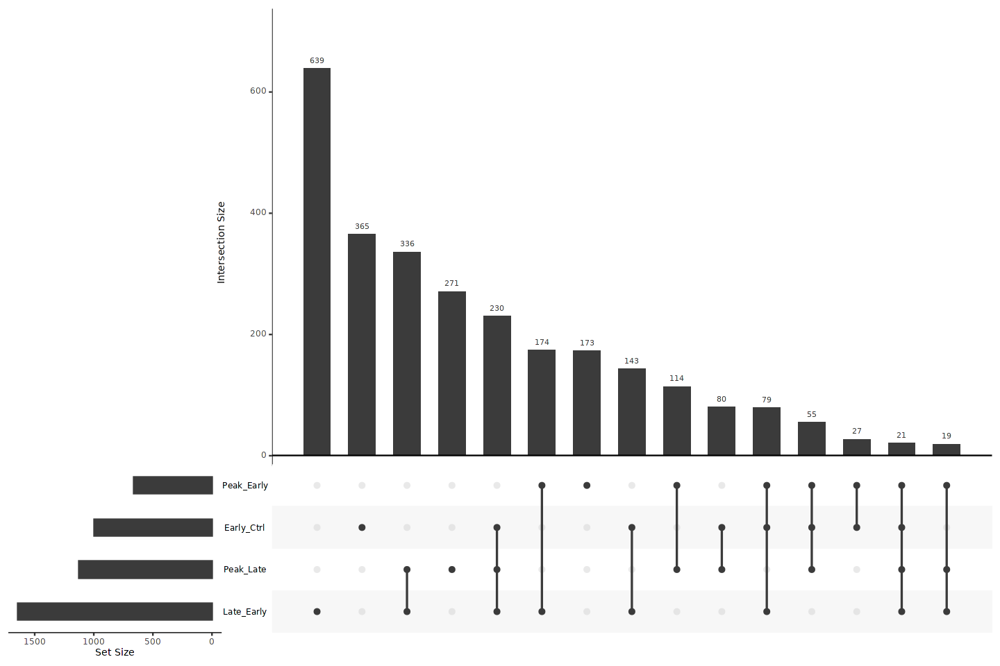

In [106]:
options(repr.plot.width=12, repr.plot.height=8)
upset(fromList(listInput_upset), order.by = "freq")

In [107]:
HVG <- unique(unlist(HVGs.list[[cluster_choice]]))

In [108]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

In [109]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [110]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_merge %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [111]:
DefaultAssay(tmp) <- "RNA"

In [112]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [113]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [114]:
DefaultAssay(tmp) <- "GenePromAcc"

In [115]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [116]:
DefaultAssay(tmp) <- "RNA"

In [117]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)])
tmp$orig.ident_merge <- factor(x = tmp$orig.ident_merge, levels = names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)])

In [118]:
Idents(object = tmp) <- "orig.ident_merge"

Warning message:
"`StashIdent()` was deprecated in SeuratObject 3.0.0.
ℹ Please use object[["ident"]] <- Idents(object)"
Warning message:
"`aes_string()` was deprecated in ggplot2 3.0.0.
ℹ Please use tidy evaluation idioms with `aes()`.
ℹ See also `vignette("ggplot2-in-packages")` for more information."
Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


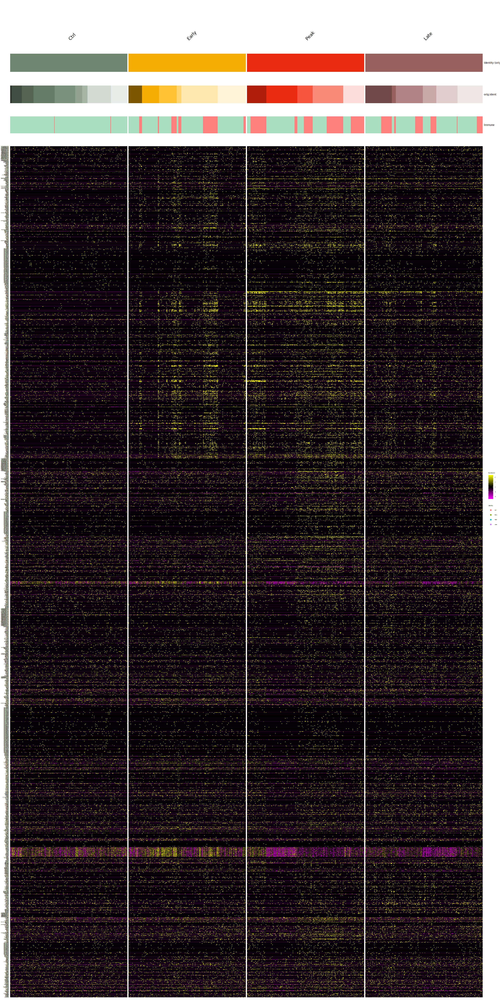

In [119]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVG,
    cells = NULL,
    group.by = "orig.ident_merge",
    additional.group.by = c("orig.ident", "Immune"),
    additional.group.sort.by = c("orig.ident", "Immune"),
    cols.use = list(orig.ident_merge=orig.ident_merge_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 4))

In [120]:
gene_list <- HVG

In [121]:
Idents(object = tmp) <- "orig.ident_merge"

In [122]:
sample_names <- levels(tmp$orig.ident)

In [123]:
tmp_sample_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [124]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, sample_names)))

In [125]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [126]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [127]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [128]:
tmp_sample_markers_GenePromAcc_sub <- as.data.frame(AggregateExpression(tmp, assays = "GenePromAcc", group.by = "orig.ident", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["GenePromAcc"]]$data[gene_list_GenePromAcc,])

  |==========================================================================================| 100%


In [129]:
matrix <- tmp_sample_markers/do.call(pmax, tmp_sample_markers)

In [130]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [131]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

In [132]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [133]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk.pdf"), width=30, height=plot_height)

png 
  2

In [134]:
gene_list <- gene_list[ph$tree_row$order]

In [135]:
tmp_sample_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [136]:
tmp_sample_markers_mean[rownames(tmp_sample_markers),"Mean_Log2Exp"] <- rowMeans(tmp_sample_markers)

In [137]:
matrix <- tmp_sample_markers_mean

In [138]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

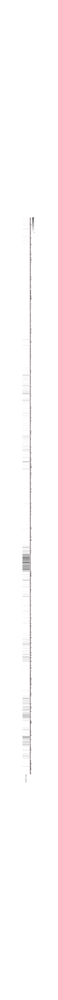

In [139]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [140]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [141]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [142]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

In [143]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [144]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk_zscore.pdf"), width=30, height=plot_height)

png 
  2

In [145]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [146]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [147]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [148]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [149]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [150]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [151]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk.pdf"), width=30, height=plot_height)

png 
  2

In [152]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Acc")))

In [153]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Log2Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [154]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [155]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [156]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

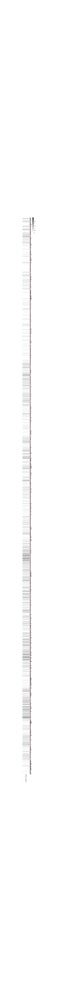

In [157]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [158]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [159]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [160]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [161]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [162]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

In [163]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [164]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk_zscore.pdf"), width=30, height=plot_height)

png 
  2

In [165]:
gene_list <- HVG

In [166]:
sample_names <- levels(tmp$orig.ident_merge)

In [167]:
tmp_sample_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_merge", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [168]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, sample_names)))

In [169]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [170]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [171]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [172]:
tmp_sample_markers_GenePromAcc_sub <- as.data.frame(AggregateExpression(tmp, assays = "GenePromAcc", group.by = "orig.ident_merge", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["GenePromAcc"]]$data[gene_list_GenePromAcc,])

  |==========================================================================================| 100%


In [173]:
matrix <- tmp_sample_markers/do.call(pmax, tmp_sample_markers)

In [174]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [175]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

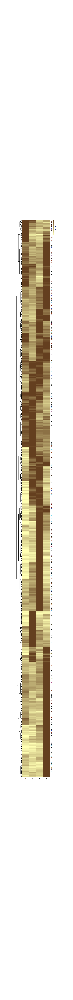

In [176]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [177]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk.pdf"), width=10, height=plot_height)

png 
  2

In [178]:
gene_list <- gene_list[ph$tree_row$order]

In [179]:
tmp_sample_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [180]:
tmp_sample_markers_mean[rownames(tmp_sample_markers),"Mean_Log2Exp"] <- rowMeans(tmp_sample_markers)

In [181]:
matrix <- tmp_sample_markers_mean

In [182]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

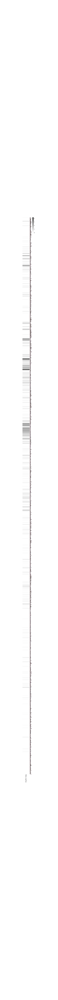

In [183]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [184]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [185]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [186]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

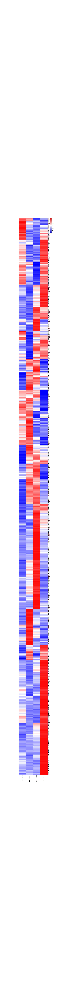

In [187]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [188]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk_zscore.pdf"), width=10, height=plot_height)

png 
  2

In [189]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [190]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [191]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [192]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [193]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

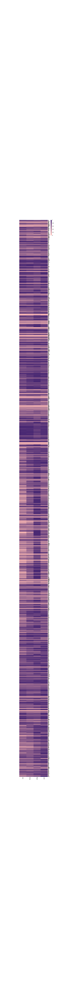

In [194]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [195]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk.pdf"), width=10, height=plot_height)

png 
  2

In [196]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Acc")))

In [197]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Log2Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [198]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [199]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [200]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

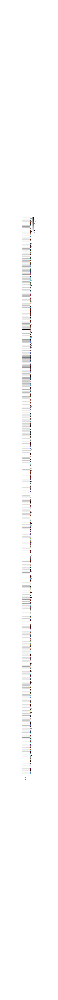

In [201]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [202]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [203]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [204]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [205]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [206]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

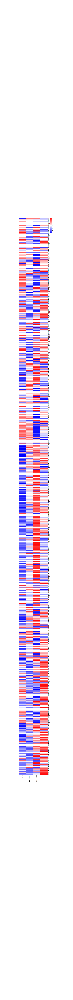

In [207]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [208]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk_zscore.pdf"), width=10, height=plot_height)

png 
  2

#### 3.1.2 MOL2

In [209]:
cluster_choice <- "MOL2"

In [210]:
HVGs.list[[cluster_choice]] <- list()

In [211]:
table_sample_low <- table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)[cluster_choice,][table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)]

named integer(0)

In [212]:
table_group_low <-table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)[cluster_choice,][table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)]

named integer(0)

In [213]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [215]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [216]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [217]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [218]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



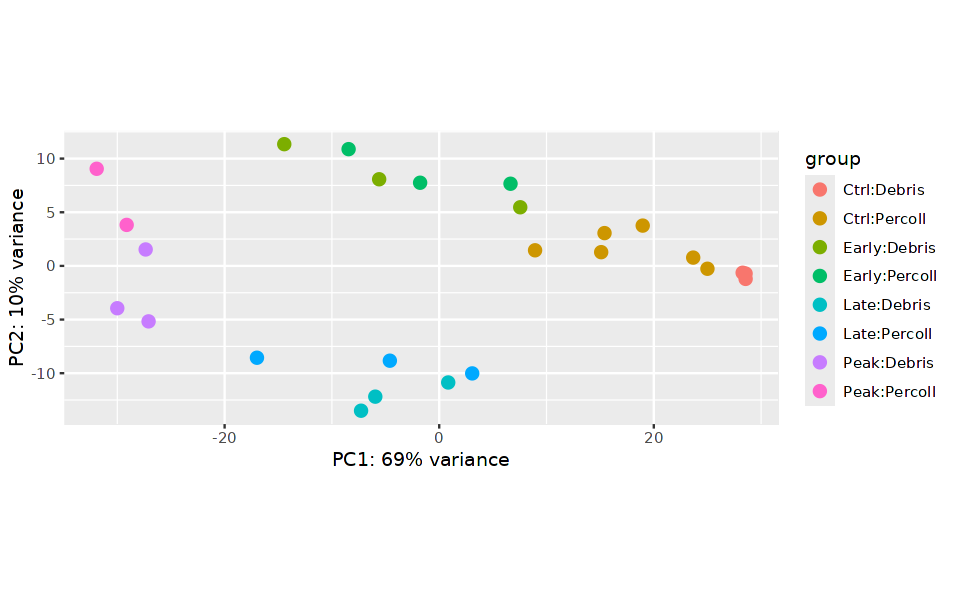

In [219]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [220]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

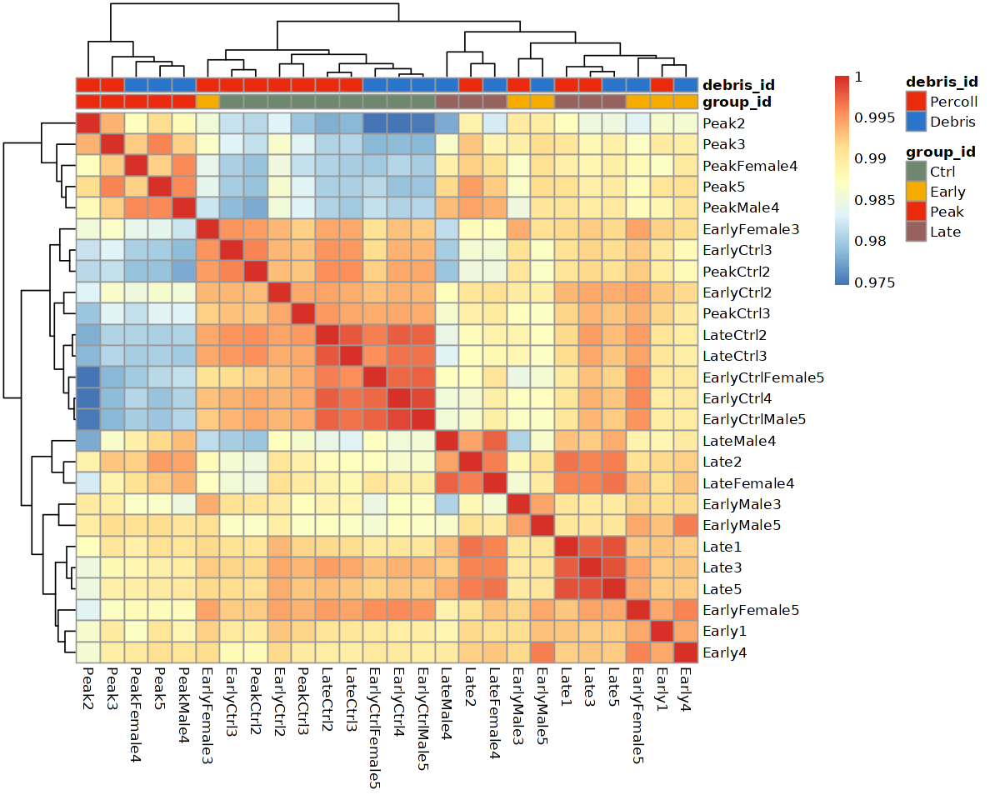

In [221]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=orig.ident_merge_colors, debris_id=debris_colors))

In [222]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [223]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


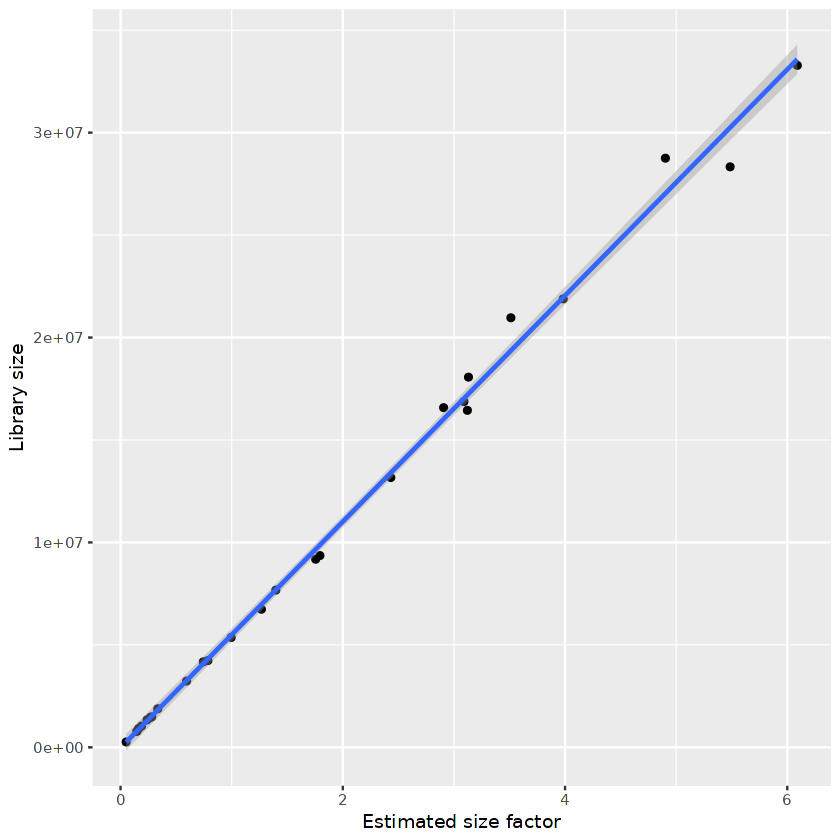

In [224]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [225]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1,MOL2,Early1,Early,Percoll,0.28019230
Early4,MOL2,Early4,Early,Debris,0.26953883
EarlyCtrl2,MOL2,EarlyCtrl2,Ctrl,Percoll,0.05029025
EarlyCtrl3,MOL2,EarlyCtrl3,Ctrl,Percoll,0.16216150
EarlyCtrl4,MOL2,EarlyCtrl4,Ctrl,Debris,3.12128601
EarlyCtrlFemale5,MOL2,EarlyCtrlFemale5,Ctrl,Debris,3.13110731
EarlyCtrlMale5,MOL2,EarlyCtrlMale5,Ctrl,Debris,3.09001132
EarlyFemale3,MOL2,EarlyFemale3,Early,Percoll,0.23905916
EarlyFemale5,MOL2,EarlyFemale5,Early,Debris,2.43173042


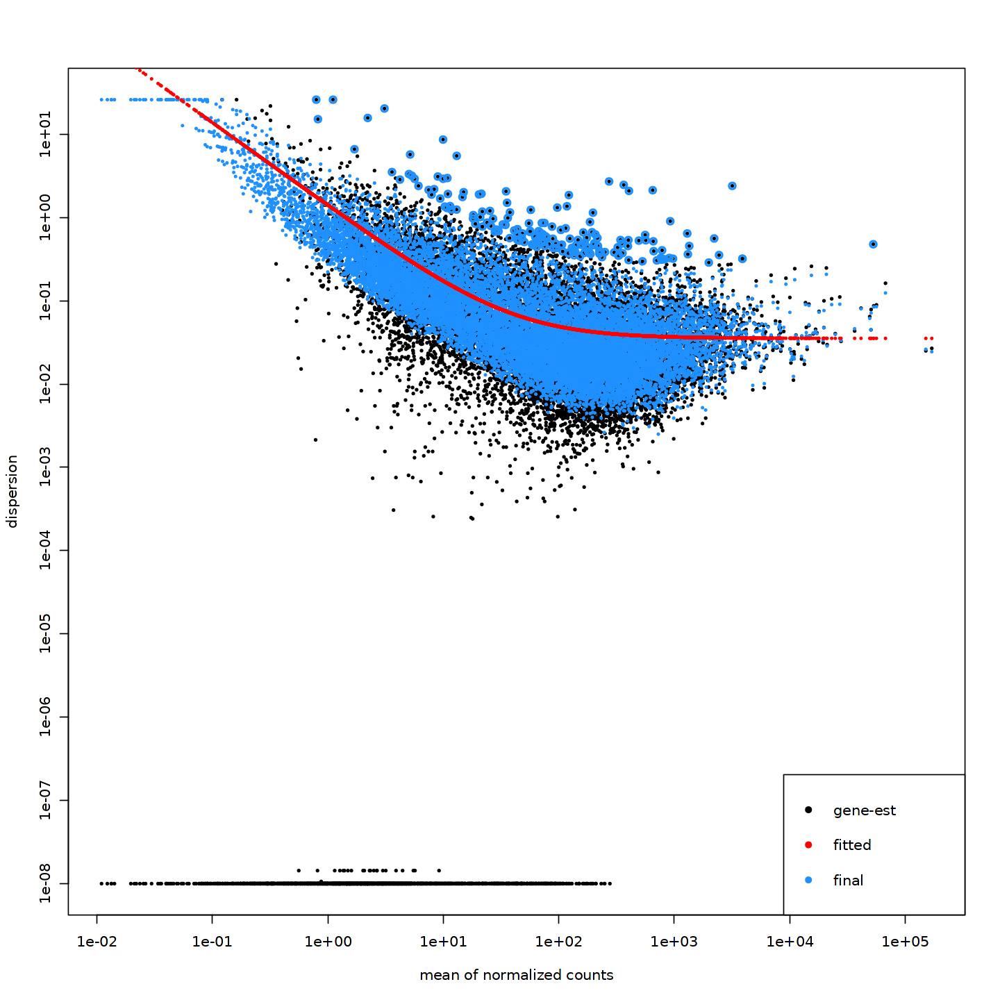

In [226]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

##### 3.1.2.1 Early/Ctrl

In [227]:
condition1 = "Early"
condition2 = "Ctrl"

In [228]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [229]:
summary(res)


out of 15898 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 1568, 9.9%
LFC < 0 (down)     : 1015, 6.4%
outliers [1]       : 4, 0.025%
low counts [2]     : 1540, 9.7%
(mean count < 2)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



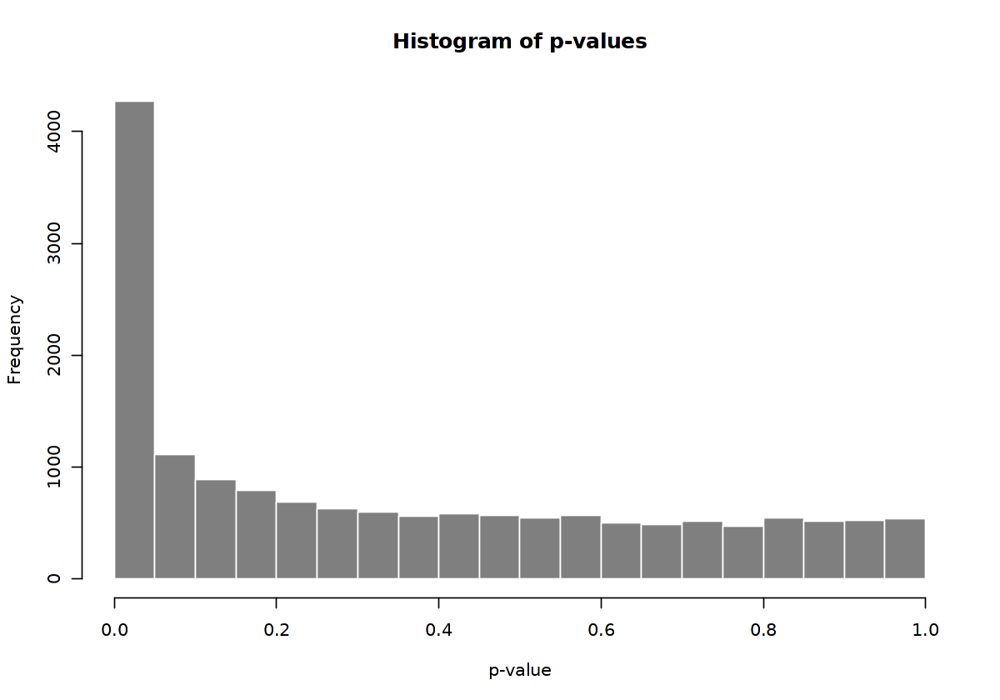

In [230]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

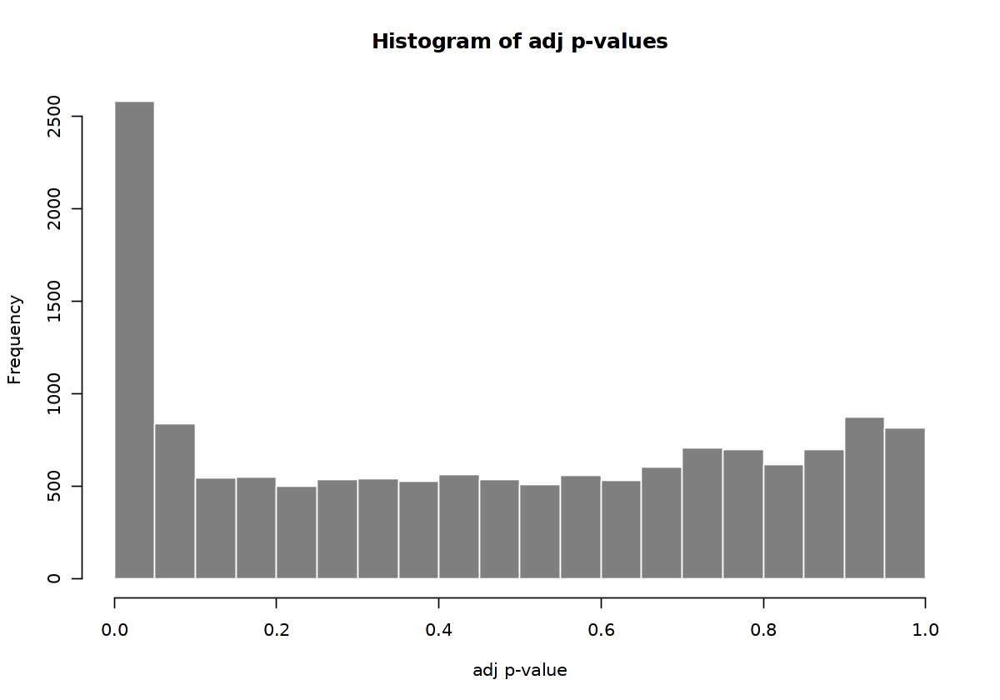

In [231]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

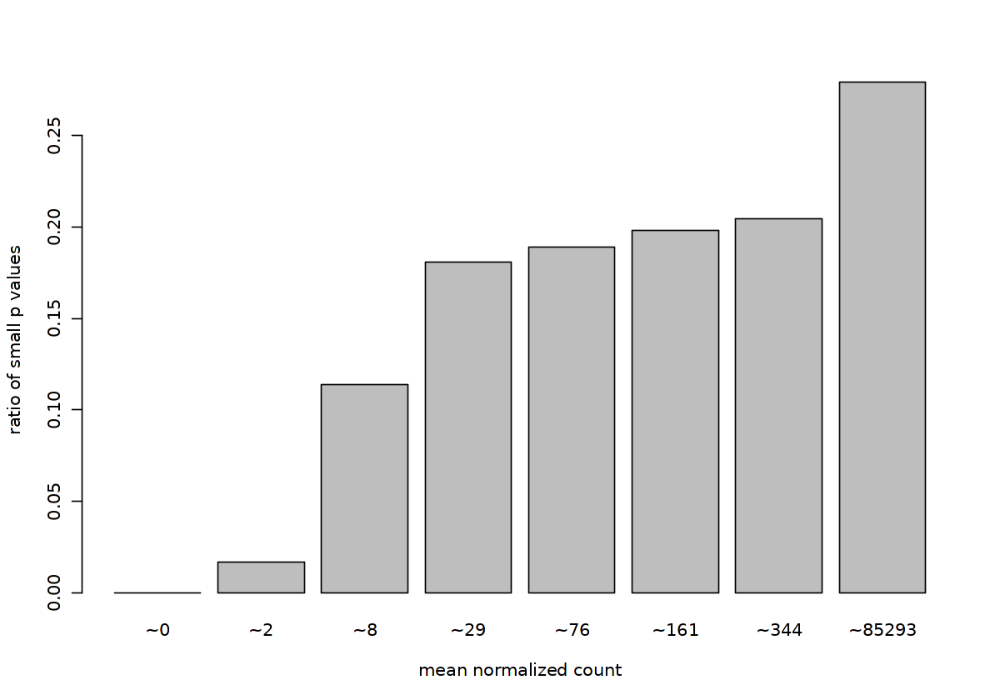

In [232]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

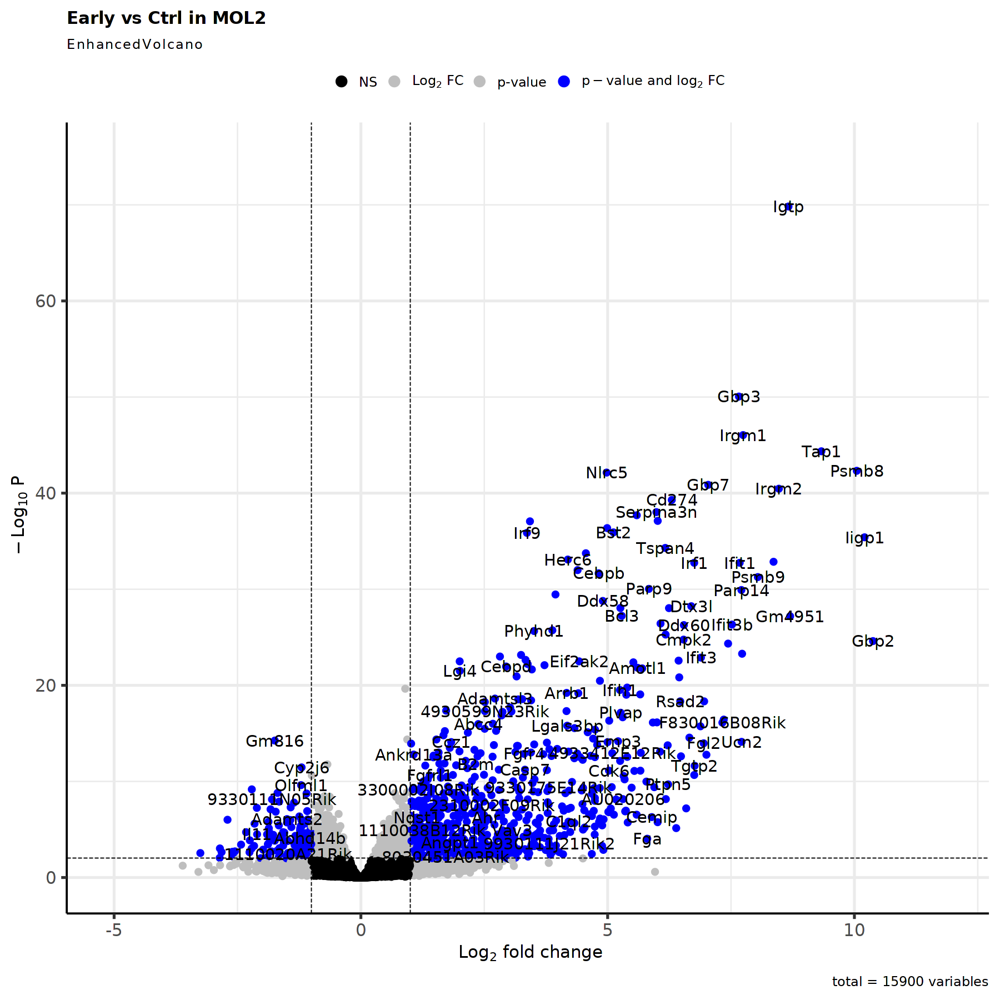

In [233]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [234]:
res <- res[complete.cases(res$padj),]

In [235]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [236]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Early vs Ctrl 
Wald test p-value: group id Early vs Ctrl 
DataFrame with 814 rows and 6 columns
        baseMean log2FoldChange     lfcSE      stat      pvalue        padj
       <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Gbp2     923.457       10.37648  0.948540   10.9394 7.46811e-28 2.49296e-25
Iigp1   2217.856       10.20592  0.780664   13.0734 4.67435e-39 3.94680e-36
Psmb8    764.678       10.04783  0.701684   14.3196 1.65097e-46 4.73959e-43
Tap1     470.298        9.33067  0.636634   14.6562 1.22883e-48 4.40966e-45
Gm4951   784.354        8.69789  0.757332   11.4849 1.57101e-30 6.44293e-28
...          ...            ...       ...       ...         ...         ...
Ndst4    45.2425        1.00556  0.248144   4.05234 5.07086e-05 7.16408e-04
Tsr1     49.3652        1.00503  0.196420   5.11672 3.10890e-07 8.91749e-06
Sema6a  674.2581       -1.00307  0.252053  -3.97958 6.90378e-05 9.33116e-04
Ddah1    27.8478        1.00175  0.

In [237]:
nrow(res_filtered)

[1] 814

In [238]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.2.2 Peak/Early

In [239]:
condition1 = "Peak"
condition2 = "Early"

In [240]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [241]:
summary(res)


out of 15898 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2293, 14%
LFC < 0 (down)     : 1374, 8.6%
outliers [1]       : 4, 0.025%
low counts [2]     : 617, 3.9%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



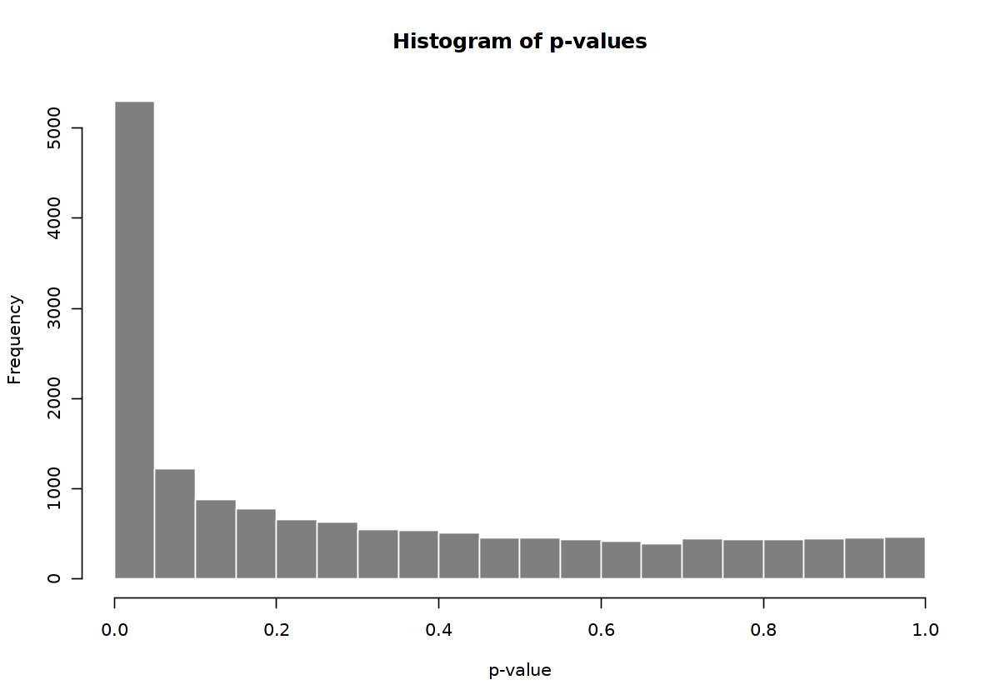

In [242]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

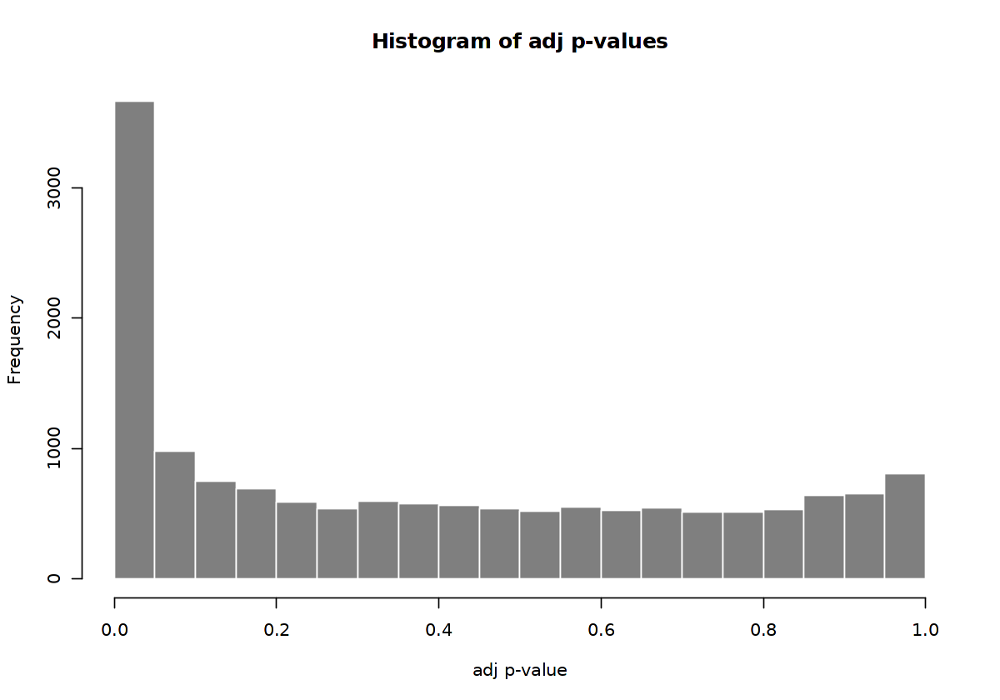

In [243]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

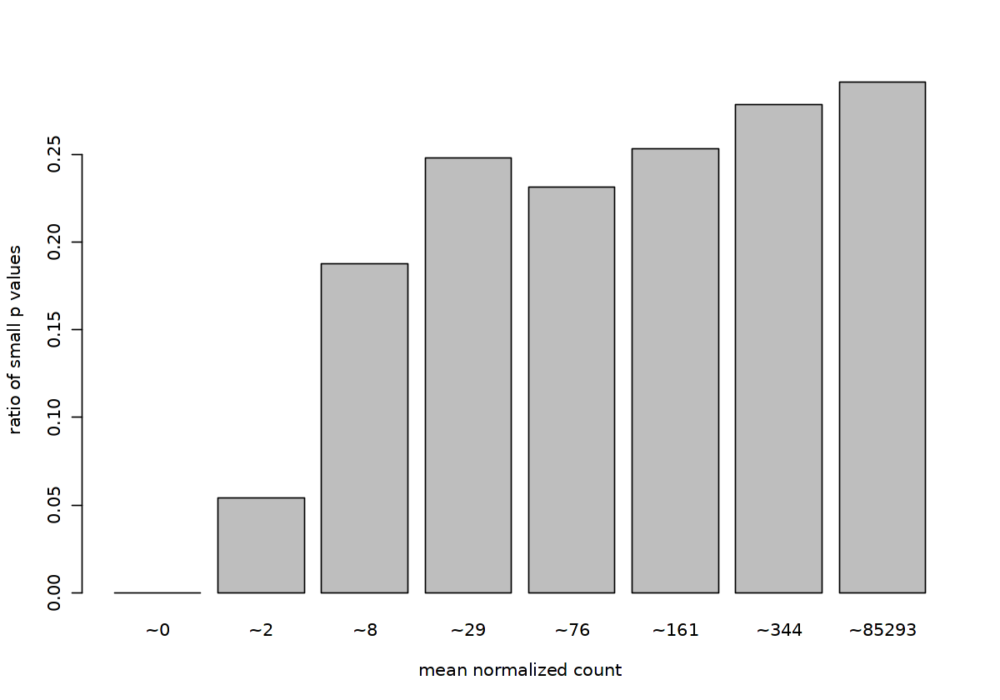

In [244]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

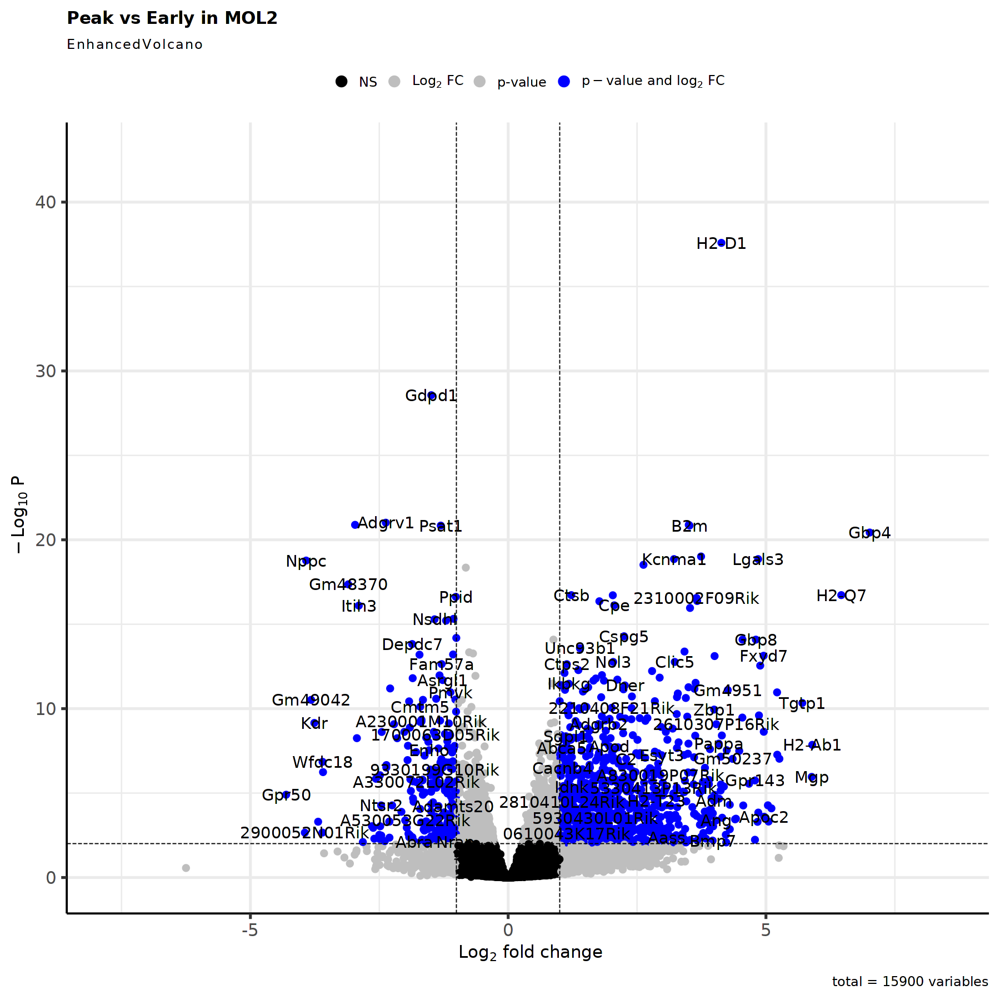

In [245]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [246]:
res <- res[complete.cases(res$padj),]

In [247]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [248]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Peak vs Early 
Wald test p-value: group_id Peak vs Early 
DataFrame with 1079 rows and 6 columns
        baseMean log2FoldChange     lfcSE      stat      pvalue        padj
       <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Gbp4    175.9919        7.01223  0.687335  10.20204 1.94141e-24 3.70737e-21
H2-Q7   155.4939        6.46078  0.697426   9.26374 1.97390e-20 1.88470e-17
H2-Ab1   19.5631        5.89853  0.923557   6.38675 1.69446e-10 1.39174e-08
Mgp      26.9435        5.88752  1.058271   5.56334 2.64660e-08 1.09572e-06
Tgtp1    23.4125        5.70532  0.780573   7.30915 2.68839e-13 4.61467e-11
...          ...            ...       ...       ...         ...         ...
Zfp709   15.6596        1.00335  0.278623   3.60109 3.16884e-04 2.96553e-03
Zhx2    249.3669        1.00179  0.175609   5.70465 1.16579e-08 5.38060e-07
Snca    284.2005        1.00090  0.243192   4.11568 3.86048e-05 5.15079e-04
Hmgb3    29.9613        1.00063  0

In [249]:
nrow(res_filtered)

[1] 1079

In [250]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.2.3 Late/Early

In [251]:
condition1 = "Late"
condition2 = "Early"

In [252]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [253]:
summary(res)


out of 15898 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2426, 15%
LFC < 0 (down)     : 2359, 15%
outliers [1]       : 4, 0.025%
low counts [2]     : 617, 3.9%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



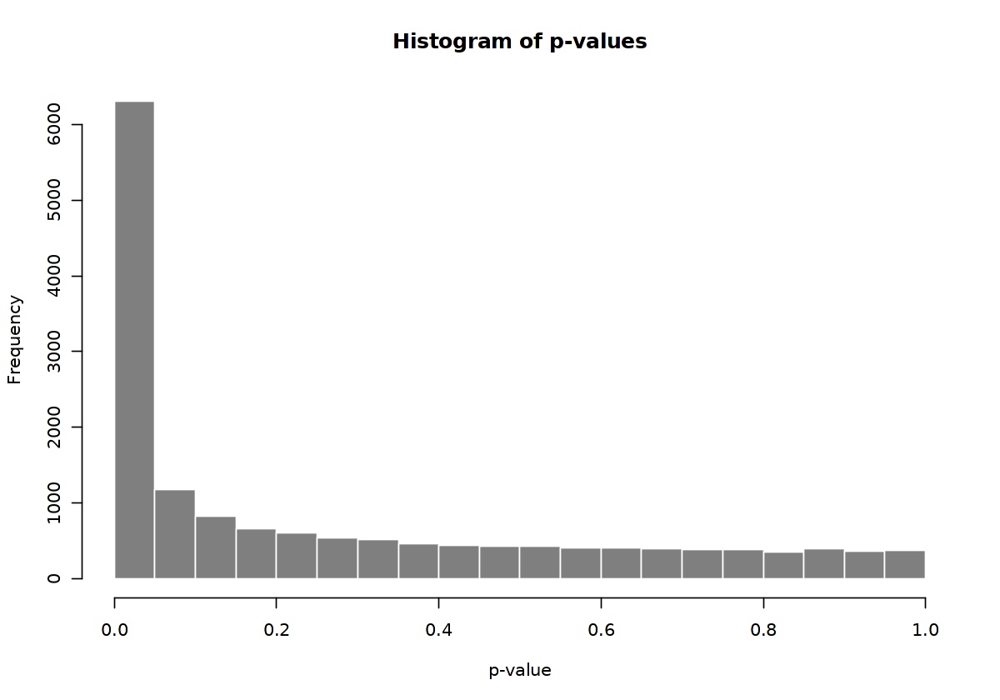

In [254]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

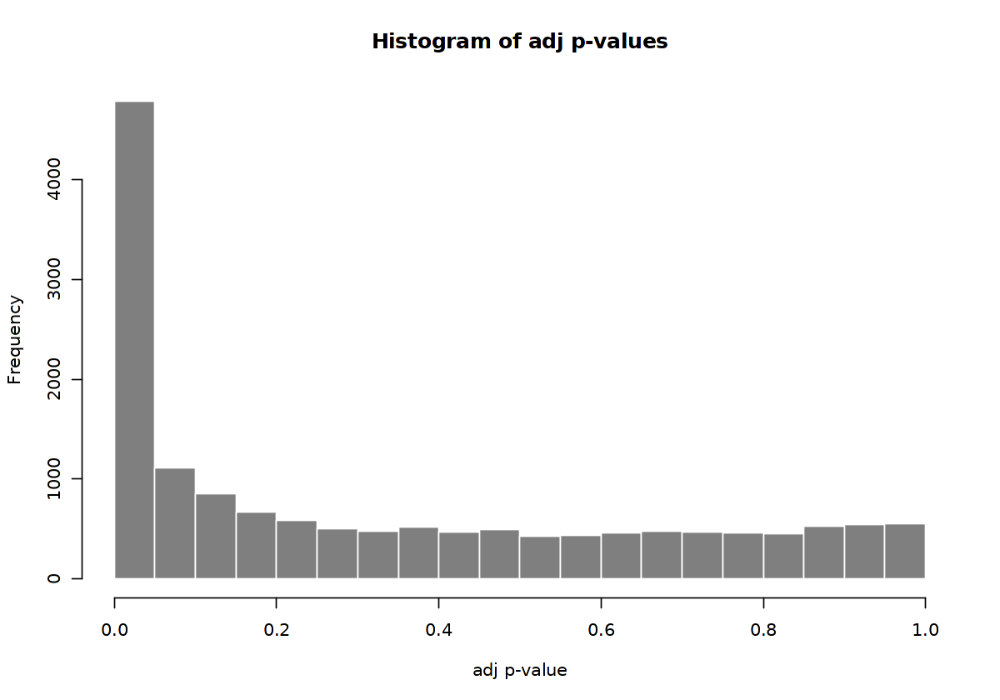

In [255]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

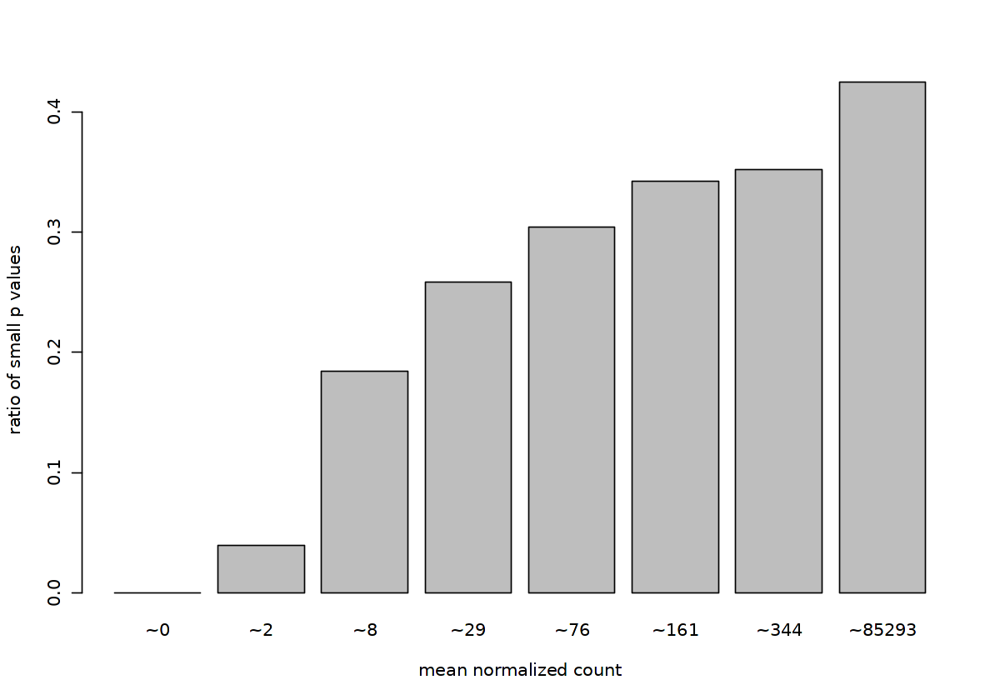

In [256]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

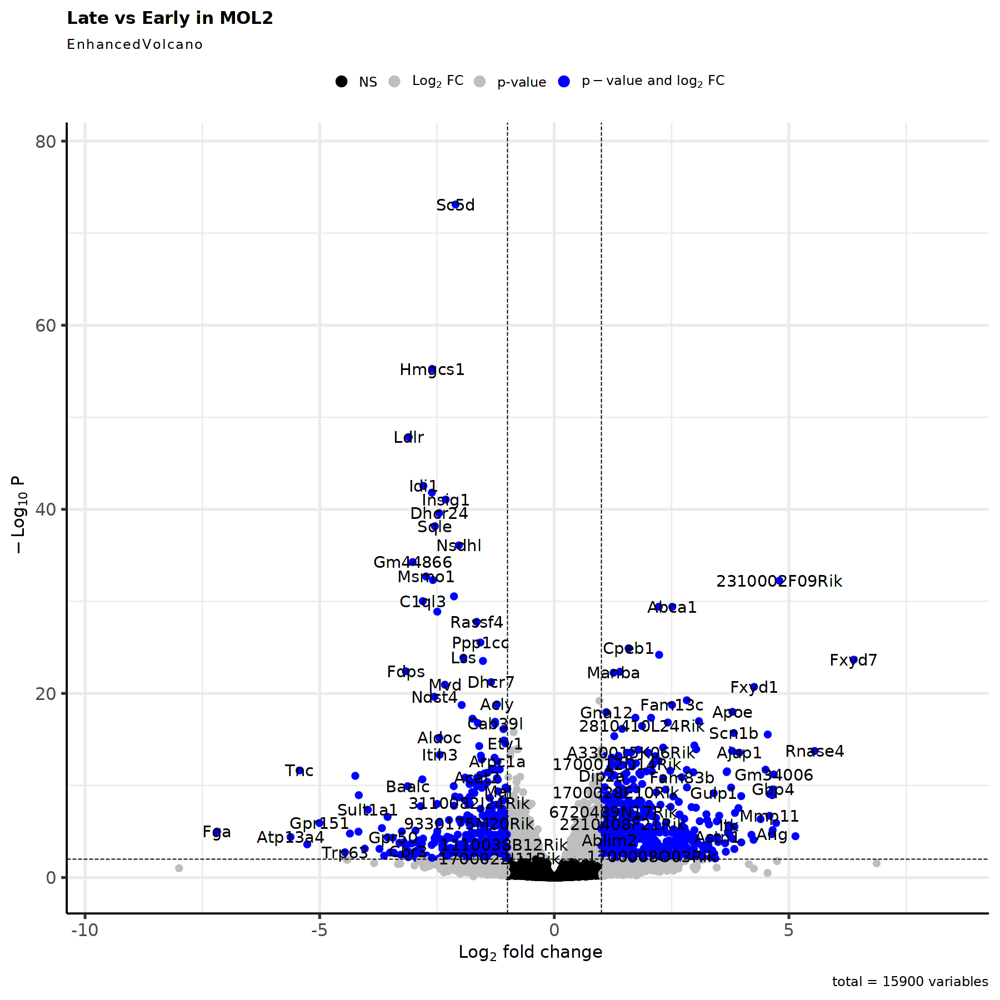

In [257]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [258]:
res <- res[complete.cases(res$padj),]

In [259]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [260]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Late vs Early 
Wald test p-value: group_id Late vs Early 
DataFrame with 1091 rows and 6 columns
          baseMean log2FoldChange     lfcSE      stat      pvalue        padj
         <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Fga        7.46218       -7.18778  1.418802  -5.06609 4.06074e-07 1.03393e-05
Fxyd7    109.42483        6.38061  0.590785  10.80022 3.43380e-27 2.18576e-24
Atp13a4    2.11701       -5.62070  1.182447  -4.75345 1.99973e-06 3.97123e-05
Rnase4    33.99715        5.54823  0.666092   8.32953 8.11652e-17 1.79705e-14
Tnc       11.43064       -5.42867  0.706756  -7.68112 1.57704e-14 2.33907e-12
...            ...            ...       ...       ...         ...         ...
Ccne2      13.2127       -1.00246  0.293375  -3.41699 6.33167e-04 4.12666e-03
Gm1976    213.7898        1.00180  0.214544   4.66942 3.02046e-06 5.47373e-05
Pigc       91.7993       -1.00168  0.143218  -6.99410 2.66961e-12 2.47173e-10
Magi2   1978

In [261]:
nrow(res_filtered)

[1] 1091

In [262]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.2.4 Peak/Late

In [263]:
condition1 = "Peak"
condition2 = "Late"

In [264]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [265]:
summary(res)


out of 15898 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 2320, 15%
LFC < 0 (down)     : 1646, 10%
outliers [1]       : 4, 0.025%
low counts [2]     : 923, 5.8%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



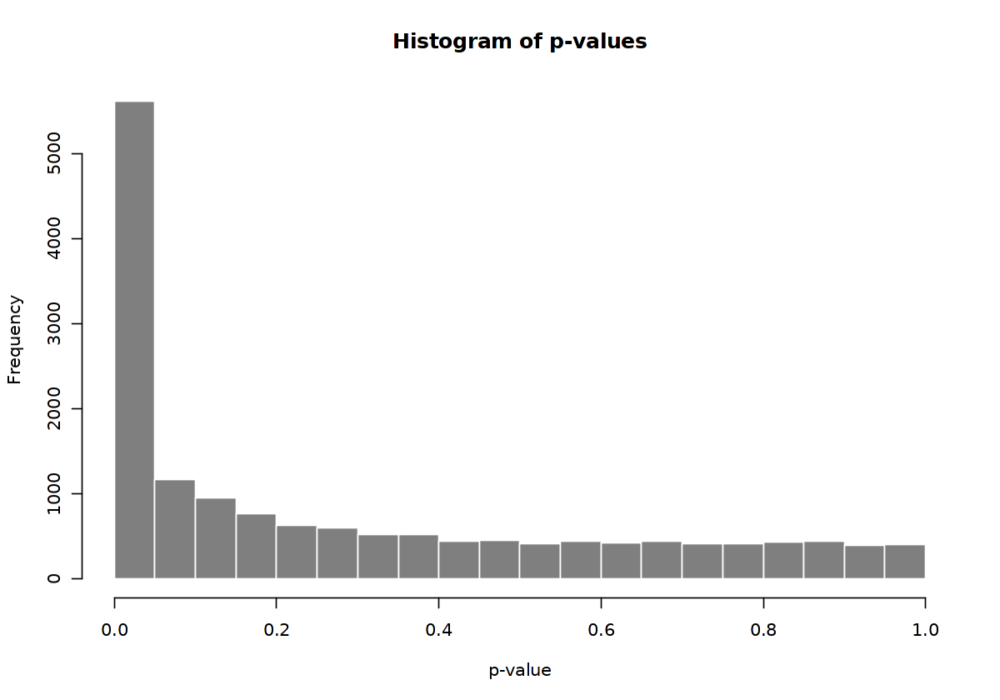

In [266]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

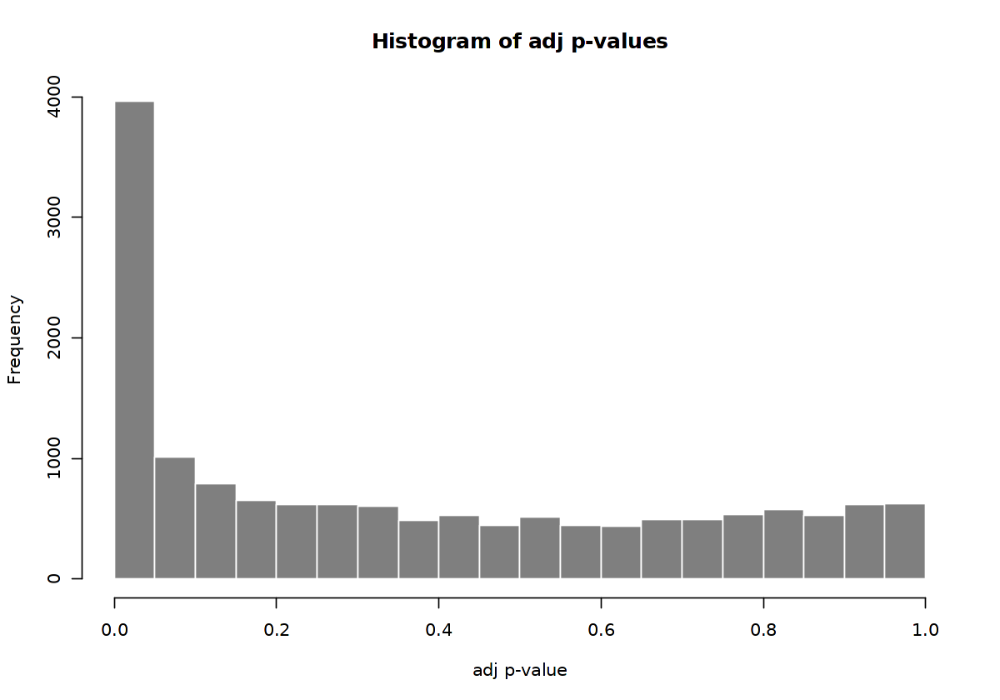

In [267]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

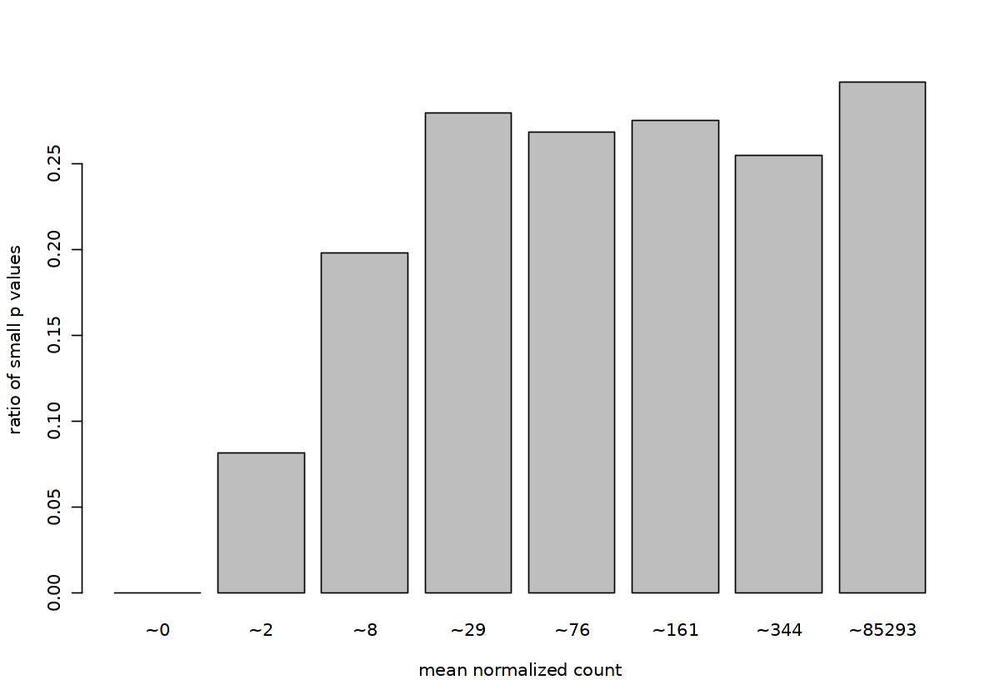

In [268]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

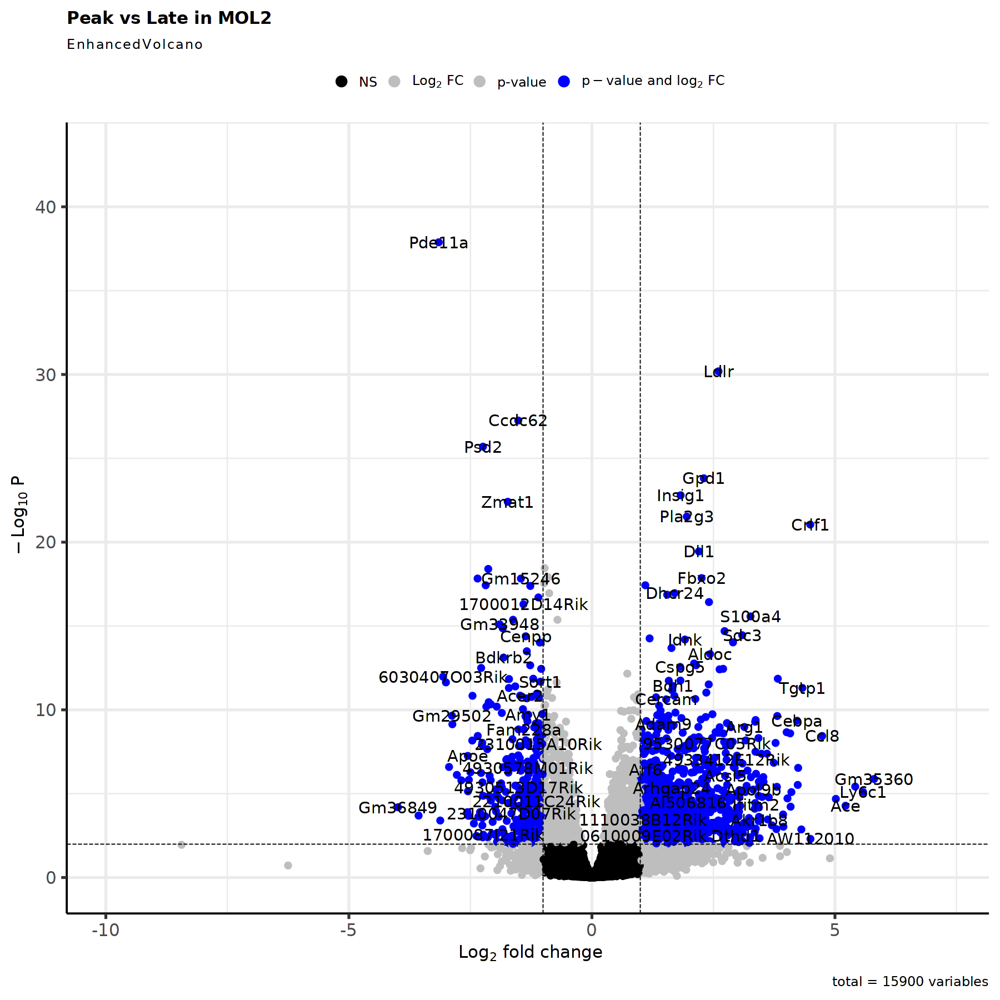

In [269]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [270]:
res <- res[complete.cases(res$padj),]

In [271]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [272]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Peak vs Late 
Wald test p-value: group_id Peak vs Late 
DataFrame with 1140 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Gm35360   2.29611        5.80514   1.05820   5.48586 4.11460e-08 1.32758e-06
Ly6c1    35.66434        5.57865   1.09351   5.10158 3.36828e-07 7.92870e-06
Ly6a    117.69624        5.41693   1.02856   5.26651 1.39044e-07 3.77792e-06
Ace       1.46631        5.21761   1.11864   4.66422 3.09784e-06 5.27021e-05
Gm41148   4.59624        5.01810   1.02689   4.88667 1.02554e-06 2.04985e-05
...           ...            ...       ...       ...         ...         ...
Nod1     189.3136        1.00189  0.181874   5.50872 3.61446e-08 1.17891e-06
Maged2    70.9871       -1.00179  0.284671  -3.51913 4.32962e-04 3.27864e-03
Gm38948   31.6681        1.00174  0.304380   3.29106 9.98091e-04 6.46299e-03
Lctl      10.3748       -

In [273]:
nrow(res_filtered)

[1] 1140

In [274]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.2.5 Summary

In [275]:
listInput_upset <- HVGs.list[[cluster_choice]]
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

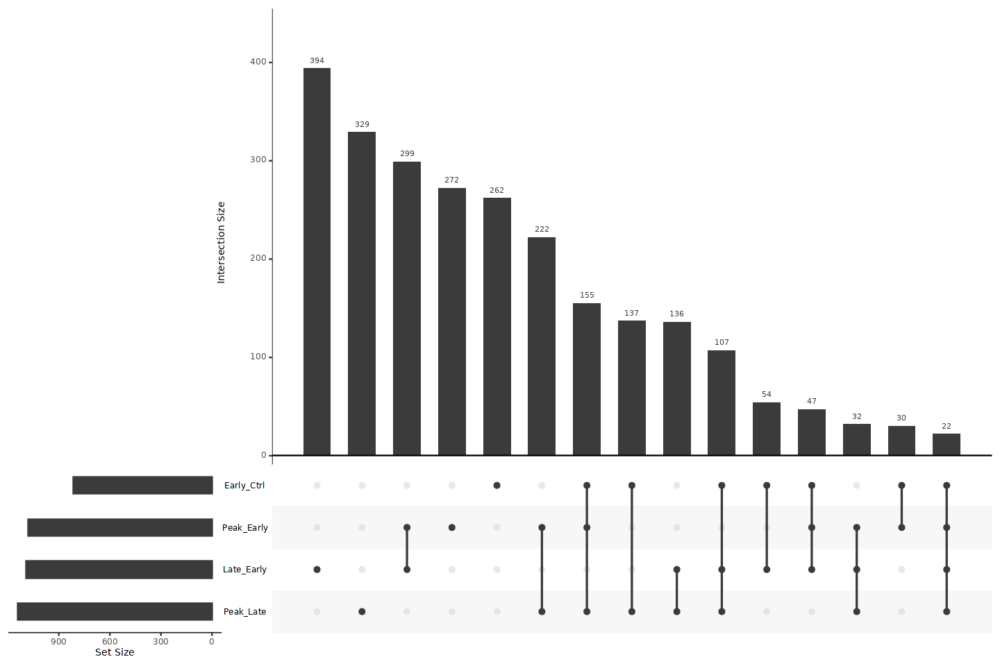

In [276]:
options(repr.plot.width=12, repr.plot.height=8)
upset(fromList(listInput_upset), order.by = "freq")

In [277]:
HVG <- unique(unlist(HVGs.list[[cluster_choice]]))

In [278]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

In [279]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [280]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_merge %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [281]:
DefaultAssay(tmp) <- "RNA"

In [282]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [283]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [284]:
DefaultAssay(tmp) <- "GenePromAcc"

In [285]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [286]:
DefaultAssay(tmp) <- "RNA"

In [287]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)])
tmp$orig.ident_merge <- factor(x = tmp$orig.ident_merge, levels = names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)])

In [288]:
Idents(object = tmp) <- "orig.ident_merge"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


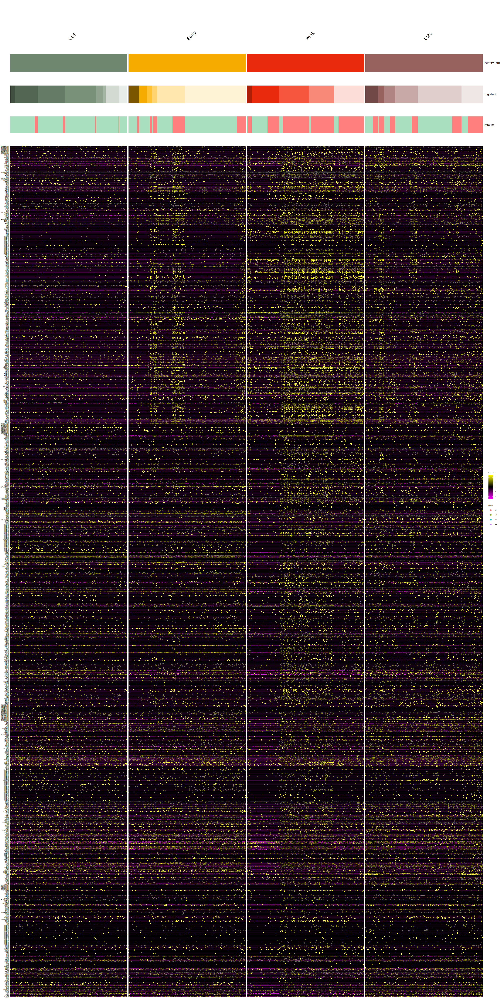

In [289]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVG,
    cells = NULL,
    group.by = "orig.ident_merge",
    additional.group.by = c("orig.ident", "Immune"),
    additional.group.sort.by = c("orig.ident", "Immune"),
    cols.use = list(orig.ident_merge=orig.ident_merge_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 4))

In [290]:
gene_list <- HVG

In [291]:
Idents(object = tmp) <- "orig.ident_merge"

In [292]:
sample_names <- levels(tmp$orig.ident)

In [293]:
tmp_sample_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [294]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, sample_names)))

In [295]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [296]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [297]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [298]:
tmp_sample_markers_GenePromAcc_sub <- as.data.frame(AggregateExpression(tmp, assays = "GenePromAcc", group.by = "orig.ident", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["GenePromAcc"]]$data[gene_list_GenePromAcc,])

  |==========================================================================================| 100%


In [299]:
matrix <- tmp_sample_markers/do.call(pmax, tmp_sample_markers)

In [300]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [301]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

In [302]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [303]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk.pdf"), width=30, height=plot_height)

png 
  2

In [304]:
gene_list <- gene_list[ph$tree_row$order]

In [305]:
tmp_sample_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [306]:
tmp_sample_markers_mean[rownames(tmp_sample_markers),"Mean_Log2Exp"] <- rowMeans(tmp_sample_markers)

In [307]:
matrix <- tmp_sample_markers_mean

In [308]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

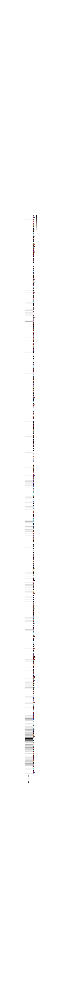

In [309]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [310]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [311]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [312]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

In [313]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [314]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk_zscore.pdf"), width=30, height=plot_height)

png 
  2

In [315]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [316]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [317]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [318]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [319]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [320]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [321]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk.pdf"), width=30, height=plot_height)

png 
  2

In [322]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Acc")))

In [323]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Log2Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [324]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [325]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [326]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

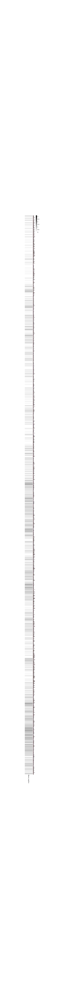

In [327]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [328]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [329]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [330]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [331]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [332]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

In [333]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [334]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk_zscore.pdf"), width=30, height=plot_height)

png 
  2

In [335]:
gene_list <- HVG

In [336]:
sample_names <- levels(tmp$orig.ident_merge)

In [337]:
tmp_sample_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_merge", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [338]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, sample_names)))

In [339]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [340]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [341]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [342]:
tmp_sample_markers_GenePromAcc_sub <- as.data.frame(AggregateExpression(tmp, assays = "GenePromAcc", group.by = "orig.ident_merge", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["GenePromAcc"]]$data[gene_list_GenePromAcc,])

  |==========================================================================================| 100%


In [343]:
matrix <- tmp_sample_markers/do.call(pmax, tmp_sample_markers)

In [344]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [345]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

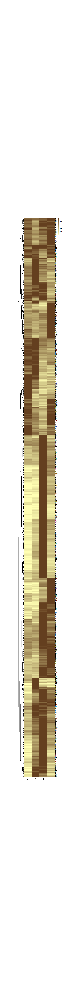

In [346]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [347]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk.pdf"), width=10, height=plot_height)

png 
  2

In [348]:
gene_list <- gene_list[ph$tree_row$order]

In [349]:
tmp_sample_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [350]:
tmp_sample_markers_mean[rownames(tmp_sample_markers),"Mean_Log2Exp"] <- rowMeans(tmp_sample_markers)

In [351]:
matrix <- tmp_sample_markers_mean

In [352]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

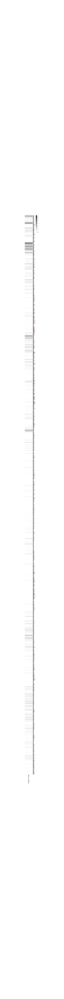

In [353]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [354]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [355]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [356]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

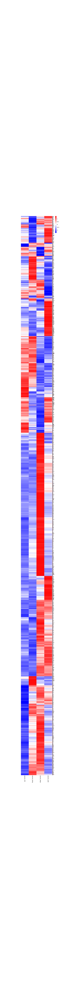

In [357]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [358]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk_zscore.pdf"), width=10, height=plot_height)

png 
  2

In [359]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [360]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [361]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [362]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [363]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

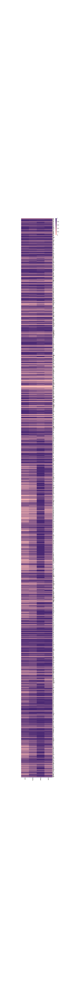

In [364]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [365]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk.pdf"), width=10, height=plot_height)

png 
  2

In [366]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Acc")))

In [367]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Log2Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [368]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [369]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [370]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

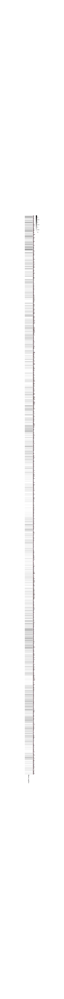

In [371]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [372]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [373]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [374]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [375]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [376]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

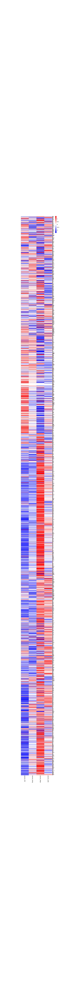

In [377]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [378]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk_zscore.pdf"), width=10, height=plot_height)

png 
  2

#### 3.1.3 OPC

In [379]:
cluster_choice <- "OPC"

In [380]:
HVGs.list[[cluster_choice]] <- list()

In [381]:
table_sample_low <- table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)[cluster_choice,][table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$sample_id)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)]

EarlyCtrl2   EarlyCtrl3    PeakCtrl3 EarlyFemale3 
           1            2            4            1

In [382]:
table_group_low <-table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)[cluster_choice,][table(MORNAATACCOL_sce$cluster_id, MORNAATACCOL_sce$group_id)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)]

named integer(0)

In [383]:
cluster_metadata <- metadata[which(metadata$cluster_id == cluster_choice), ]

# Assign the rownames of the metadata to be the sample IDs
rownames(cluster_metadata) <- cluster_metadata$sample_id

In [385]:
#Remove sample and timepoint with low counts (sample<=5, timepoint<=30)
cluster_metadata <- cluster_metadata[(cluster_metadata$sample_id %in% sample_keep & cluster_metadata$group_id %in% group_keep),]

new_group_levels <- levels(cluster_metadata$group_id)[levels(cluster_metadata$group_id) %in% group_keep]
cluster_metadata$group_id <- droplevels(cluster_metadata$group_id)
levels(cluster_metadata$group_id) <- new_group_levels

In [386]:
# Subset the counts to only this cluster
counts <- pb[[cluster_choice]]

cluster_counts <- data.frame(counts[, which(colnames(counts) %in% rownames(cluster_metadata))])

# Check that all of the row names of the metadata are the same and in the same order as the column names of the counts in order to use as input to DESeq2
all(rownames(cluster_metadata) == colnames(cluster_counts))

[1] TRUE

In [387]:
dds <- DESeqDataSetFromMatrix(cluster_counts, colData = cluster_metadata, design = ~ group_id + debris_id)

converting counts to integer mode

Warning message in DESeqDataSet(se, design = design, ignoreRank):
"some variables in design formula are characters, converting to factors"


In [388]:
# Transform counts for data visualization
rld <- rlog(dds, blind=TRUE)

using ntop=500 top features by variance



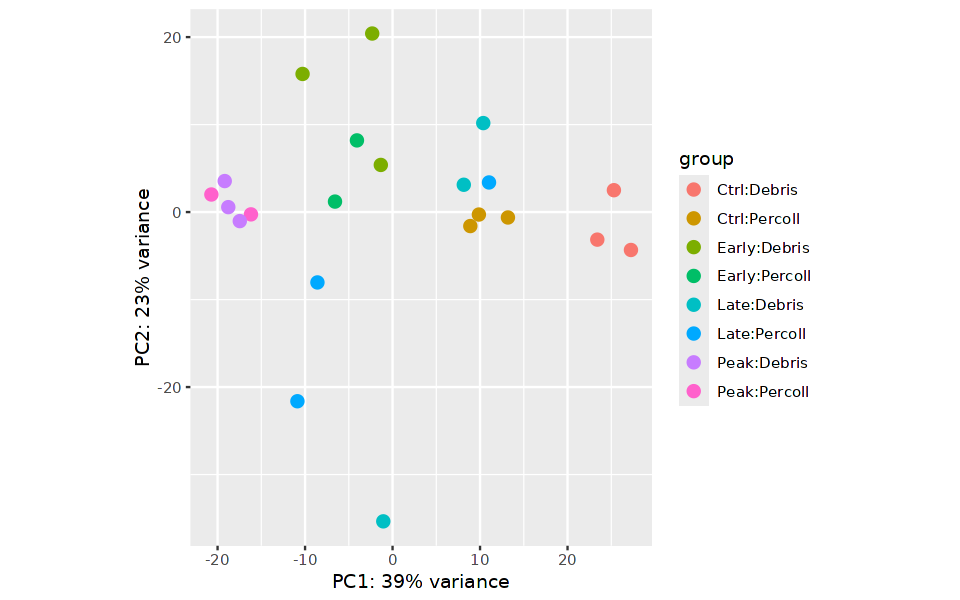

In [389]:
# Plot PCA
options(repr.plot.width=8, repr.plot.height=5)
DESeq2::plotPCA(rld, intgroup = c("group_id", "debris_id"))

In [390]:
# Extract the rlog matrix from the object and compute pairwise correlation values
rld_mat <- assay(rld)
rld_cor <- cor(rld_mat)

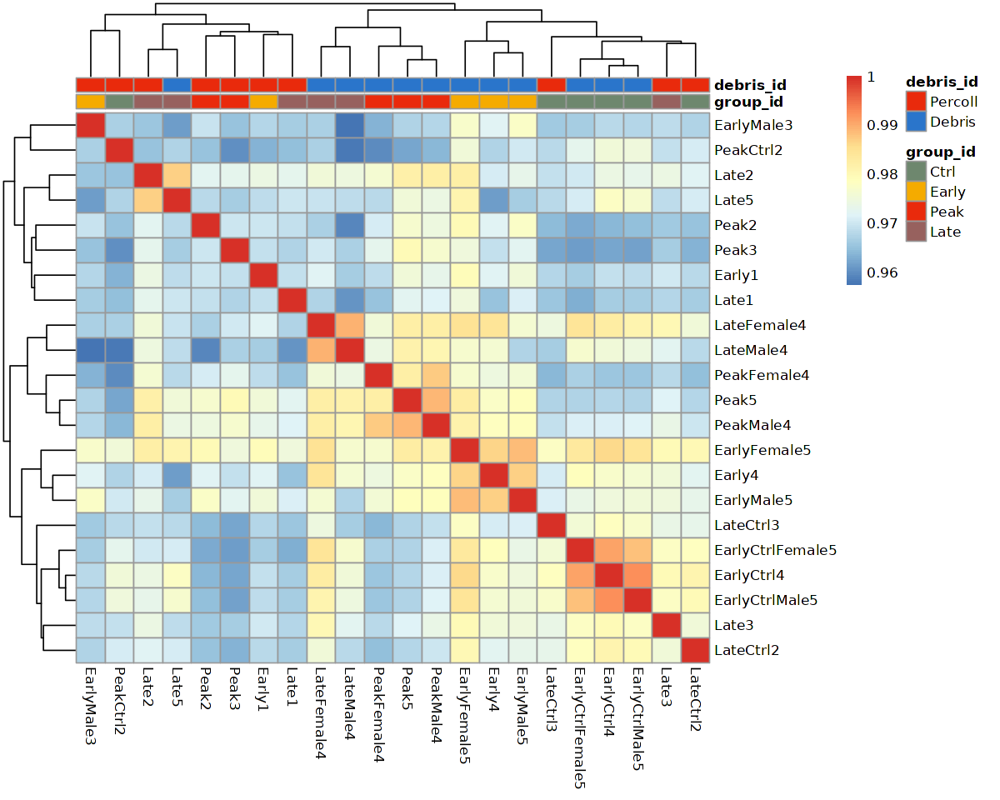

In [391]:
# Plot heatmap
options(repr.plot.width=10, repr.plot.height=8)
pheatmap(rld_cor, annotation = cluster_metadata[, c("group_id","debris_id"), drop=F], annotation_colors = list(group_id=orig.ident_merge_colors, debris_id=debris_colors))

In [392]:
# Run DESeq2 differential expression analysis
dds <- DESeq(dds)

estimating size factors

estimating dispersions

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



In [393]:
libsize = data.frame(x=sizeFactors(dds), y=colSums(assay(dds)))

`geom_smooth()` using formula = 'y ~ x'


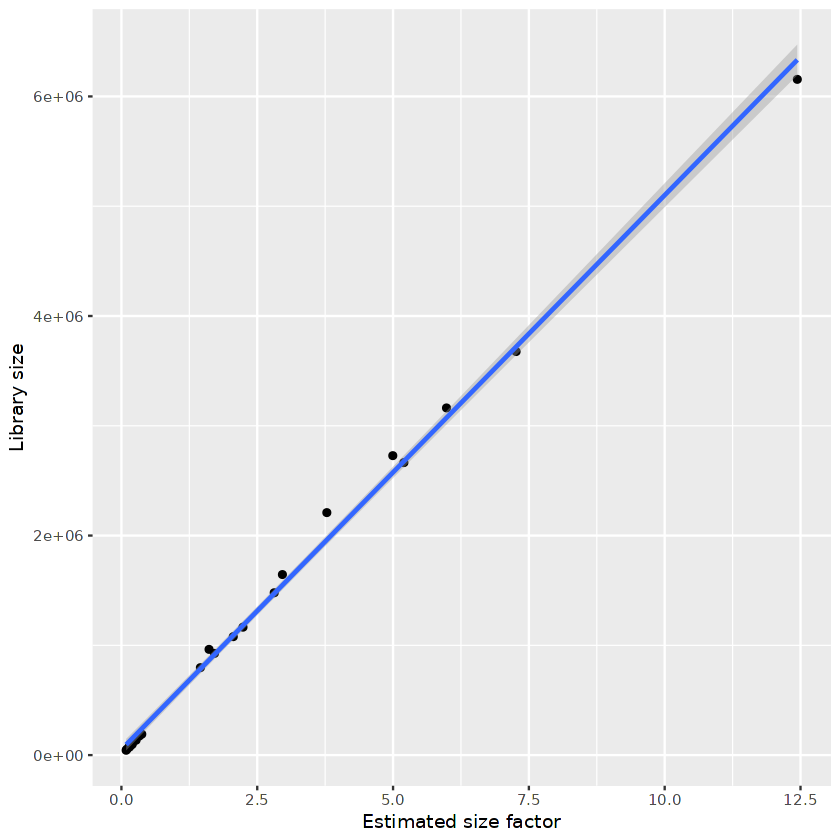

In [394]:
options(repr.plot.width=7, repr.plot.height=7)
ggplot(data=libsize, aes(x=x, y=y)) + geom_point() + geom_smooth(method="lm") + xlab("Estimated size factor") + ylab("Library size")

In [395]:
data.frame(colData(dds))

,cluster_id,sample_id,group_id,debris_id,sizeFactor
,<chr>,<chr>,<fct>,<fct>,<dbl>
Early1,OPC,Early1,Early,Percoll,0.20116039
Early4,OPC,Early4,Early,Debris,1.45354858
EarlyCtrl4,OPC,EarlyCtrl4,Ctrl,Debris,5.19937665
EarlyCtrlFemale5,OPC,EarlyCtrlFemale5,Ctrl,Debris,1.71314759
EarlyCtrlMale5,OPC,EarlyCtrlMale5,Ctrl,Debris,2.05882098
EarlyFemale5,OPC,EarlyFemale5,Early,Debris,7.26464875
EarlyMale3,OPC,EarlyMale3,Early,Percoll,0.08693773
EarlyMale5,OPC,EarlyMale5,Early,Debris,2.81266530
Late1,OPC,Late1,Late,Percoll,0.14897336


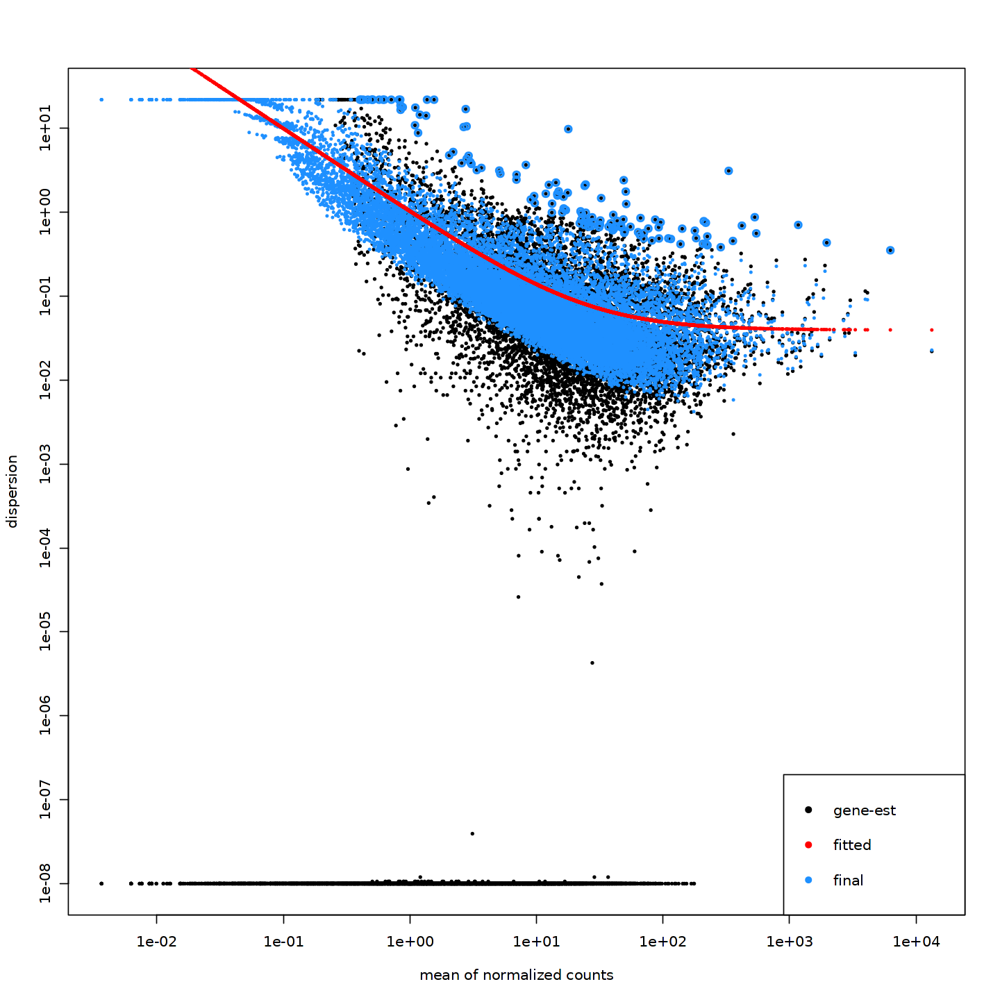

In [396]:
# Plot dispersion estimates
options(repr.plot.width=12, repr.plot.height=12)
plotDispEsts(dds)

##### 3.1.3.1 Early/Ctrl

In [397]:
condition1 = "Early"
condition2 = "Ctrl"

In [398]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [399]:
summary(res)


out of 15880 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 442, 2.8%
LFC < 0 (down)     : 225, 1.4%
outliers [1]       : 11, 0.069%
low counts [2]     : 3074, 19%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



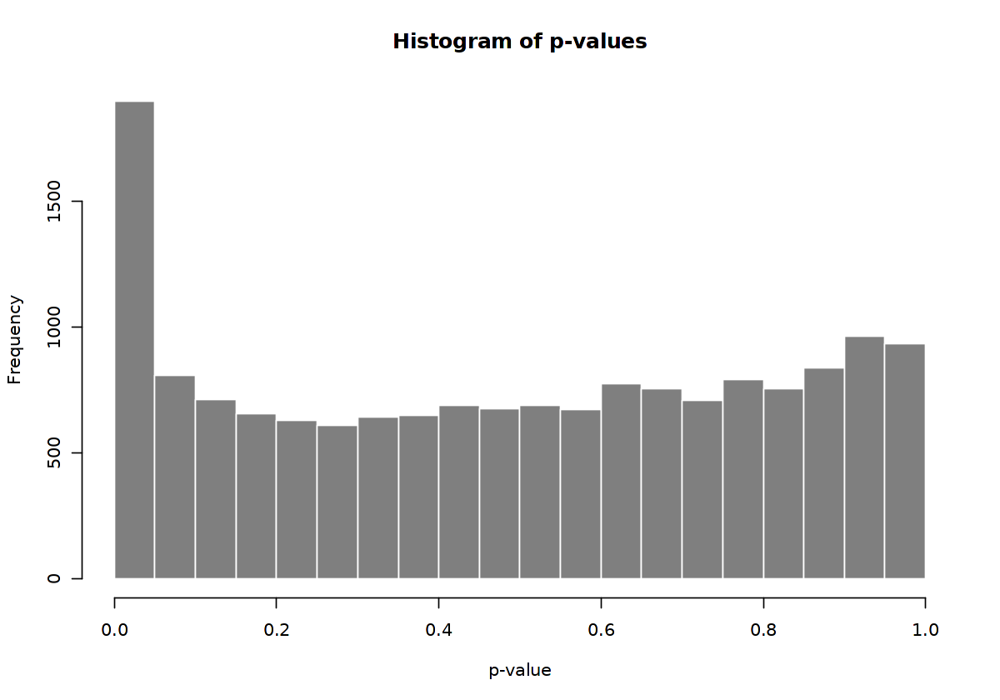

In [400]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

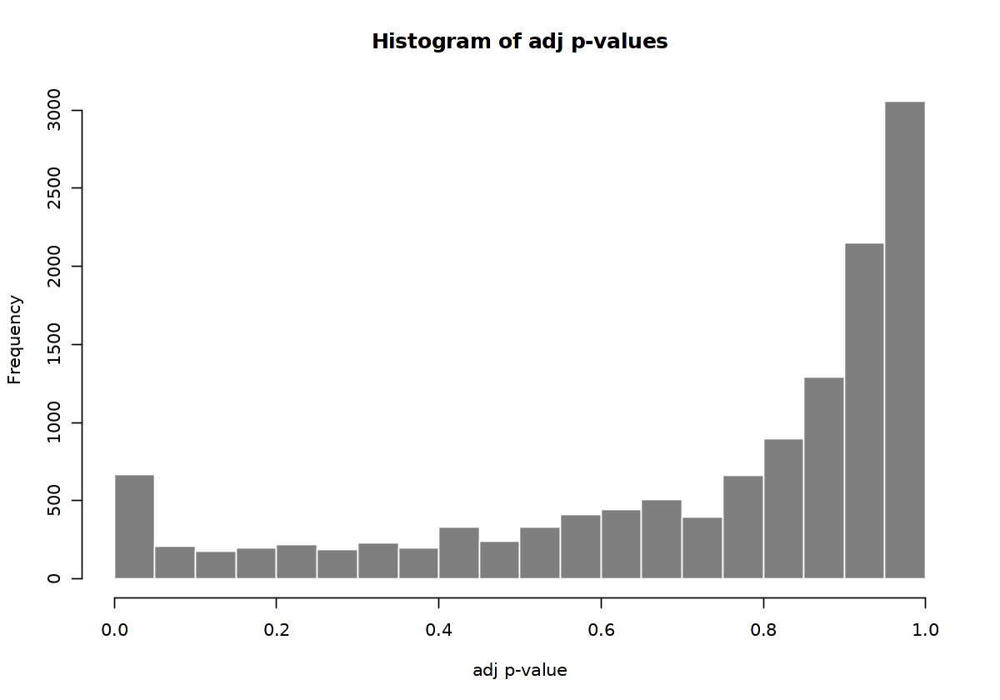

In [401]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

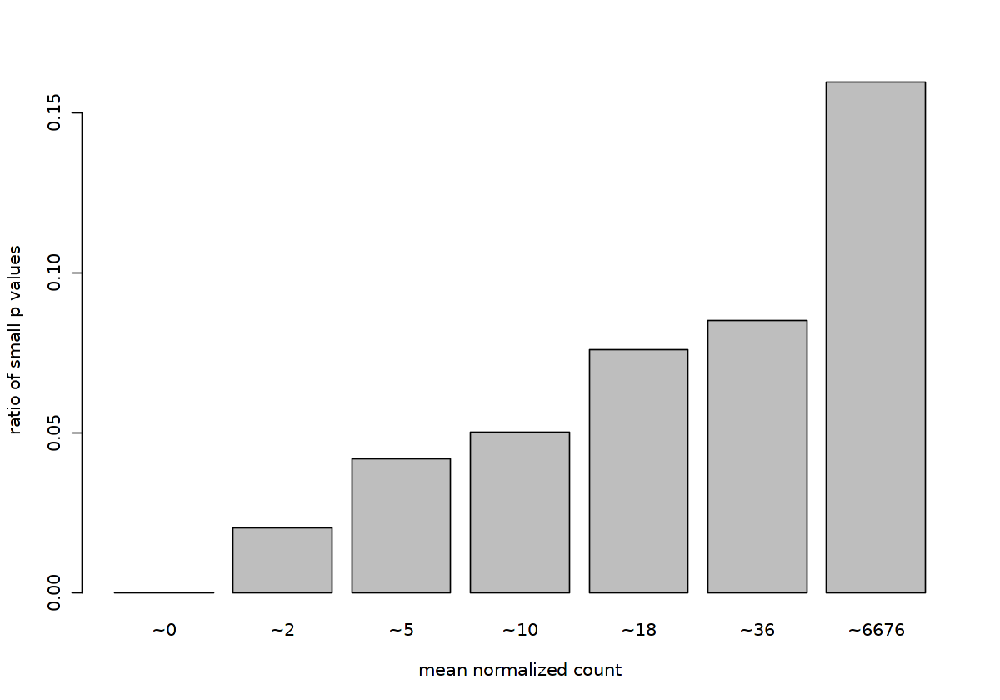

In [402]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

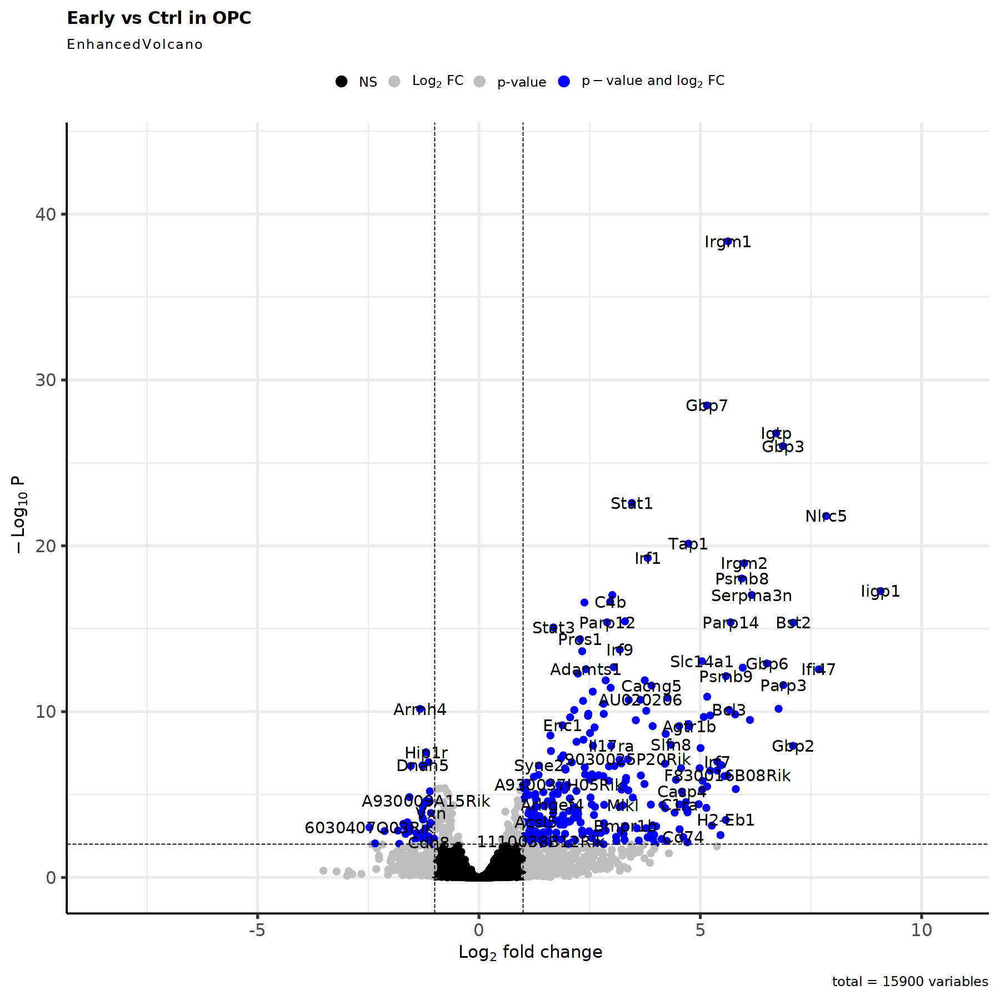

In [403]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [404]:
res <- res[complete.cases(res$padj),]

In [405]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [406]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Early vs Ctrl 
Wald test p-value: group id Early vs Ctrl 
DataFrame with 323 rows and 6 columns
        baseMean log2FoldChange     lfcSE      stat      pvalue        padj
       <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Iigp1   115.3399        9.07391  0.963472   9.41793 4.60069e-21 5.35144e-18
Nlrc5    58.6553        7.84408  0.746092  10.51354 7.48272e-26 1.59569e-22
Ifi47    23.4083        7.67602  0.949749   8.08215 6.36330e-16 2.80753e-13
Bst2     41.4605        7.09964  0.799113   8.88440 6.42651e-19 4.32775e-16
Gbp2     27.8385        7.09342  1.085644   6.53384 6.41058e-11 1.14528e-08
...          ...            ...       ...       ...         ...         ...
Ptn     414.3441       -1.01443  0.276236  -3.67232 2.40358e-04 7.90587e-03
Dab2     23.3687       -1.01392  0.271076  -3.74036 1.83755e-04 6.28650e-03
Prtg     14.3497       -1.01153  0.267905  -3.77572 1.59548e-04 5.54735e-03
Rps12   191.0389        1.01024  0.

In [407]:
nrow(res_filtered)

[1] 323

In [408]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.3.2 Peak/Early

In [409]:
condition1 = "Peak"
condition2 = "Early"

In [410]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [411]:
summary(res)


out of 15880 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 347, 2.2%
LFC < 0 (down)     : 253, 1.6%
outliers [1]       : 11, 0.069%
low counts [2]     : 5227, 33%
(mean count < 4)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



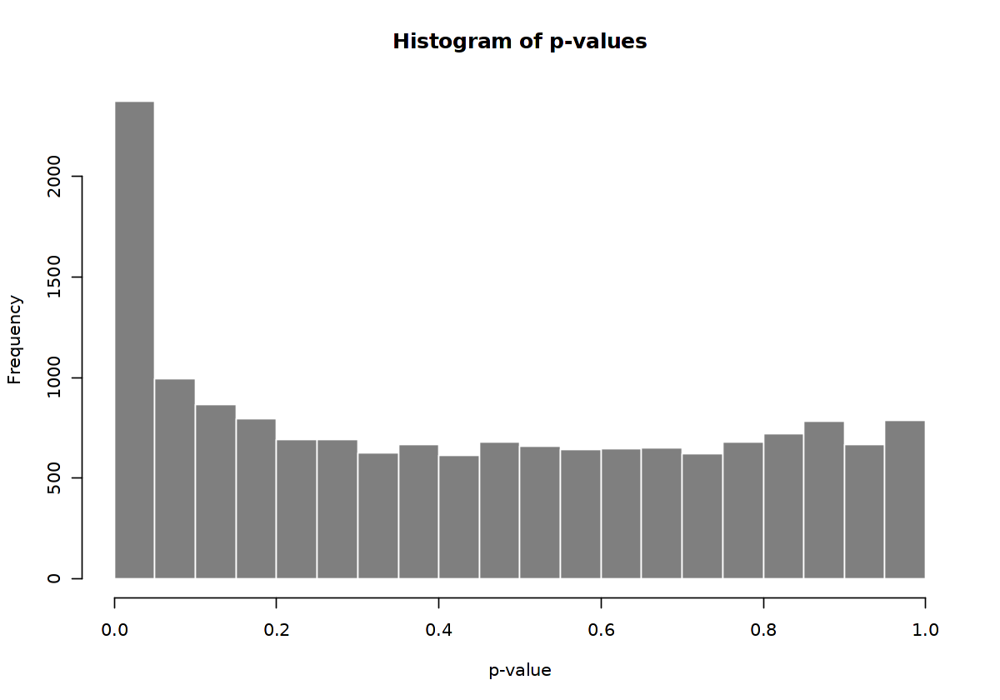

In [412]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

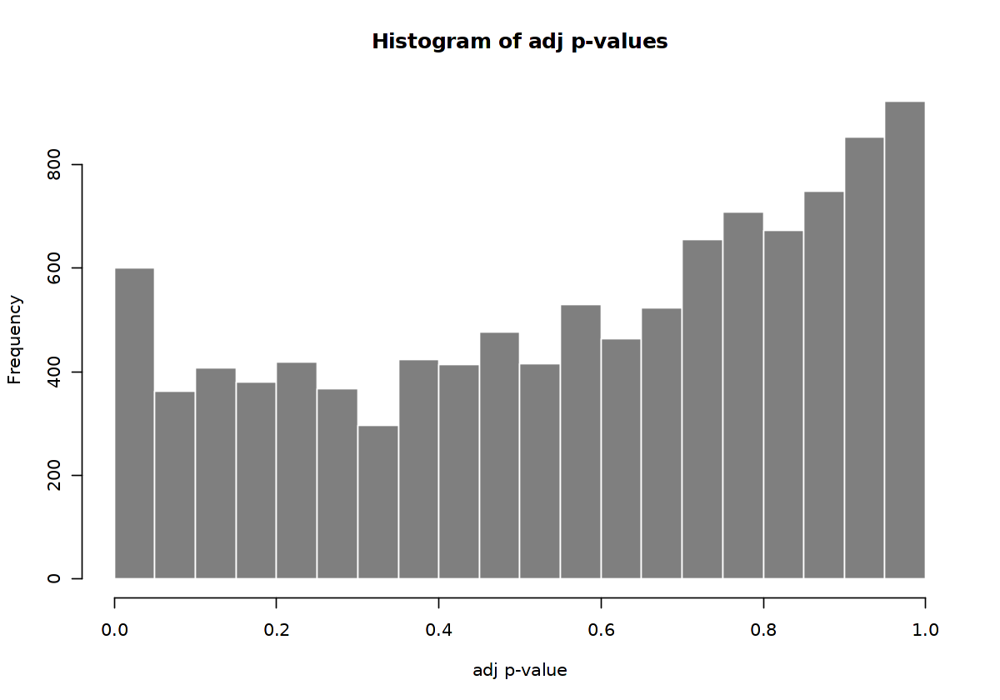

In [413]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

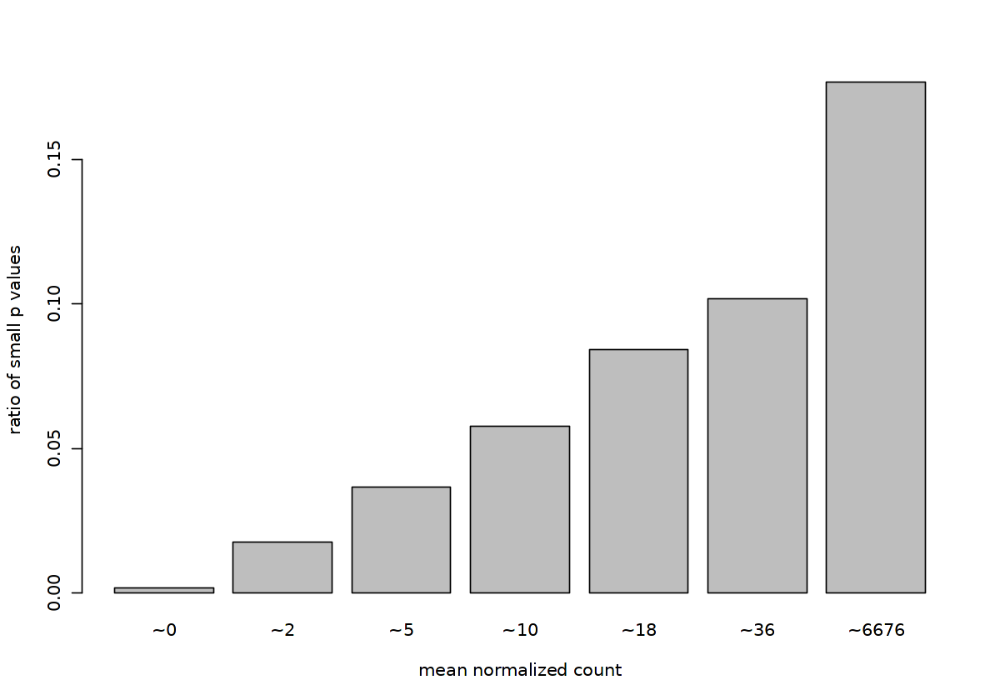

In [414]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

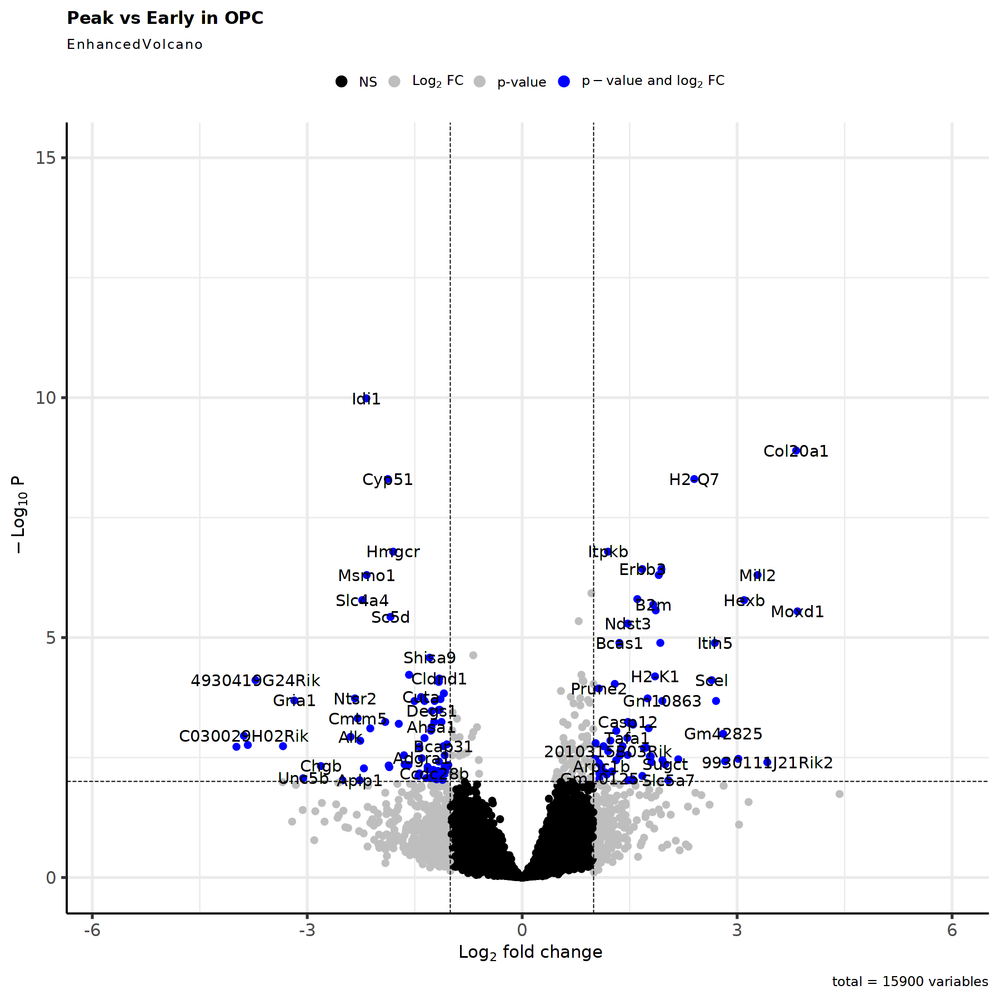

In [415]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [416]:
res <- res[complete.cases(res$padj),]

In [417]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [418]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Peak vs Early 
Wald test p-value: group_id Peak vs Early 
DataFrame with 137 rows and 6 columns
               baseMean log2FoldChange     lfcSE      stat      pvalue        padj
              <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Tac1            9.97679       -3.98849  0.935253  -4.26461 2.00252e-05 1.88592e-03
C030029H02Rik  17.27589       -3.88406  0.874284  -4.44256 8.88950e-06 1.11297e-03
Moxd1          12.88223        3.84270  0.656455   5.85372 4.80701e-09 2.84201e-06
Itih3           4.04303       -3.82962  0.890201  -4.30198 1.69281e-05 1.73220e-03
Col20a1        32.53824        3.82386  0.521997   7.32545 2.38106e-13 1.26696e-09
...                 ...            ...       ...       ...         ...         ...
Dctn3           28.8394       -1.03259  0.266995  -3.86745 1.09981e-04  0.00619270
Sys1            40.4040       -1.03122  0.259660  -3.97142 7.14454e-05  0.00453654
Tnk2            18.2652        1.02567  0

In [419]:
nrow(res_filtered)

[1] 137

In [420]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.3.3 Late/Early

In [421]:
condition1 = "Late"
condition2 = "Early"

In [422]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [423]:
summary(res)


out of 15880 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 288, 1.8%
LFC < 0 (down)     : 458, 2.9%
outliers [1]       : 11, 0.069%
low counts [2]     : 3074, 19%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



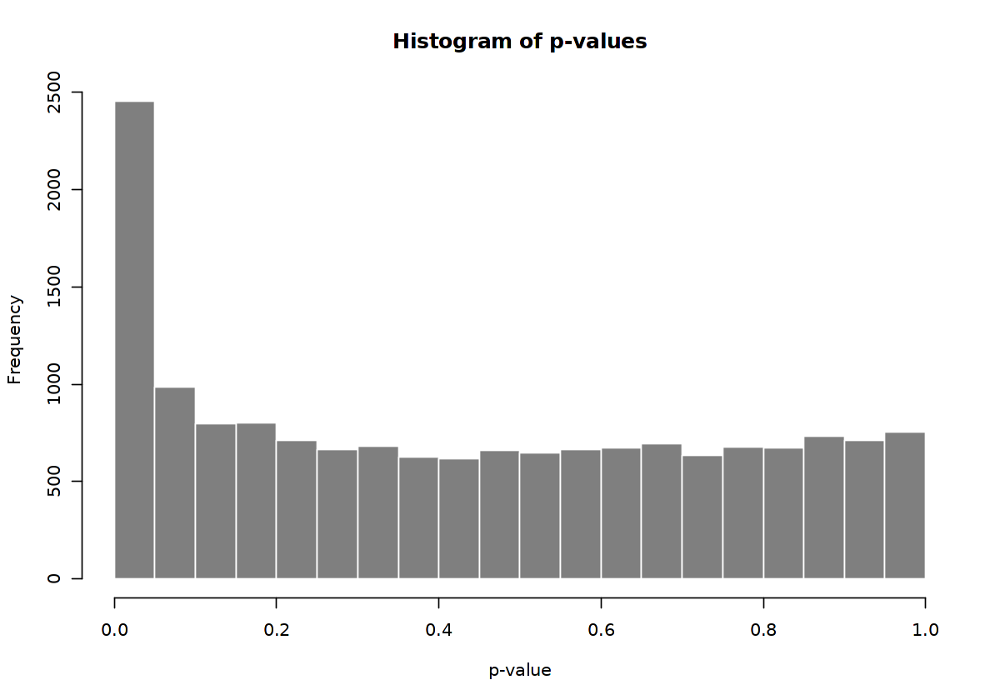

In [424]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

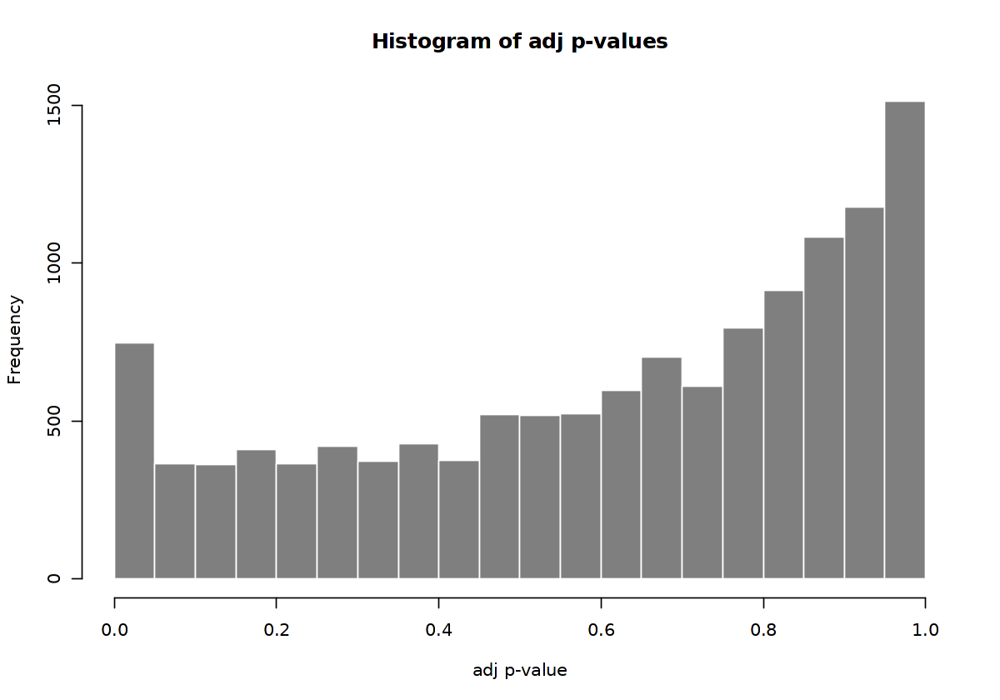

In [425]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

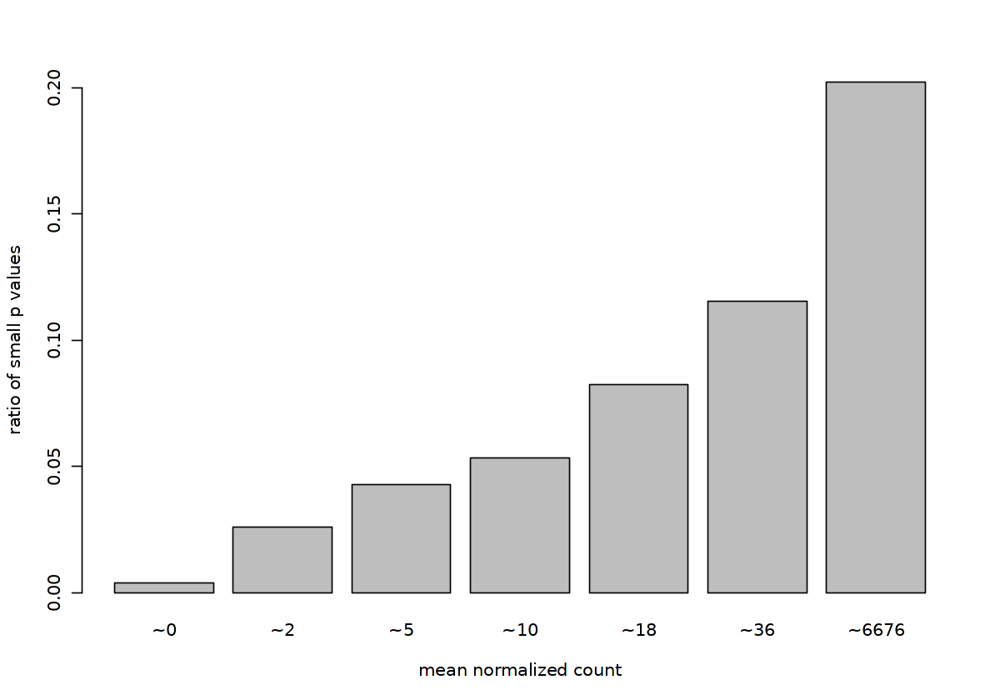

In [426]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

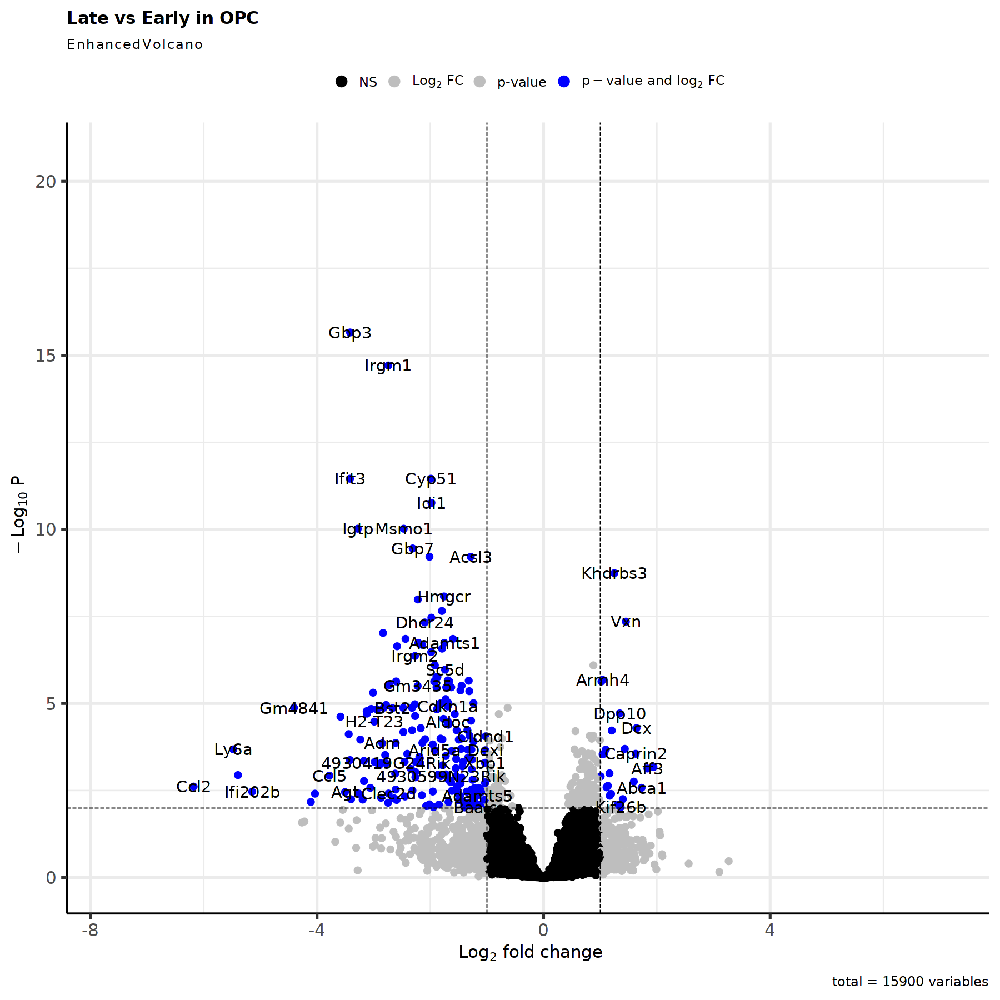

In [427]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [428]:
res <- res[complete.cases(res$padj),]

In [429]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [430]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Late vs Early 
Wald test p-value: group_id Late vs Early 
DataFrame with 220 rows and 6 columns
         baseMean log2FoldChange     lfcSE      stat      pvalue        padj
        <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Ccl2      6.94083       -6.17888  1.507237  -4.09947 4.14092e-05 2.44162e-03
Ly6a     13.22869       -5.47783  1.147799  -4.77247 1.81982e-06 2.08505e-04
Gm3417   17.65955       -5.39581  1.250922  -4.31346 1.60717e-05 1.14243e-03
Ifi202b   2.15116       -5.14492  1.288351  -3.99341 6.51291e-05 3.42933e-03
Gm4841    3.73616       -4.40712  0.814703  -5.40948 6.32074e-08 1.33525e-05
...           ...            ...       ...       ...         ...         ...
Dexi      21.9730       -1.03009  0.216785  -4.75165 2.01767e-06 2.20651e-04
Ogfr      18.4121       -1.02977  0.246257  -4.18170 2.89338e-05 1.84183e-03
Cldnd1    45.4132       -1.02553  0.205901  -4.98070 6.33546e-07 8.81111e-05
Mpped2   108.1816       

In [431]:
nrow(res_filtered)

[1] 220

In [432]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.3.4 Peak/Late

In [433]:
condition1 = "Peak"
condition2 = "Late"

In [434]:
contrast <- c("group_id", condition1, condition2)

# resultsNames(dds)
res <- results(dds, contrast = contrast, alpha = 0.05)

In [435]:
summary(res)


out of 15880 with nonzero total read count
adjusted p-value < 0.05
LFC > 0 (up)       : 350, 2.2%
LFC < 0 (down)     : 154, 0.97%
outliers [1]       : 11, 0.069%
low counts [2]     : 1846, 12%
(mean count < 1)
[1] see 'cooksCutoff' argument of ?results
[2] see 'independentFiltering' argument of ?results



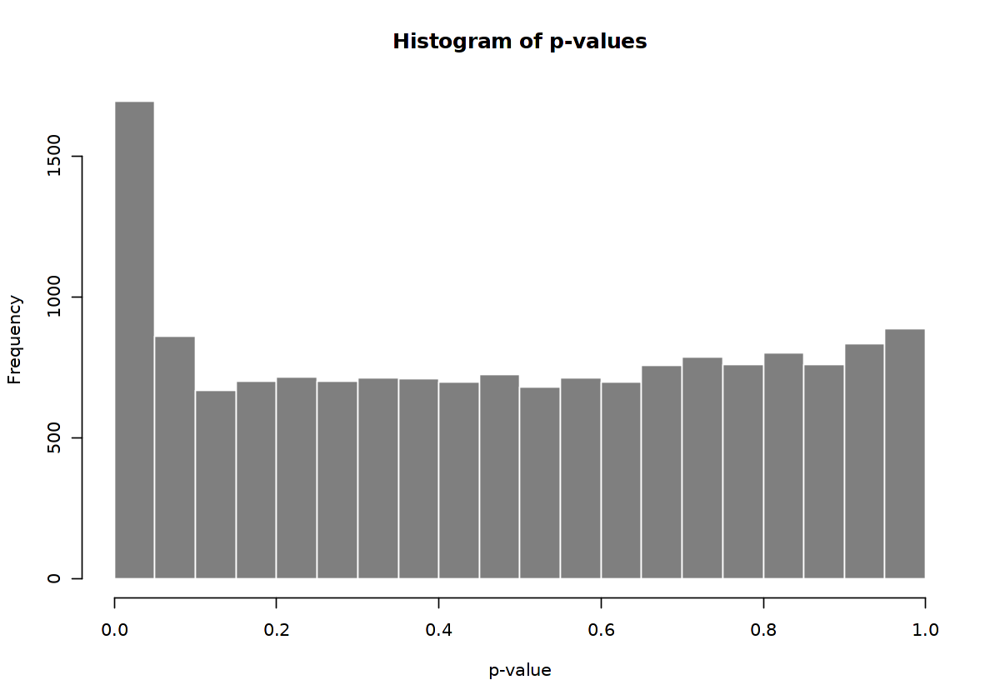

In [436]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$pvalue, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of p-values", xlab="p-value")

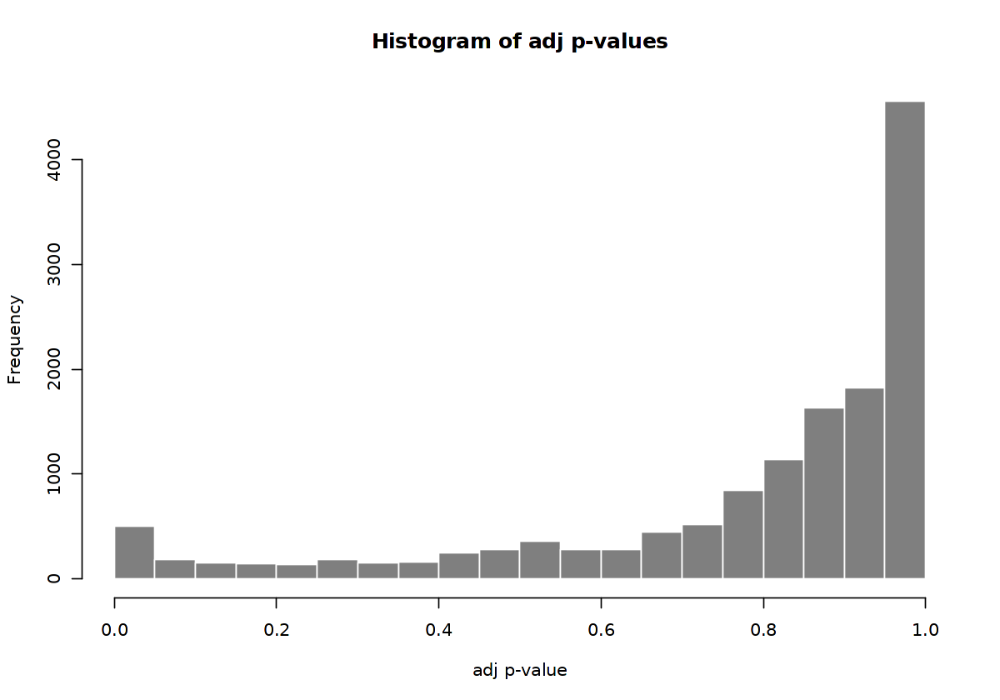

In [437]:
options(repr.plot.width=10, repr.plot.height=7)
hist(res$padj, breaks=0:20/20, col="grey50", border="white", xlim=c(0,1), main="Histogram of adj p-values", xlab="adj p-value")

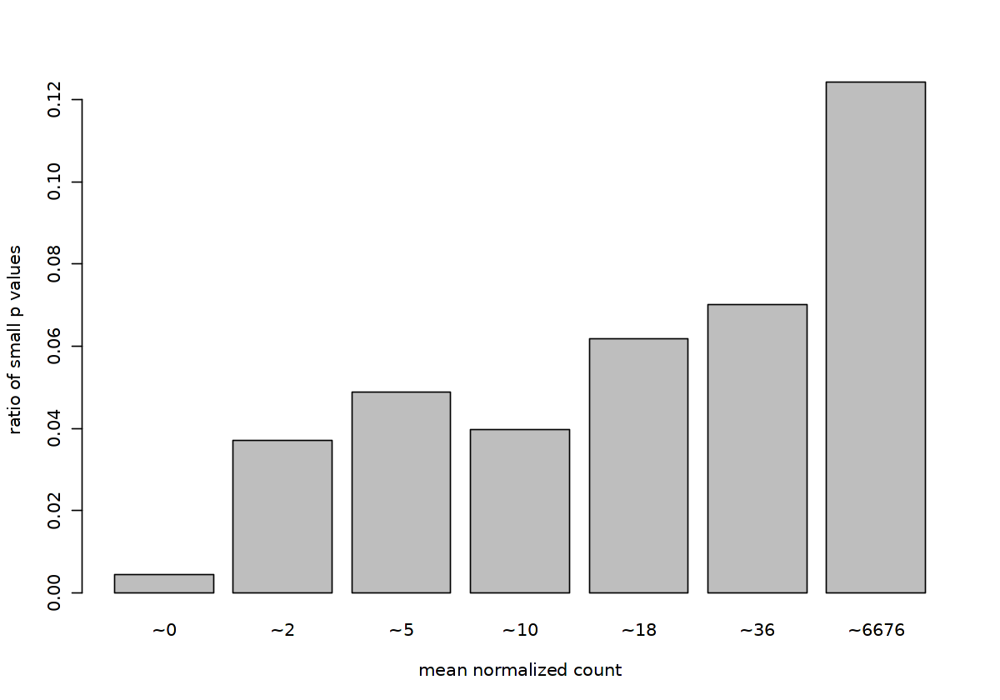

In [438]:
options(repr.plot.width=10, repr.plot.height=7)
qs <- c(0, quantile(res$baseMean[res$baseMean > 0], 0:7/7))
# cut the genes into the bins
bins <- cut(res$baseMean, qs)
# rename the levels of the bins using the middle point
levels(bins) <- paste0("~",round(.5*qs[-1] + .5*qs[-length(qs)]))
# calculate the ratio of $p$ values less than .01 for each bin
ratios <- tapply(res$pvalue, bins, function(p) mean(p < .01, na.rm=TRUE))
# plot these ratios
barplot(ratios, xlab="mean normalized count", ylab="ratio of small p values")

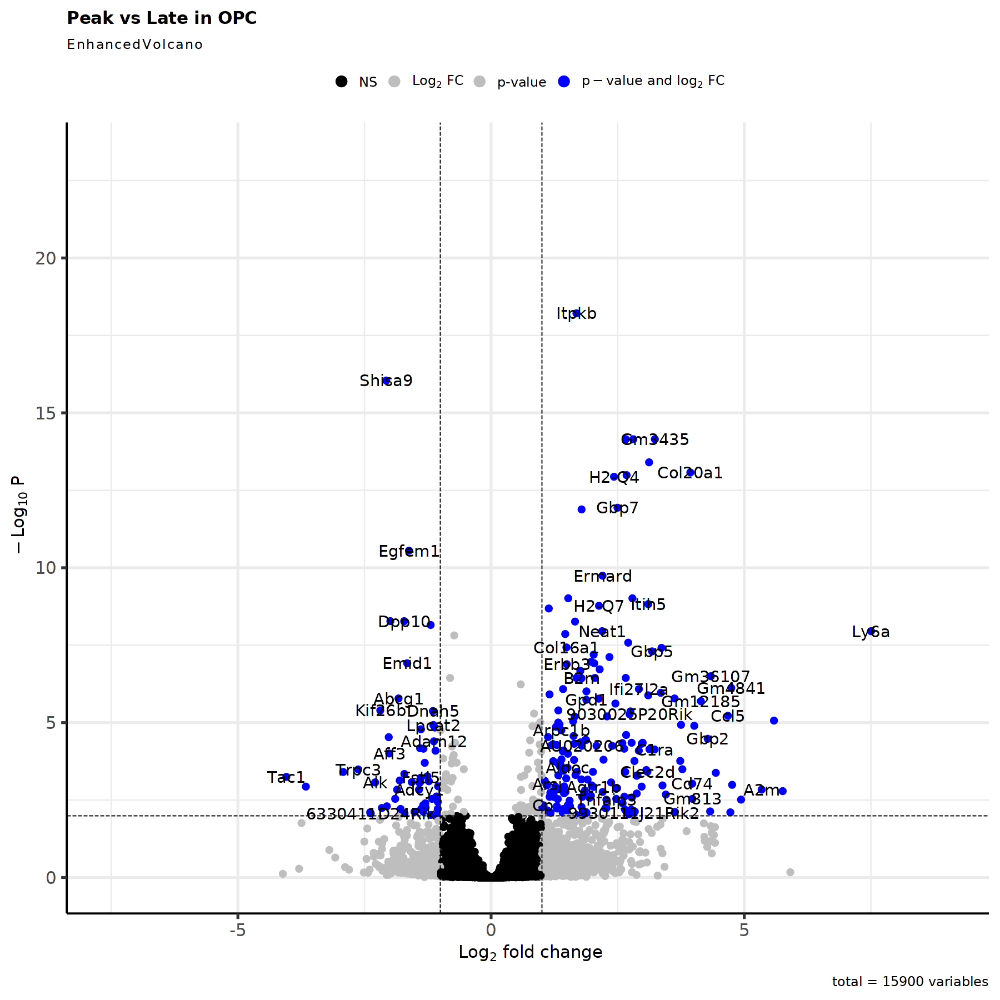

In [439]:
options(repr.plot.width=15, repr.plot.height=15)
#padj<0.001
EnhancedVolcano(res,
    lab = rownames(res),
    x = 'log2FoldChange',
    y = 'padj',
    title = paste0(condition1,' vs ',condition2,' in ', cluster_choice),
    pCutoff = 0.01,
    FCcutoff = 1,
    pointSize = 3.0,
    labSize = 6.0,
    col=c('black', 'grey', 'grey', 'blue'),
    colAlpha = 1)

In [440]:
res <- res[complete.cases(res$padj),]

In [441]:
res_filtered <- res[(res$padj < 0.01 & abs(res$log2FoldChange) > 1 & res$baseMean > 1),]

In [442]:
res_filtered[order(abs(res_filtered$log2FoldChange), decreasing=TRUE),]

log2 fold change (MLE): group_id Peak vs Late 
Wald test p-value: group_id Peak vs Late 
DataFrame with 240 rows and 6 columns
           baseMean log2FoldChange     lfcSE      stat      pvalue        padj
          <numeric>      <numeric> <numeric> <numeric>   <numeric>   <numeric>
Ly6a       13.22869        7.50343   1.11780   6.71266 1.91114e-11 1.11666e-08
Gbp10       1.05640        5.75844   1.36183   4.22848 2.35281e-05 1.62529e-03
Gm48972     1.70147        5.58611   1.01866   5.48377 4.16367e-08 8.58635e-06
A2m         2.24412        5.34281   1.25339   4.26268 2.01991e-05 1.45257e-03
Serpina3i   1.09982        4.93614   1.21649   4.05769 4.95601e-05 3.05390e-03
...             ...            ...       ...       ...         ...         ...
Myrip       12.6354       -1.05206  0.262051  -4.01470 5.95210e-05  0.00359769
Nrp2        15.0493       -1.04604  0.241646  -4.32882 1.49908e-05  0.00113630
Trafd1      36.3563        1.03535  0.262453   3.94489 7.98377e-05  0.00467209
Cp  

In [443]:
nrow(res_filtered)

[1] 240

In [444]:
HVGs.list[[cluster_choice]][[paste0(condition1,"_",condition2)]] <- rownames(res_filtered)

##### 3.1.3.5 Summary

In [445]:
listInput_upset <- HVGs.list[[cluster_choice]]
listInput_upset[sapply(listInput_upset, is.null)] <- NULL

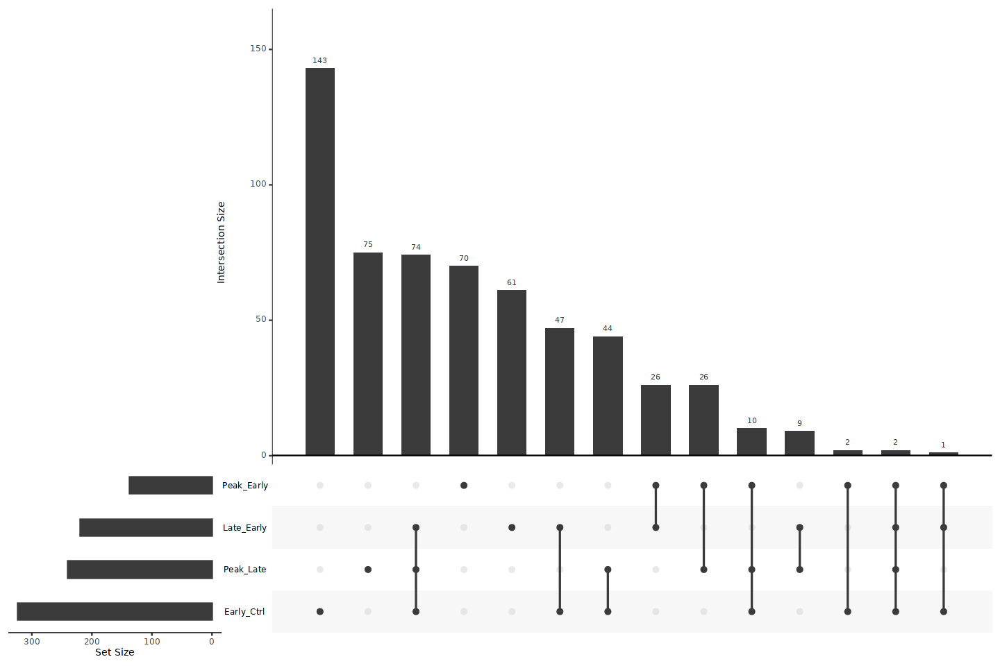

In [446]:
options(repr.plot.width=12, repr.plot.height=8)
upset(fromList(listInput_upset), order.by = "freq")

In [447]:
HVG <- unique(unlist(HVGs.list[[cluster_choice]]))

In [448]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

In [449]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [450]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_merge %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [451]:
DefaultAssay(tmp) <- "RNA"

In [452]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [453]:
tmp <- ScaleData(tmp, features=rownames(tmp))

Centering and scaling data matrix

  |==========================================================================================| 100%


In [454]:
DefaultAssay(tmp) <- "GenePromAcc"

In [455]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [456]:
DefaultAssay(tmp) <- "RNA"

In [457]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)])
tmp$orig.ident_merge <- factor(x = tmp$orig.ident_merge, levels = names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)])

In [458]:
Idents(object = tmp) <- "orig.ident_merge"

Warning message:
"CombinePlots is being deprecated. Plots should now be combined using the patchwork system."


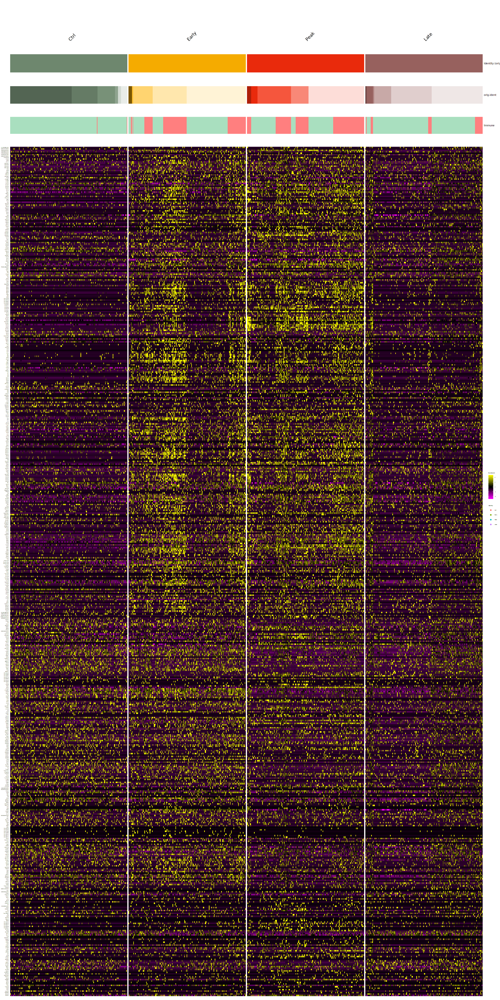

In [459]:
options(repr.plot.width=25, repr.plot.height=50)
DoMultiBarHeatmap(
    subset(tmp, downsample = 200),
    features = HVG,
    cells = NULL,
    group.by = "orig.ident_merge",
    additional.group.by = c("orig.ident", "Immune"),
    additional.group.sort.by = c("orig.ident", "Immune"),
    cols.use = list(orig.ident_merge=orig.ident_merge_colors, orig.ident=orig.ident_colors, Immune=immune_colors),
    group.bar = TRUE,
    disp.min = -2.5,
    disp.max = NULL,
    layer = "scale.data",
    assay = "RNA",
    label = TRUE,
    size = 5.5,
    hjust = 0,
    angle = 45,
    raster = TRUE,
    draw.lines = TRUE,
    lines.width = NULL,
    group.bar.height = 0.02,
    combine = TRUE
    ) + theme(text = element_text(size = 4))

In [460]:
gene_list <- HVG

In [461]:
Idents(object = tmp) <- "orig.ident_merge"

In [462]:
sample_names <- levels(tmp$orig.ident)

In [463]:
tmp_sample_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [464]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, sample_names)))

In [465]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [466]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [467]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [468]:
tmp_sample_markers_GenePromAcc_sub <- as.data.frame(AggregateExpression(tmp, assays = "GenePromAcc", group.by = "orig.ident", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["GenePromAcc"]]$data[gene_list_GenePromAcc,])

  |==========================================================================================| 100%


In [469]:
matrix <- tmp_sample_markers/do.call(pmax, tmp_sample_markers)

In [470]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [471]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

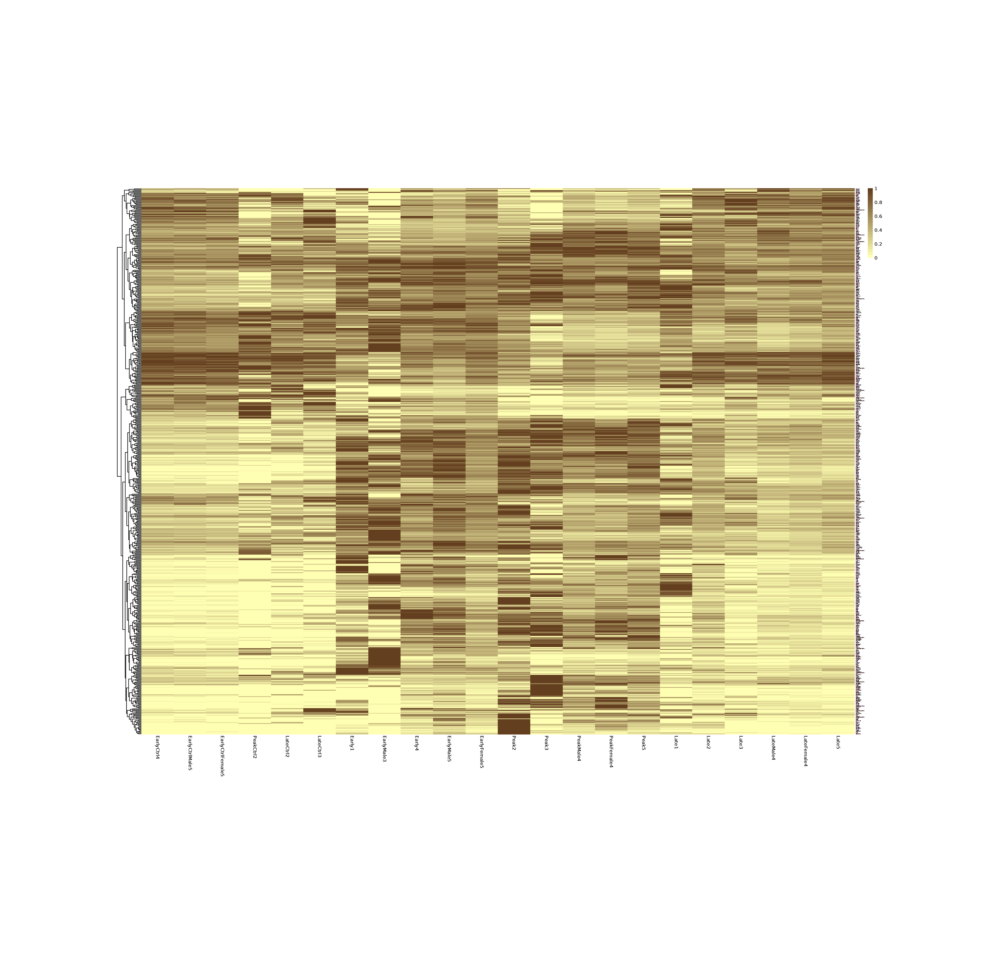

In [472]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [473]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk.pdf"), width=30, height=plot_height)

png 
  2

In [474]:
gene_list <- gene_list[ph$tree_row$order]

In [475]:
tmp_sample_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [476]:
tmp_sample_markers_mean[rownames(tmp_sample_markers),"Mean_Log2Exp"] <- rowMeans(tmp_sample_markers)

In [477]:
matrix <- tmp_sample_markers_mean

In [478]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

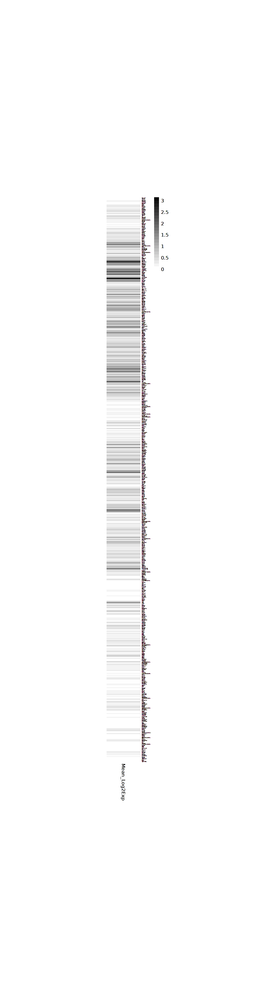

In [479]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [480]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [481]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [482]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

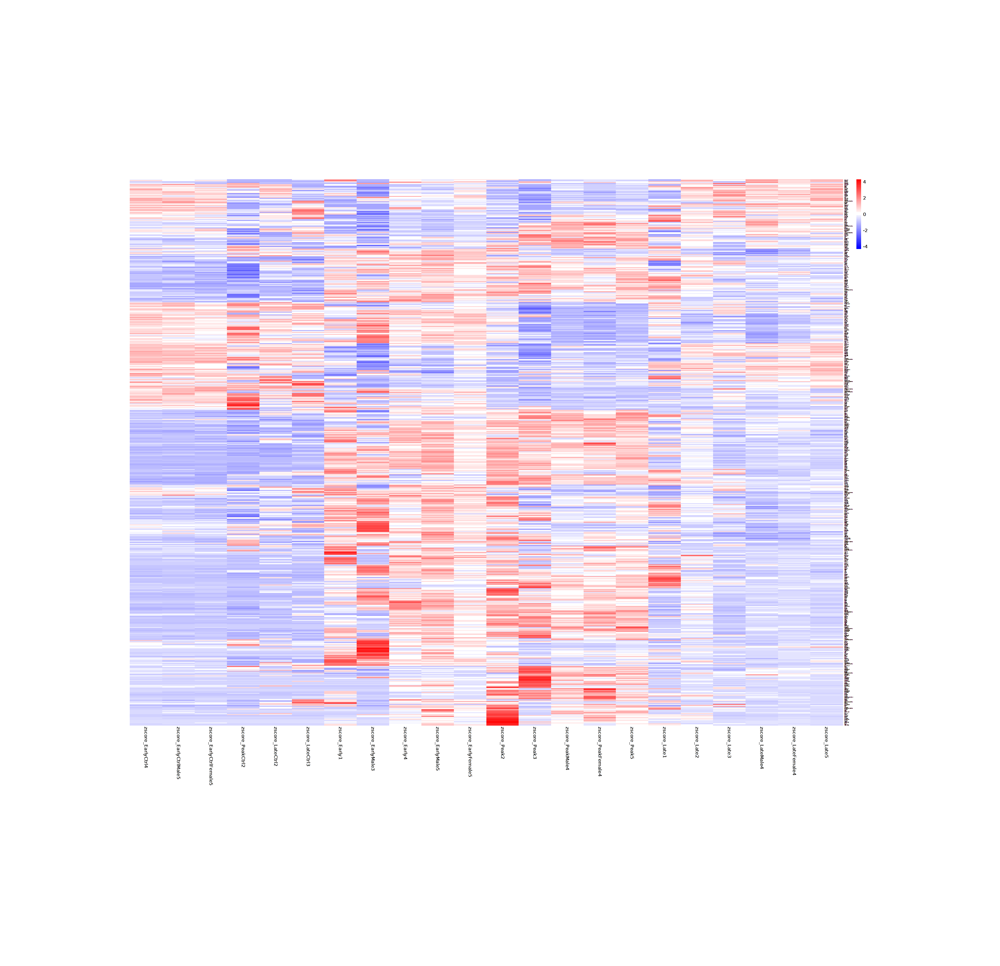

In [483]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [484]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_sep_pseudobulk_zscore.pdf"), width=30, height=plot_height)

png 
  2

In [485]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [486]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [487]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [488]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [489]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

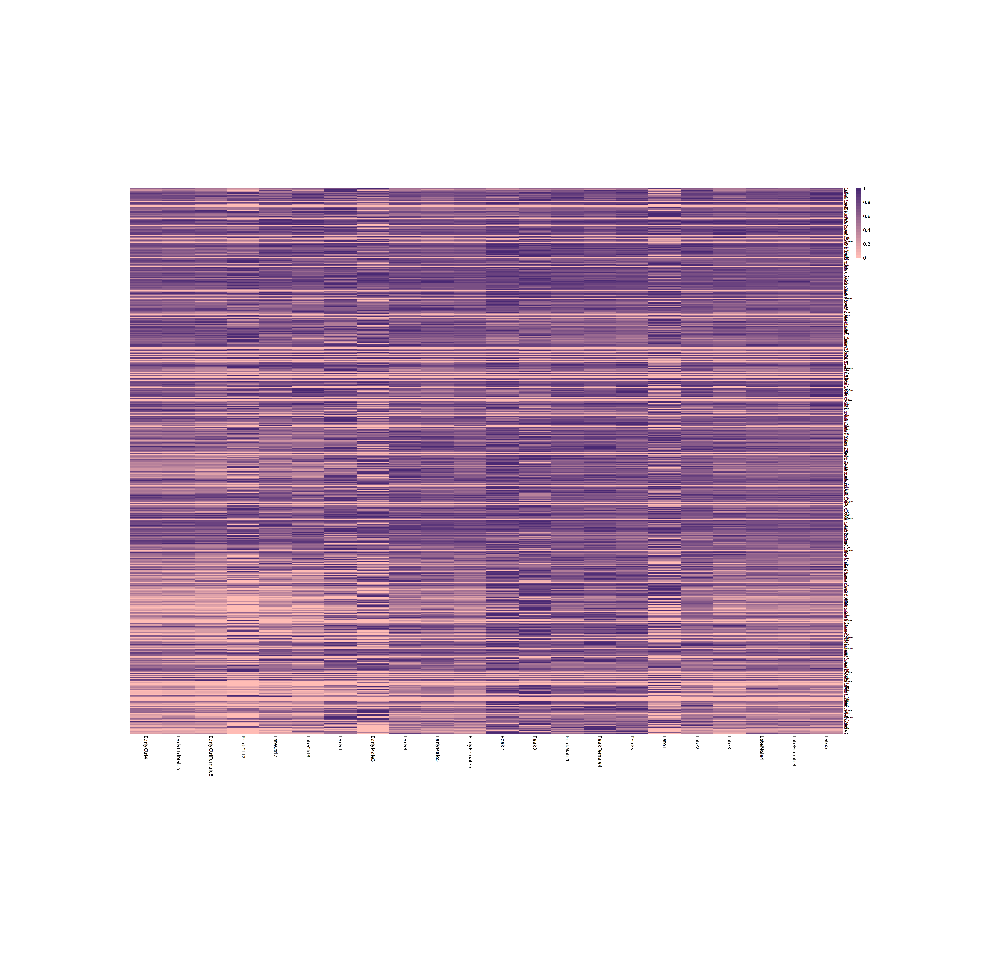

In [490]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [491]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk.pdf"), width=30, height=plot_height)

png 
  2

In [492]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Acc")))

In [493]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Log2Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [494]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [495]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [496]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

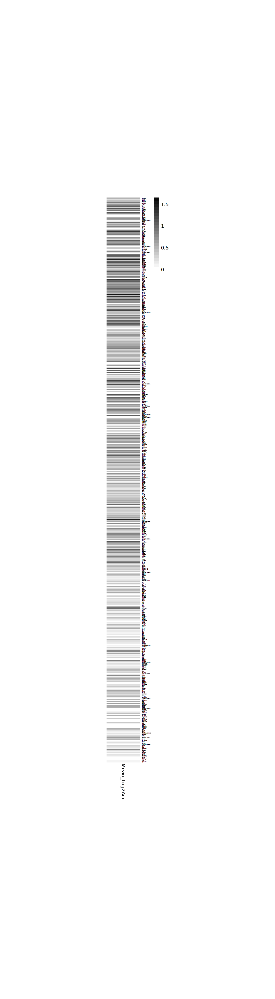

In [497]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [498]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [499]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [500]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [501]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [502]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

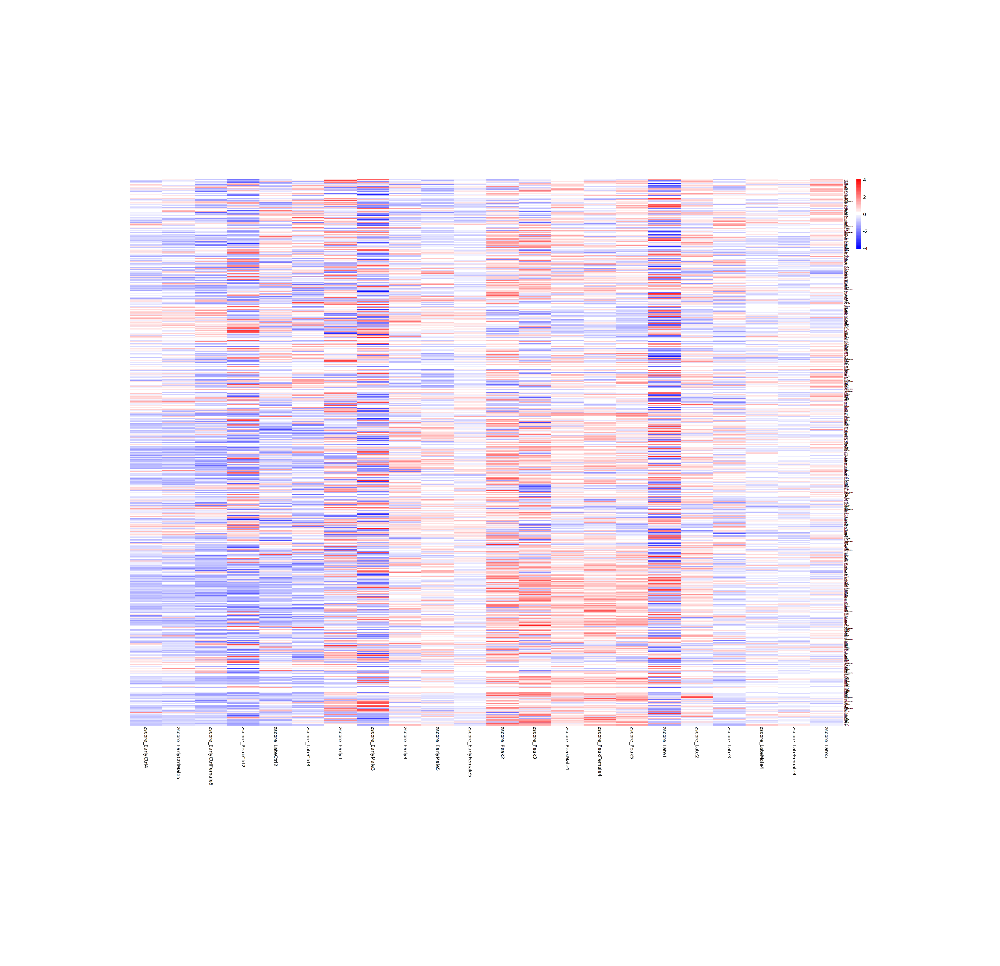

In [503]:
options(repr.plot.width=30, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [504]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_sep_pseudobulk_zscore.pdf"), width=30, height=plot_height)

png 
  2

In [505]:
gene_list <- HVG

In [506]:
sample_names <- levels(tmp$orig.ident_merge)

In [507]:
tmp_sample_markers <- as.data.frame(AggregateExpression(tmp, assays = "RNA", group.by = "orig.ident_merge", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["RNA"]]$data[gene_list,])

Centering and scaling data matrix

  |==========================================================================================| 100%
  |==========================================================================================| 100%


In [508]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, sample_names)))

In [509]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [510]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [511]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [512]:
tmp_sample_markers_GenePromAcc_sub <- as.data.frame(AggregateExpression(tmp, assays = "GenePromAcc", group.by = "orig.ident_merge", normalization.method = "LogNormalize", scale.factor = 10000, return.seurat = TRUE)[["GenePromAcc"]]$data[gene_list_GenePromAcc,])

  |==========================================================================================| 100%


In [513]:
matrix <- tmp_sample_markers/do.call(pmax, tmp_sample_markers)

In [514]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [515]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

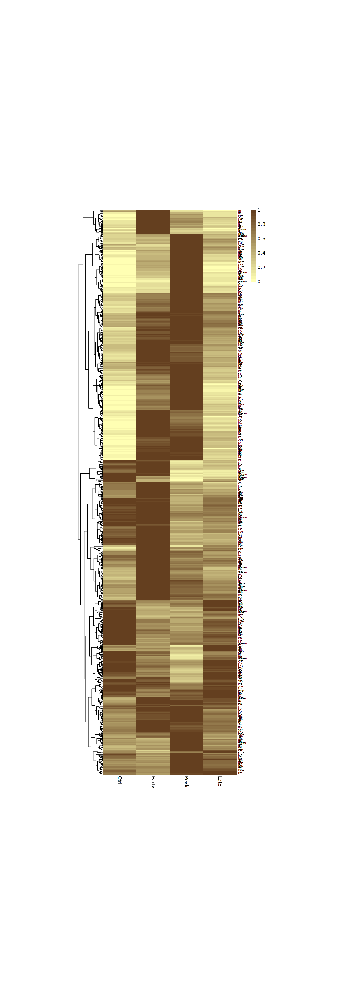

In [516]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=TRUE)
ph

In [517]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk.pdf"), width=10, height=plot_height)

png 
  2

In [518]:
gene_list <- gene_list[ph$tree_row$order]

In [519]:
tmp_sample_markers_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Exp")))

In [520]:
tmp_sample_markers_mean[rownames(tmp_sample_markers),"Mean_Log2Exp"] <- rowMeans(tmp_sample_markers)

In [521]:
matrix <- tmp_sample_markers_mean

In [522]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

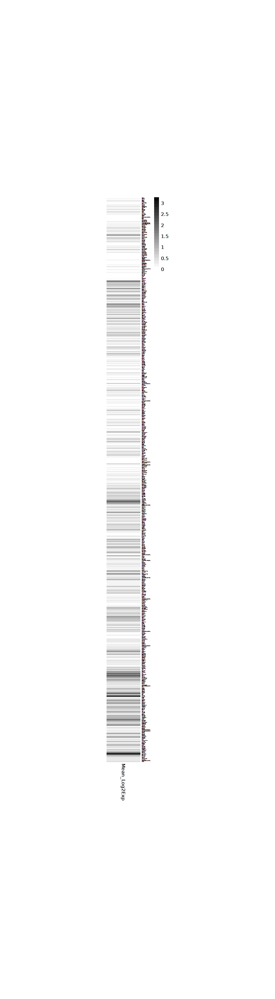

In [523]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [524]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk_mean.pdf"), width=8, height=plot_height)

png 
  2

In [525]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [526]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

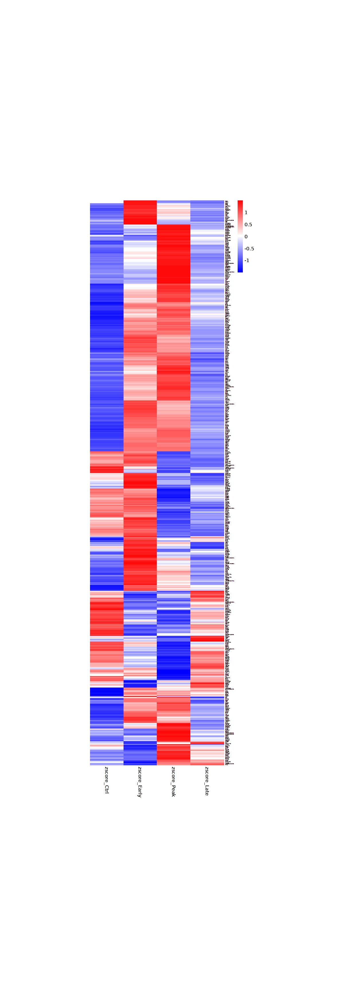

In [527]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [528]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_",cluster_choice,"_pseudobulk_zscore.pdf"), width=10, height=plot_height)

png 
  2

In [529]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [530]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [531]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [532]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [533]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

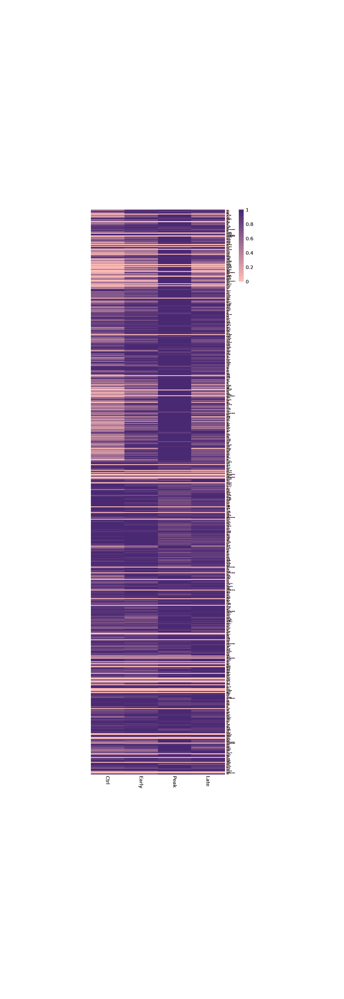

In [534]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [535]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk.pdf"), width=10, height=plot_height)

png 
  2

In [536]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Log2Acc")))

In [537]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Log2Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [538]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [539]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [540]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

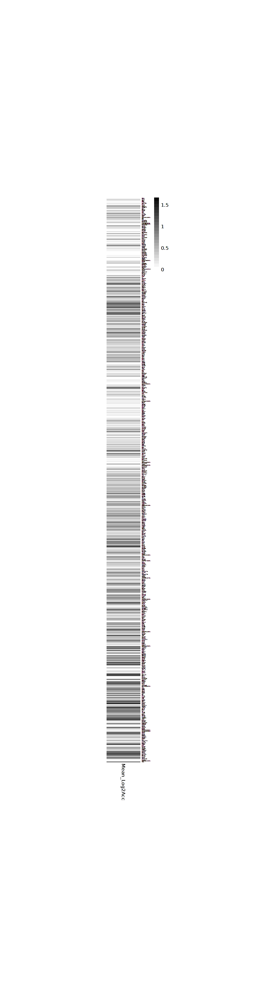

In [541]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [542]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk_mean.pdf"), width=7, height=plot_height)

png 
  2

In [543]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [544]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [545]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [546]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

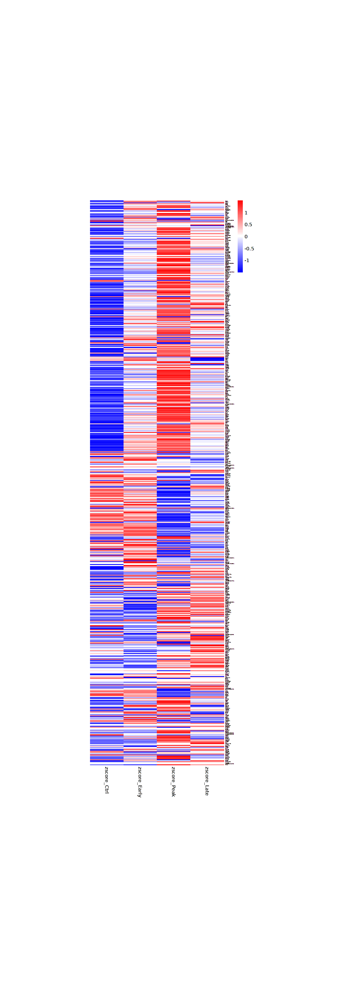

In [547]:
options(repr.plot.width=10, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [548]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "DGE_Acc_",cluster_choice,"_pseudobulk_zscore.pdf"), width=10, height=plot_height)

png 
  2

## X. Checkpoints

### X.1 Savings

In [550]:
saveRDS(HVGs.list, paste0(OS_path_outputs, "DGE_OL.rds"))